## Let's import everything 

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import scipy

In [189]:
mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_allsbjs_fixed.csv')
mesa_meta = pd.read_csv('/Users/anastasia/Dropbox/mesa-sleep-dataset-0.3.0.csv')

In [314]:
mesa_meta.columns

Index(['mesaid', 'examnumber', 'race1c', 'gender1', 'cucmcn1c', 'sleepage5c',
       'bedtmwkday5c', 'waketmwkday5c', 'wkdaysleepdur5c', 'wkdaysleepdur5t',
       ...
       'avgwhitetaltrd5', 'avgbluetaltrd5', 'avggreentaltrd5', 'avgredtaltrd5',
       'avgactactive5', 'avgactmainsleep5', 'avgactnaps5', 'avgact24hr5',
       'dstoverlap5', 'epochlength5'],
      dtype='object', length=760)

In [3]:
pd.options.display.max_rows = 15

In [4]:
mesa_meta['slpapnea5']

0       0.0
1       0.0
2       0.0
3       1.0
4       0.0
       ... 
2232    0.0
2233    1.0
2234    0.0
2235    0.0
2236    0.0
Name: slpapnea5, Length: 2237, dtype: float64

In [5]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,-2.126810,-3.238122,-3.083983,-3.779917,-4.873306,...,0.132739,0.187623,0.148162,0.900491,0.0,0.0,0.500000,0.0,NaN,NaN
175296,0.4,6811,79,1,1,-4.225398,-6.021411,-6.309019,-7.301486,-9.633378,...,0.412933,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735,0.254520
175297,0.3,6811,79,1,1,-2.096831,-3.002711,-3.164180,-3.704596,-4.731842,...,0.175018,0.184974,0.168836,0.948615,0.0,0.0,0.500000,0.0,NaN,NaN
175298,0.2,6811,79,1,1,-1.937574,-2.779680,-2.905882,-3.720251,-4.727719,...,0.163801,0.226120,0.182618,0.892886,0.0,0.0,1.000000,0.0,NaN,NaN


## Let's include metadata in the mydata


In [6]:
# read matlab file containing mesa demo
mat = scipy.io.loadmat('/Users/anastasia/Dropbox/missing data/MESA_demo.mat')
id_mat = scipy.io.loadmat('/Users/anastasia/Dropbox/missing data/MESA_ID.mat')

# take 'MESA_Gender' and 'MESA_Race' from the mat matlab file and add them to the mesa_meta dataframe
mesa_gender = mat['MESA_Gender']
mesa_race = mat['MESA_Race']
mesa_age = mat['MESA_Age']

id_mat = id_mat['MESA_ID']

# check which subjects in the mydata dataframe are in the id_mat list and create a mask for id_mat list for subjects in mydata
mask = np.isin(id_mat, mydata['Sbj_ID'])
cleaned_id_mat = id_mat[mask]
cleaned_gender= mesa_gender[mask]
cleaned_race = mesa_race[mask]


# apply teh mask to mesa_age and check whether it's the same as in mydata['Age']
mesa_age_masked = mesa_age[mask]

# check whether the age is the same as mydata unique age per subject
unique_age = mydata.groupby('Sbj_ID')['Age'].unique()

# check whether the age is the same as mydata unique age per subject
np.array_equal(mesa_age_masked, unique_age)

# to each unique subject, add the age, gender and race in mydata
mydata['Gender'] = mydata['Sbj_ID'].map(dict(zip(cleaned_id_mat, cleaned_gender)))
mydata['Race'] = mydata['Sbj_ID'].map(dict(zip(cleaned_id_mat, cleaned_race)))





In [7]:
mesa_meta.columns

Index(['mesaid', 'examnumber', 'race1c', 'gender1', 'cucmcn1c', 'sleepage5c',
       'bedtmwkday5c', 'waketmwkday5c', 'wkdaysleepdur5c', 'wkdaysleepdur5t',
       ...
       'avgwhitetaltrd5', 'avgbluetaltrd5', 'avggreentaltrd5', 'avgredtaltrd5',
       'avgactactive5', 'avgactmainsleep5', 'avgactnaps5', 'avgact24hr5',
       'dstoverlap5', 'epochlength5'],
      dtype='object', length=760)

In [8]:
# in mesa meta, only leave the subjects that are in unique subjects in mydata
unique_subjects = mydata['Sbj_ID'].unique()
mesa_meta_cleaned = mesa_meta[mesa_meta['mesaid'].isin(unique_subjects)].copy()

In [9]:
# Only leave the following columns in mesa_meta_cleaned: 'wkdaysleepdur5t', 
# 'wkendsleepdur5t', 'nap5', 'trbleslpng5', 'splngpills5', 'sleepy5', 'slpapnea5', 'legdscmfrt', 'rubbnglgs5'
# 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirsc5c', 
# 'epsipscl5c', 'hoostmeq5c'

mesa_meta_cleaned = mesa_meta_cleaned[['mesaid', 'wkdaysleepdur5t', 'wkendsleepdur5t', 'nap5', 'trbleslpng5', 'slpngpills5', 'sleepy5', 'legsdscmfrt5', 'rubbnglgs5', 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirs5c', 'epslpscl5c', 'hoostmeq5c']].copy()

In [10]:
# Delete mesa_meta_cleaned
#del mesa_meta_cleaned

In [11]:
mesa_meta_cleaned['slpapnea5']

1       0.0
2       0.0
3       1.0
4       0.0
12      0.0
       ... 
2223    0.0
2224    0.0
2230    0.0
2231    0.0
2235    0.0
Name: slpapnea5, Length: 668, dtype: float64

In [12]:
# show the number of missing values per column
mesa_meta_cleaned.isnull().sum()

# replace missing values with 0
mesa_meta_cleaned = mesa_meta_cleaned.fillna(0)

In [13]:
mesa_meta_cleaned.isnull().sum()

mesaid             0
wkdaysleepdur5t    0
wkendsleepdur5t    0
nap5               0
trbleslpng5        0
                  ..
insmnia5           0
rstlesslgs5        0
whiirs5c           0
epslpscl5c         0
hoostmeq5c         0
Length: 20, dtype: int64

In [14]:
mesa_meta_cleaned

,mesaid,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,sleepy5,legsdscmfrt5,rubbnglgs5,wrserest5,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
1,2,8.0,8.0,1.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,2.0,23.0
2,6,7.0,7.0,1.0,4.0,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,16.0,20.0
3,10,5.5,6.5,1.0,5.0,1.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,18.0,7.0,16.0
4,12,10.5,10.0,1.0,2.0,1.0,3.0,1.0,9.0,9.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,4.0,18.0
12,35,7.5,7.5,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2223,6784,7.0,6.5,1.0,1.0,5.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,5.0,20.0
2224,6786,6.0,6.0,0.0,3.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,4.0,16.0
2230,6796,7.0,5.5,1.0,1.0,1.0,1.0,1.0,1.0,0.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,16.0,23.0
2231,6802,9.5,9.5,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,13.0


In [15]:
# for each subject in mydata, find the corresponding mesa_meta_cleaned row and add the mesa_meta_cleaned columns to mydata for all datapoints for this subject without map
mydata['wkdaysleepdur5t'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['wkdaysleepdur5t'])))
mydata['wkendsleepdur5t'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['wkendsleepdur5t'])))
mydata['nap5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['nap5'])))
mydata['trbleslpng5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['trbleslpng5'])))
mydata['slpngpills5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['slpngpills5'])))
mydata['sleepy5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['sleepy5'])))
mydata['slpapnea5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['slpapnea5'])))
mydata['legsdscmfrt5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['legsdscmfrt5'])))
mydata['rubbnglgs5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['rubbnglgs5'])))
mydata['wrserest5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['wrserest5'])))
mydata['wrseltr5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['wrseltr5'])))
mydata['slpapnea5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['slpapnea5'])))
mydata['cpap5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['cpap5'])))
mydata['dntaldv5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['dntaldv5'])))
mydata['uvula5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['uvula5'])))
mydata['insmnia5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['insmnia5'])))
mydata['rstlesslgs5'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['rstlesslgs5'])))
mydata['whiirs5c'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['whiirs5c'])))
mydata['epslpscl5c'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['epslpscl5c'])))
mydata['hoostmeq5c'] = mydata['Sbj_ID'].map(dict(zip(mesa_meta_cleaned['mesaid'], mesa_meta_cleaned['hoostmeq5c'])))


In [16]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,wrserest5,wrseltr5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,2.0,23.0
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,2.0,23.0
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,2.0,23.0
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,2.0,23.0
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,2.0,23.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,-2.126810,-3.238122,-3.083983,-3.779917,-4.873306,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,9.0,20.0
175296,0.4,6811,79,1,1,-4.225398,-6.021411,-6.309019,-7.301486,-9.633378,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,9.0,20.0
175297,0.3,6811,79,1,1,-2.096831,-3.002711,-3.164180,-3.704596,-4.731842,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,9.0,20.0
175298,0.2,6811,79,1,1,-1.937574,-2.779680,-2.905882,-3.720251,-4.727719,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,9.0,20.0


In [17]:
mydata['slpapnea5']

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
175295    0.0
175296    0.0
175297    0.0
175298    0.0
175299    0.0
Name: slpapnea5, Length: 175300, dtype: float64

In [18]:
# let's relocate all the columns after Gender to go after Age

# get the index of Gender
a = mydata.columns.get_loc('Gender')

# get the index of Age
b = mydata.columns.get_loc('Age')

# get the list of columns
cols = list(mydata.columns)

# reidex the list of columns usign reindex()

cols = cols[:b+1] + cols[a:] + cols[b+1:a]

# reindex the dataframe using reindex()
mydata = mydata.reindex(columns = cols)

In [19]:
cols

['Label',
 'Sbj_ID',
 'Age',
 'Gender',
 'Race',
 'wkdaysleepdur5t',
 'wkendsleepdur5t',
 'nap5',
 'trbleslpng5',
 'slpngpills5',
 'sleepy5',
 'slpapnea5',
 'legsdscmfrt5',
 'rubbnglgs5',
 'wrserest5',
 'wrseltr5',
 'cpap5',
 'dntaldv5',
 'uvula5',
 'insmnia5',
 'rstlesslgs5',
 'whiirs5c',
 'epslpscl5c',
 'hoostmeq5c',
 'ifCleanOnset',
 'SleepStage',
 'delta_power',
 'theta_power',
 'alpha_power',
 'beta_power',
 'gamma_power',
 'Delta_to_theta_ratio',
 'Delta_to_alpha_ratio',
 'Delta_to_beta_ratio',
 'Delta_to_gamma_ratio',
 'Theta_to_alpha_ratio',
 'Theta_to_beta_ratio',
 'Theta_to_gamma_ratio',
 'Alpha_to_beta_ratio',
 'Alpha_to_gamma_ratio',
 'Beta_to_gamma_ratio',
 'Transition_power_ratio',
 'Peak_delta_band_frequency',
 'Peak_theta_band_frequency',
 'Peak_alpha_band_frequency',
 'Peak_beta_band_frequency',
 'Peak_gamma_band_frequency',
 'Temporal_coherence_delta_band',
 'Temporal_coherence_theta_band',
 'Temporal_coherence_alpha_band',
 'Temporal_coherence_beta_band',
 'Temporal_

In [20]:
# reindex the dataframe using reindex()
mydata = mydata.reindex(columns = cols)


In [21]:
mydata

,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN
1,29.9,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN
3,29.7,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN
4,29.6,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.132739,0.187623,0.148162,0.900491,0.0,0.0,0.500000,0.0,NaN,NaN
175296,0.4,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.412933,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735,0.254520
175297,0.3,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.175018,0.184974,0.168836,0.948615,0.0,0.0,0.500000,0.0,NaN,NaN
175298,0.2,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.163801,0.226120,0.182618,0.892886,0.0,0.0,1.000000,0.0,NaN,NaN


## Let's clean up the missing values in features ##

In [22]:
mydata.isnull().sum()

Label                            0
Sbj_ID                           0
Age                              0
Gender                           0
Race                             0
                             ...  
Biphasic_vertices_count,    105784
Sleep_spindles_count,       105784
K_complex_count,            105784
O-information               137816
S-information               137816
Length: 93, dtype: int64

In [23]:
mydata['count'] = mydata.isnull().sum(axis=1) // 61

In [24]:
mydata_disp = mydata[mydata['count'] > 0]
mydata_disp

,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information,count
5,29.5,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
8,29.2,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
9,29.1,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
10,29.0,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
12,28.8,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175280,2.0,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
175281,1.9,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
175282,1.8,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
175283,1.7,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1


In [25]:
#Get the number of unique subjects 

mydata['Sbj_ID'].nunique()

668

In [26]:
# in each subject wiht NaNs, calculate the maximum number of consecutive NaNs (sum of rows of 'count' column)
# NaNs are consecutive if the 'Label' values between two rows are different for no more than 0.11
sbjs = mydata_disp['Sbj_ID'].unique()
max_consec_nans = []
all_consec_nans_per_sbj = {} # list of lists of consecutive NaNs for each subject
for num_sbj, sbj in enumerate(sbjs):
    consec_nan_for_sbj = []
    max_consec = 1
    consec_nan = []
    for i in range(len(mydata_disp[mydata_disp['Sbj_ID'] == sbj]) - 1):
        diff = abs(mydata_disp[mydata_disp['Sbj_ID'] == sbj].iloc[i]['Label'] - mydata_disp[mydata_disp['Sbj_ID'] == sbj].iloc[i+1]['Label'])
        if diff < 0.11:
            consec_nan.append(i)
            max_consec = max([len(consec_nan), max_consec])
        # if the difference between two consecutive labels is more than 0.11, they are not consecutive NaNs. Reset the list of consecutive NaNs
        else:
            if len(consec_nan) > 0:
                consec_nan_for_sbj.append(len(consec_nan))
                consec_nan = []
    max_consec_nans.append(max_consec)
    all_consec_nans_per_sbj[sbj] = consec_nan_for_sbj
max_consec_nans


[65,
 44,
 31,
 73,
 13,
 173,
 69,
 33,
 19,
 39,
 44,
 52,
 59,
 204,
 6,
 18,
 11,
 54,
 85,
 53,
 102,
 24,
 130,
 41,
 40,
 24,
 44,
 72,
 43,
 129,
 31,
 39,
 100,
 75,
 20,
 69,
 29,
 61,
 159,
 31,
 48,
 3,
 18,
 21,
 86,
 35,
 16,
 58,
 119,
 6,
 36,
 20,
 84,
 27,
 34,
 67,
 46,
 44,
 39,
 71,
 34,
 40,
 79,
 35,
 45,
 80,
 45,
 67,
 4,
 80,
 6,
 29,
 4,
 1,
 25,
 49,
 58,
 113,
 1,
 59,
 74,
 6,
 15,
 60,
 52,
 70,
 170,
 19,
 13,
 16,
 70,
 234,
 110,
 24,
 16,
 29,
 54,
 78,
 44,
 89,
 69,
 66,
 120,
 9,
 136,
 43,
 84,
 95,
 25,
 7,
 83,
 21,
 9,
 60,
 5,
 224,
 54,
 24,
 64,
 24,
 15,
 10,
 66,
 116,
 47,
 33,
 45,
 151,
 90,
 72,
 44,
 24,
 11,
 60,
 65,
 37,
 171,
 44,
 11,
 11,
 1,
 1,
 9,
 28,
 79,
 50,
 76,
 13,
 17,
 27,
 12,
 76,
 21,
 17,
 20,
 19,
 59,
 49,
 64,
 40,
 17,
 14,
 15,
 139,
 124,
 21,
 91,
 49,
 64,
 76,
 146,
 127,
 61,
 37,
 69,
 42,
 53,
 55,
 83,
 11,
 36,
 54,
 41,
 98,
 20,
 155,
 19,
 112,
 20,
 24,
 29,
 13,
 14,
 19,
 19,
 54,
 4,
 30,
 58

In [27]:
# for each subject in the dictionary, sort the list of consecutive NaNs in descending order
for sbj in all_consec_nans_per_sbj:
    all_consec_nans_per_sbj[sbj].sort(reverse=True)

all_consec_nans_per_sbj

{2: [65,
  16,
  16,
  10,
  5,
  5,
  5,
  5,
  5,
  4,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 6: [44, 14, 13, 10, 10, 10, 8, 5, 4, 2, 2, 1, 1, 1, 1],
 10: [31,
  7,
  4,
  4,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 12: [73, 26, 21, 17, 10, 6, 5, 5, 4, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1],
 35: [7,
  6,
  6,
  5,
  5,
  5,
  5,
  5,
  5,
  4,
  4,
  4,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 54: [173, 8, 5, 4, 3, 3, 2, 1],
 56: [69, 41, 29, 25, 10, 9, 5, 1, 1, 1, 1],
 77: [33,
  25,
  24,
  10,
  9,
  9,
  7,
  7,
  4,
  4,
  4,
  3,
  3,
  3,
  3,
  2,
  2,
  2,
  2,
  1,
  1,
  1,
  1,
  1,
  1,
  1],
 99: [19, 14, 14, 9, 9, 6, 5, 5, 5, 4, 4, 4, 4, 2, 2, 1, 1, 1, 1, 1, 1],
 105: [39, 25, 19, 17, 16, 6, 6, 4, 4, 2, 1, 1, 1],
 107: [44, 19, 19, 8, 5, 4, 4, 4, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1],
 110: [

In [37]:
def show_features_per_chosen_subject(mydata, feature_name, sbj_id):
    print('Sbj ID: ', sbj_id)
    sns.pairplot(mydata[mydata['Sbj_ID'] == sbj_id], x_vars=['Label'], y_vars=[feature_name], height=5, aspect=1, kind='reg')
    plt.xlabel('Time to sleep onset (min)')
    plt.show()

In [38]:
#Write a function to display the subjects for a chosen feature

import random
#
def show_feature_for_ransom_subjects(mydata, feature_name, num_sbjs, random_seed = 42):
    counter = 0
    subjects = mydata['Sbj_ID'].unique()
    random.seed(random_seed)
    random.shuffle(subjects)
    for i in subjects:
        counter = counter + 1
        if counter < num_sbjs:
            show_features_per_chosen_subject(mydata, feature_name, i)
        else:
            continue

Sbj ID:  3399


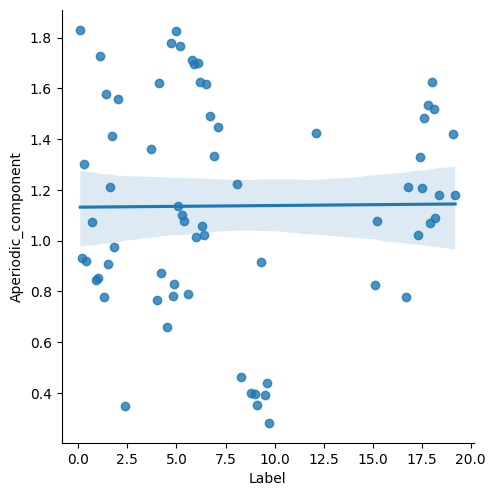

Sbj ID:  2887


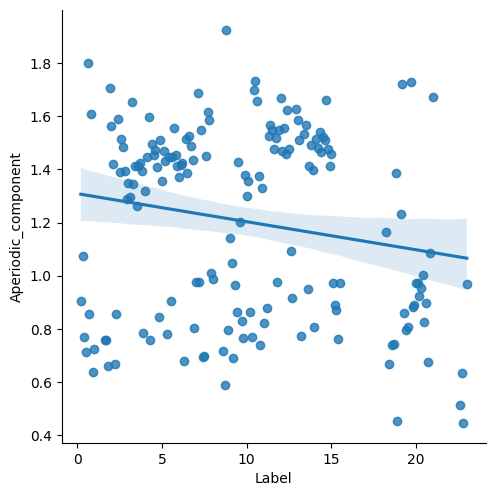

Sbj ID:  6351


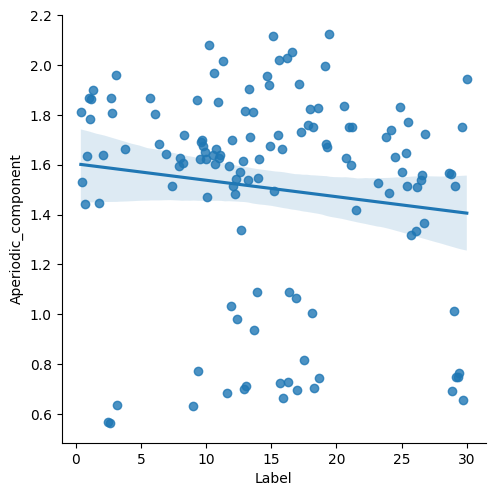

Sbj ID:  1256


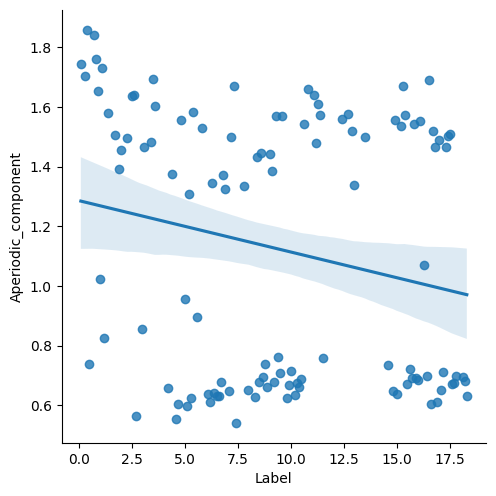

In [29]:
# Try it on the 'Aperiodic_component' feature
show_feature_for_ransom_subjects(mydata, 'Aperiodic_component', 5)

Sbj ID:  3399


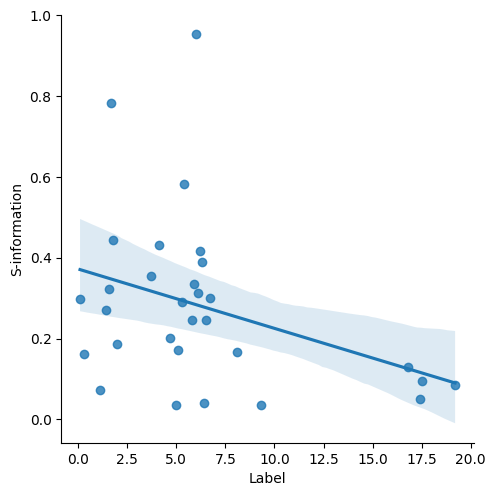

Sbj ID:  2887


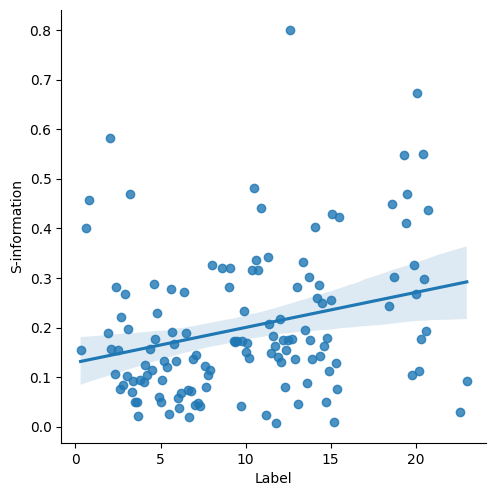

Sbj ID:  6351


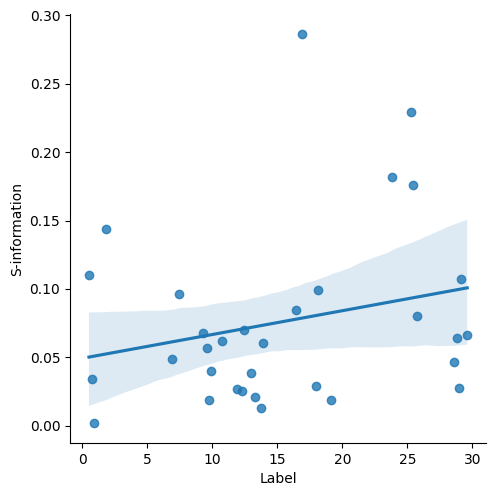

Sbj ID:  1256


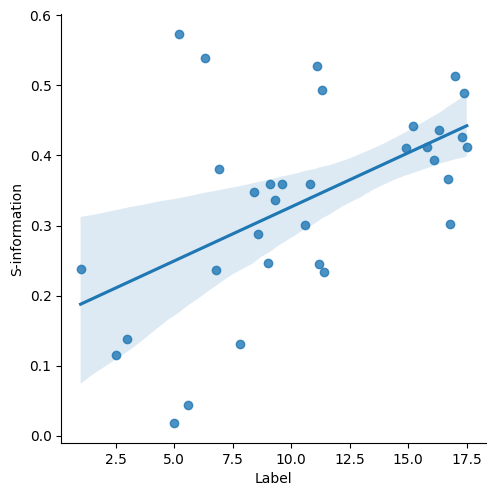

Sbj ID:  4888


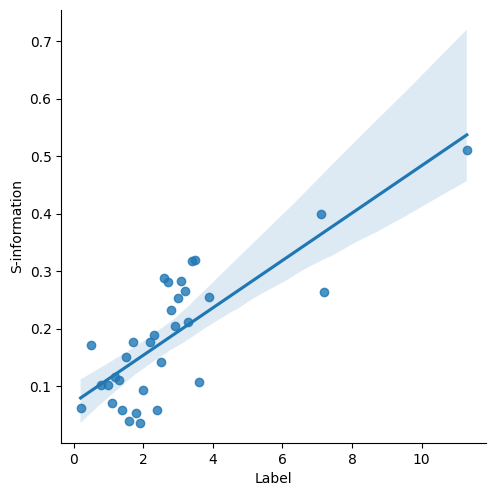

Sbj ID:  3021


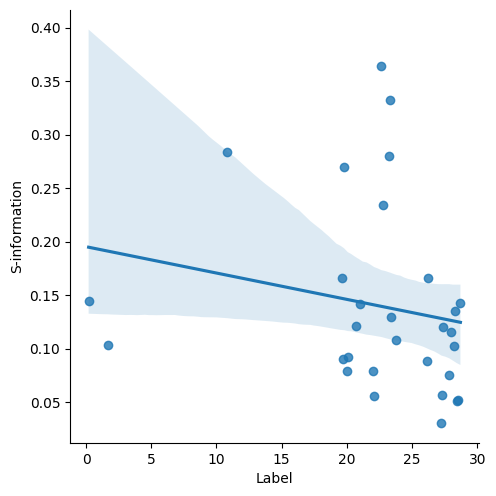

Sbj ID:  4715


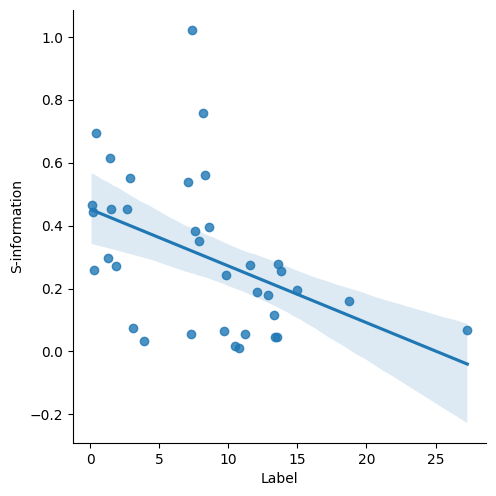

Sbj ID:  3267


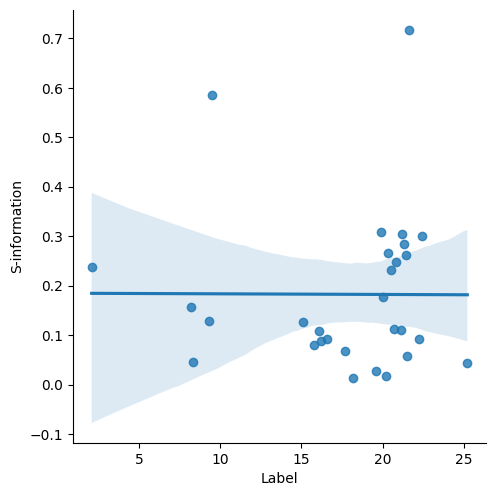

Sbj ID:  10


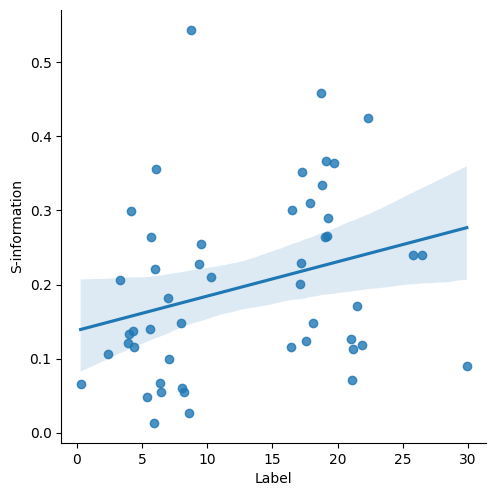

In [82]:
#Try it on the 'Aperiodic_component' feature
show_feature_for_ransom_subjects(mydata, 'S-information', 10)

## Deal with the missing values using indicator values and Last Observation Carried Forward (LOCF) aka forward fill ##

In [30]:
import numpy as np
import pandas as pd

# create a missing mask (column) fthat would indicate whether the values in any of the columns of mydata are missing
# 1 indicates missing, 0 indicates not missing

missing_mask = mydata.isnull().sum(axis=1).astype(bool).astype(int)

missing_mask.sum()


137816

In [31]:
mydata.fillna(method='ffill', inplace=True) # forward fill as an example

# Concatenating the missing value flags to the DataFrame
df = pd.concat([mydata, missing_mask.rename("column_missing")], axis=1)

In [32]:
#Show where the dataframe that still have missing values using isnull()

df[df.isnull().any(axis=1)]



,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information,count,column_missing
0,30.0,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.316998,0.660012,0.0,0.0,2.0,0.0,NaN,NaN,0,1


In [33]:
df.fillna(method='bfill', inplace=True) # forward fill as an example

In [34]:
df.drop(['count'], axis=1, inplace=True)

In [35]:
df.dropna(inplace=True)

In [36]:
df


,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information,column_missing
0,30.0,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,-0.000281,0.010573,1
1,29.9,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573,0
2,29.8,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,-0.000281,0.010573,1
3,29.7,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,-0.000281,0.010573,1
4,29.6,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,-0.000281,0.010573,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.187623,0.148162,0.900491,0.0,0.0,0.500000,0.0,-0.056656,0.633119,1
175296,0.4,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735,0.254520,0
175297,0.3,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.184974,0.168836,0.948615,0.0,0.0,0.500000,0.0,-0.000735,0.254520,1
175298,0.2,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.226120,0.182618,0.892886,0.0,0.0,1.000000,0.0,-0.000735,0.254520,1


Sbj ID:  3399


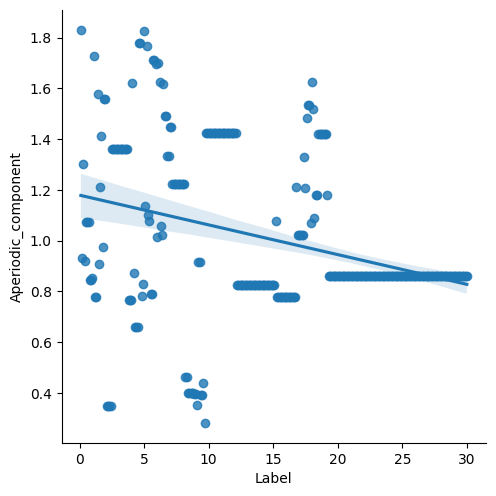

Sbj ID:  2887


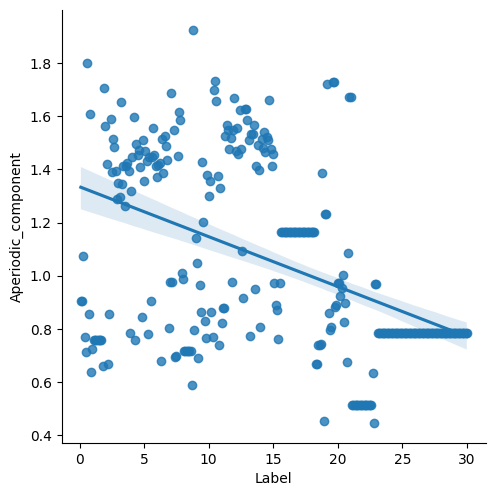

Sbj ID:  6351


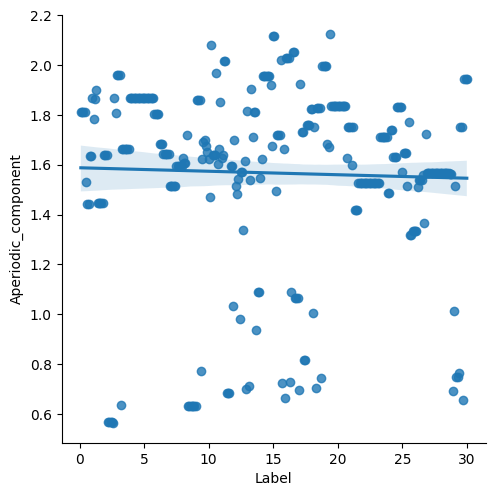

Sbj ID:  1256


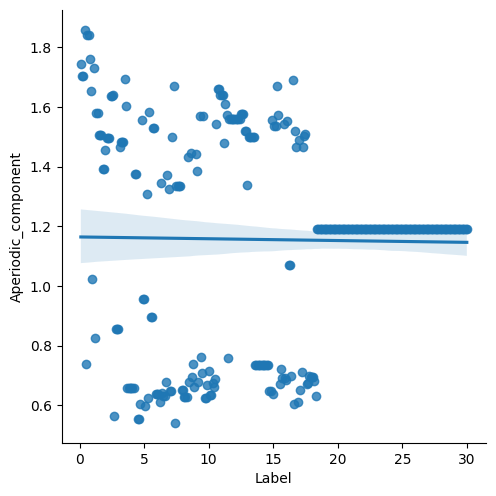

In [349]:
# show the same subjects as before but now with interpolated data
show_feature_for_ransom_subjects(df, 'Aperiodic_component', 5)

## Let's normalise the data using within-subject z-score normalisation ##

In [37]:
df.columns

Index(['Label', 'Sbj_ID', 'Age', 'Gender', 'Race', 'wkdaysleepdur5t',
       'wkendsleepdur5t', 'nap5', 'trbleslpng5', 'slpngpills5', 'sleepy5',
       'slpapnea5', 'legsdscmfrt5', 'rubbnglgs5', 'wrserest5', 'wrseltr5',
       'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirs5c',
       'epslpscl5c', 'hoostmeq5c', 'ifCleanOnset', 'SleepStage', 'delta_power',
       'theta_power', 'alpha_power', 'beta_power', 'gamma_power',
       'Delta_to_theta_ratio', 'Delta_to_alpha_ratio', 'Delta_to_beta_ratio',
       'Delta_to_gamma_ratio', 'Theta_to_alpha_ratio', 'Theta_to_beta_ratio',
       'Theta_to_gamma_ratio', 'Alpha_to_beta_ratio', 'Alpha_to_gamma_ratio',
       'Beta_to_gamma_ratio', 'Transition_power_ratio',
       'Peak_delta_band_frequency', 'Peak_theta_band_frequency',
       'Peak_alpha_band_frequency', 'Peak_beta_band_frequency',
       'Peak_gamma_band_frequency', 'Temporal_coherence_delta_band',
       'Temporal_coherence_theta_band', 'Temporal_coherence_alpha_ban

In [38]:
# Exclude 'Monophasic_vertices_count,', 'Biphasic_vertices_count,', 'Sleep_spindles_count,', 'K_complex_count,',

df.drop(['Monophasic_vertices_count,', 'Biphasic_vertices_count,', 'Sleep_spindles_count,', 'K_complex_count,'], axis=1, inplace=True)

In [39]:
# find indices of column 'delta_power' and 'S-informaition'
delta_power_index = df.columns.get_loc('delta_power')
S_information_index = df.columns.get_loc('S-information')

In [40]:
# for columns from 'delta_power' to 'S-informaition' perform normalization across rows within the chosen subject

for i in range(delta_power_index, S_information_index + 1):
    df.iloc[:, i] = df.groupby('Sbj_ID')[df.columns[i]].transform(lambda x: (x - x.mean()) / x.std())



In [41]:
df

,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information,column_missing
0,30.0,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-1.074324,-1.450586,-0.410884,-1.366999,-1.549203,-1.459413,-1.549419,0.014767,-1.509211,1
1,29.9,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-1.007762,-1.323944,0.566823,-0.276044,-0.382964,-0.243667,-1.589279,0.014767,-1.509211,0
2,29.8,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-1.007762,-1.450586,-0.655310,-1.631408,-1.610612,-1.362412,-1.383490,0.014767,-1.509211,1
3,29.7,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-1.007762,-0.374124,-0.521986,-1.412276,-1.545835,-1.498213,-1.492912,0.014767,-1.509211,1
4,29.6,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-1.007762,-1.450586,-1.044170,-1.725127,-1.726765,-1.711616,-1.513809,0.014767,-1.509211,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,0.564113,0.270271,-0.909719,-1.286395,-2.300610,-0.898821,-0.070505,-2.585691,2.528817,1
175296,0.4,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,-1.211455,0.955816,-0.191176,0.381112,-0.348319,0.458829,2.129815,0.415307,-0.054812,0
175297,0.3,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,-1.655347,0.332593,-0.713752,-1.034784,-2.320466,-0.796998,0.027784,0.415307,-0.054812,1
175298,0.2,6811,79,1,4,7.5,7.0,1.0,1.0,1.0,...,-1.655347,-1.724041,-0.779075,-1.101539,-2.012113,-0.729115,-0.086036,0.415307,-0.054812,1


In [42]:
# for columns from 'Age' to 'hoostmeq5c', perform normalization across all subjects

for i in range(2, delta_power_index):
    df.iloc[:, i] = df[df.columns[i]].transform(lambda x: (x - x.mean()) / x.std())


In [43]:
df

,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information,column_missing
0,30.0,2,1.469936,-0.938346,-1.027651,0.171929,-0.001924,0.867753,0.001287,0.707142,...,-1.074324,-1.450586,-0.410884,-1.366999,-1.549203,-1.459413,-1.549419,0.014767,-1.509211,1
1,29.9,2,1.469936,-0.938346,-1.027651,0.171929,-0.001924,0.867753,0.001287,0.707142,...,-1.007762,-1.323944,0.566823,-0.276044,-0.382964,-0.243667,-1.589279,0.014767,-1.509211,0
2,29.8,2,1.469936,-0.938346,-1.027651,0.171929,-0.001924,0.867753,0.001287,0.707142,...,-1.007762,-1.450586,-0.655310,-1.631408,-1.610612,-1.362412,-1.383490,0.014767,-1.509211,1
3,29.7,2,1.469936,-0.938346,-1.027651,0.171929,-0.001924,0.867753,0.001287,0.707142,...,-1.007762,-0.374124,-0.521986,-1.412276,-1.545835,-1.498213,-1.492912,0.014767,-1.509211,1
4,29.6,2,1.469936,-0.938346,-1.027651,0.171929,-0.001924,0.867753,0.001287,0.707142,...,-1.007762,-1.450586,-1.044170,-1.725127,-1.726765,-1.711616,-1.513809,0.014767,-1.509211,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,1.033719,1.065699,1.551284,-0.151611,-0.597321,0.867753,-0.738502,-0.321930,...,0.564113,0.270271,-0.909719,-1.286395,-2.300610,-0.898821,-0.070505,-2.585691,2.528817,1
175296,0.4,6811,1.033719,1.065699,1.551284,-0.151611,-0.597321,0.867753,-0.738502,-0.321930,...,-1.211455,0.955816,-0.191176,0.381112,-0.348319,0.458829,2.129815,0.415307,-0.054812,0
175297,0.3,6811,1.033719,1.065699,1.551284,-0.151611,-0.597321,0.867753,-0.738502,-0.321930,...,-1.655347,0.332593,-0.713752,-1.034784,-2.320466,-0.796998,0.027784,0.415307,-0.054812,1
175298,0.2,6811,1.033719,1.065699,1.551284,-0.151611,-0.597321,0.867753,-0.738502,-0.321930,...,-1.655347,-1.724041,-0.779075,-1.101539,-2.012113,-0.729115,-0.086036,0.415307,-0.054812,1


## Try LSTM with the metadata in the data ##


In [44]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.preprocessing import StandardScaler
import seaborn as sns

In [45]:
# Define the device:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

#Create a PyTorch dataset
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
class SleepDataset(Dataset):
    def __init__(self, sequences, labels):
        self.sequences = sequences
        self.labels = labels

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return torch.from_numpy(self.sequences[idx]).float(), torch.from_numpy(np.array(self.labels[idx])).float()

In [46]:
# Create a function for creating sliding windows of selected length 

def create_sliding_windows(data,  window_size_minutes=5, random_seed = 42):

    # Assert whether therea are any NaNs in the data
    assert data.isnull().sum().sum() == 0, "There are NaNs in the data"

    # Create a list of all unique subjects
    subjects = data['Sbj_ID'].unique()


    # Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set
    np.random.seed(random_seed)
    train_subjects = np.random.choice(subjects, size=int(0.6*len(subjects)), replace=False)
    val_subjects = np.random.choice(np.setdiff1d(subjects, train_subjects), size=int(0.2*len(subjects)), replace=False)
    test_subjects = np.setdiff1d(subjects, np.concatenate((train_subjects, val_subjects)))
   
    
    # Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
    data['Set'] = 'train'
    data.loc[data['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
    data.loc[data['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'

    # Sort your dataframe by Sbj_ID if not already sorted
    data = data.sort_values('Sbj_ID')

    # Convert the window size from minutes to 6-second epochs
    window_size = int((window_size_minutes*60)/6)

    # Create empty lists to store your sequences and labels
    train_sequences = []
    train_labels = []
    val_sequences = []
    val_labels = []
    test_sequences = []
    test_labels = []

    # Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
    for _, group in data.groupby('Sbj_ID'):
        
        # For each group, get the feature columns and convert them into numpy array
        group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

        train_test = group['Set'].iloc[0]
        
        if window_size == len(group_features):
            if train_test == 'train':
                print('got here')
                train_sequences.append(group_features)
                train_labels.append(group['Label'].iloc[0])
            elif train_test == 'val':
                val_sequences.append(group_features)
                val_labels.append(group['Label'].iloc[0])
            elif train_test == 'test':
                test_sequences.append(group_features)
                test_labels.append(group['Label'].iloc[0])
        elif window_size > len(group_features):
            continue


        # Iterate over the group array with a sliding window
        for i in range(len(group_features) - window_size):
            

            if train_test == 'train':

                # Append the window data to your sequences
                train_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                train_labels.append(group['Label'].iloc[i + window_size])

            
            elif train_test == 'val':
                # Append the window data to your sequences
                val_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                val_labels.append(group['Label'].iloc[i + window_size])

            elif train_test == 'test':
                # Append the window data to your sequences
                test_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                test_labels.append(group['Label'].iloc[i + window_size])
            
    # Convert the sequences and labels into numpy arrays
    train_sequences = np.array(train_sequences)
    train_labels = np.array(train_labels)
    val_sequences = np.array(val_sequences)
    val_labels = np.array(val_labels)
    test_sequences = np.array(test_sequences)
    test_labels = np.array(test_labels)

    return train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels




In [47]:
class SleepOnsetRNN(nn.Module):

    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])

        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)

        return out + self.l2 * l2_reg

In [54]:
def train(model, train_loader, val_loader, num_epochs, criterion, optimizer, device, ifoutputpredictions):

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):

        # Train the model
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
        
            loss = criterion(outputs, labels.view(-1, 1))

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Validate the model
        model.eval()
        with torch.no_grad():
            val_loss = 0
            predictions, actuals = [], []
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                val_loss += criterion(outputs, labels.view(-1, 1)).item()

                

                predictions.append(outputs.cpu().numpy())
                actuals.append(labels.cpu().numpy())
            
            
           
            print('-'*100)
            print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Loss: {val_loss/len(val_loader)}')

        # Save the model training and validation losses for plotting 
        train_losses.append(loss.item())
        val_losses.append(val_loss/len(val_loader))

        # Calculate the mape, mae, and accuracy for the validation set
        predictions = np.concatenate(predictions)
        actuals = np.concatenate(actuals)
        mape = np.mean(np.abs(predictions - actuals)/actuals) * 100
        mae = np.mean(np.abs(predictions - actuals))
        # calculate accuracy in percentage
        accuracy = 100 - np.mean(mape)
      
        print('-'*100 )
        print(f'Validation MAPE: {mape}, Validation MAE: {mae}, Validation Accuracy: {accuracy}')
        print('-'*100 + '\n')

        
        last_predictions = predictions
    if ifoutputpredictions: 
        return train_losses, val_losses, model, accuracy, mape, mae, predictions, actuals
    else:    
        return train_losses, val_losses, model, accuracy, mape, mae
# test the trained model

def test(model, test_loader, device, criterion):
    model.eval()
    predictions, actuals = [], []
    with torch.no_grad():
        test_loss = 0
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            test_loss += criterion(outputs, labels.view(-1, 1)).item()

            predictions.append(outputs.cpu().numpy())
            actuals.append(labels.cpu().numpy())

        print(f'Test Loss: {test_loss/len(test_loader)}')

    predictions = np.concatenate(predictions)
    # take away the extra second dimension 
    predictions = np.squeeze(predictions)
    actuals = np.concatenate(actuals)

    print(predictions.shape, actuals.shape)
    return predictions, actuals


In [56]:
def evaluate_performance_test(predictions, y_test):

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions, alpha=0.2)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_test - predictions
    plt.scatter(y_test, residuals, alpha=0.2)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

In [50]:
# show the columns of mydata
df.columns

Index(['Label', 'Sbj_ID', 'Age', 'Gender', 'Race', 'wkdaysleepdur5t',
       'wkendsleepdur5t', 'nap5', 'trbleslpng5', 'slpngpills5', 'sleepy5',
       'slpapnea5', 'legsdscmfrt5', 'rubbnglgs5', 'wrserest5', 'wrseltr5',
       'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirs5c',
       'epslpscl5c', 'hoostmeq5c', 'ifCleanOnset', 'SleepStage', 'delta_power',
       'theta_power', 'alpha_power', 'beta_power', 'gamma_power',
       'Delta_to_theta_ratio', 'Delta_to_alpha_ratio', 'Delta_to_beta_ratio',
       'Delta_to_gamma_ratio', 'Theta_to_alpha_ratio', 'Theta_to_beta_ratio',
       'Theta_to_gamma_ratio', 'Alpha_to_beta_ratio', 'Alpha_to_gamma_ratio',
       'Beta_to_gamma_ratio', 'Transition_power_ratio',
       'Peak_delta_band_frequency', 'Peak_theta_band_frequency',
       'Peak_alpha_band_frequency', 'Peak_beta_band_frequency',
       'Peak_gamma_band_frequency', 'Temporal_coherence_delta_band',
       'Temporal_coherence_theta_band', 'Temporal_coherence_alpha_ban

In [52]:
def training_loop_feature_RNN(mydata, input_size, num_epochs, hidden_size, num_layers, dropout, l2, lr, weight_decay, batch_size, device, random_seed = 42, window_size_minutes = 1, iftest = 0, ifoutputpredictions = 0):

    train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels = create_sliding_windows(mydata, window_size_minutes, random_seed)
    

    # Initialize the scaler
    #scaler = StandardScaler()

    # Scale each sequence individually, excluding the first feature
    #train_sequences_scaled = np.array([np.concatenate([seq[:, :21], scaler.fit_transform(seq[:, 21:])], axis=-1) for seq in train_sequences])
    #val_sequences_scaled = np.array([np.concatenate([seq[:, :21], scaler.transform(seq[:, 21:])], axis=-1) for seq in val_sequences])
    #test_sequences_scaled = np.array([np.concatenate([seq[:, :21], scaler.transform(seq[:, 21:])], axis=-1) for seq in test_sequences])


    # Convert the numpy arrays into PyTorch tensors
    #train_sequences_scaled = torch.from_numpy(train_sequences_scaled).float()
    #train_labels = torch.from_numpy(train_labels).float()
    #val_sequences_scaled = torch.from_numpy(val_sequences_scaled).float()
    #val_labels = torch.from_numpy(val_labels).float()
    #test_sequences_scaled = torch.from_numpy(test_sequences_scaled).float()
    #test_labels = torch.from_numpy(test_labels).float()

    # Create the training, validation and test sets
    train_dataset = SleepDataset(train_sequences, train_labels)
    val_dataset = SleepDataset(val_sequences, val_labels)
    test_dataset = SleepDataset(test_sequences, test_labels)

    # Create the training, validation and test loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    
    # show size of the test loader
    # Initialize the model
    model = SleepOnsetRNN(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, dropout=dropout, l2=l2).to(device)

    # Define the loss function
    criterion = nn.MSELoss()

    # Define the optimizer
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

    # Empty lists to store training and validation losses
    train_losses = []
    val_losses = []

    # Train the model
    if ifoutputpredictions:
        train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals  = train(model, train_loader, val_loader, num_epochs=num_epochs, criterion=criterion, optimizer=optimizer, device=device, ifoutputpredictions = ifoutputpredictions)
    else: 
        train_losses, val_losses, model, accuracy, mape, mae = train(model, train_loader, val_loader, num_epochs=num_epochs, criterion=criterion, optimizer=optimizer, device=device, ifoutputpredictions = ifoutputpredictions)
    # plot the training and validation losses

    plt.plot(train_losses, label='Training loss')
    plt.plot(val_losses, label='Validation loss')
    plt.legend()
    plt.show()

    # test the trained model
    if iftest == 1:

        predictions, actuals = test(model, test_loader, device, criterion)
        predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)    
    
        return train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model
    else:
        if ifoutputpredictions:
            return train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals
        else:
            return train_losses, val_losses, model, accuracy, mape, mae



### With scaling, 5 minute window ###

got here
----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 40.313480377197266, Validation Loss: 82.59161011558191
----------------------------------------------------------------------------------------------------
Validation MAPE: 274.5428800582886, Validation MAE: 9.323664665222168, Validation Accuracy: -174.54288005828857
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 16.240732192993164, Validation Loss: 82.3549811654782
----------------------------------------------------------------------------------------------------
Validation MAPE: 279.87539768218994, Validation MAE: 9.215703964233398, Validation Accuracy: -179.87539768218994
----------------------------------------------------------------------------------------------------

-------------

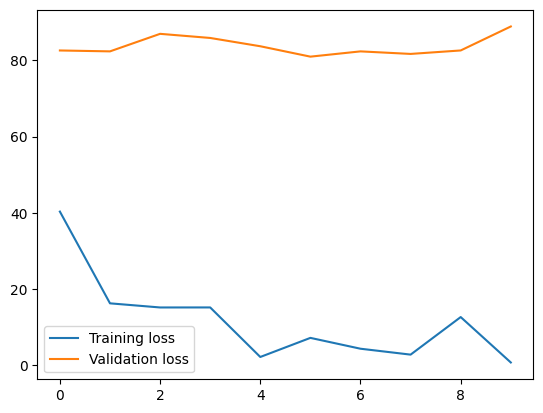

Test Loss: 75.25671410711423
(29065,) (29065,)
Mean Absolute Error: 6.65
Accuracy: -102.23 %.
Mean Squared Error: 75.29
Root Mean Squared Error: 8.68
R2: 0.08


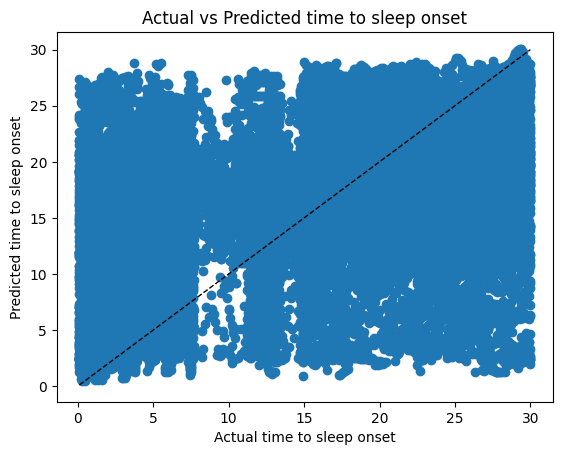

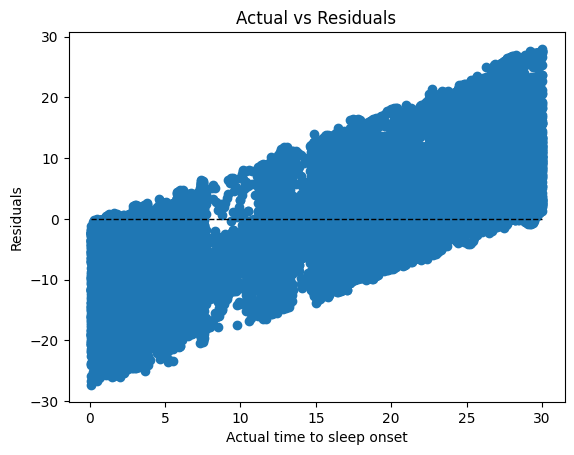

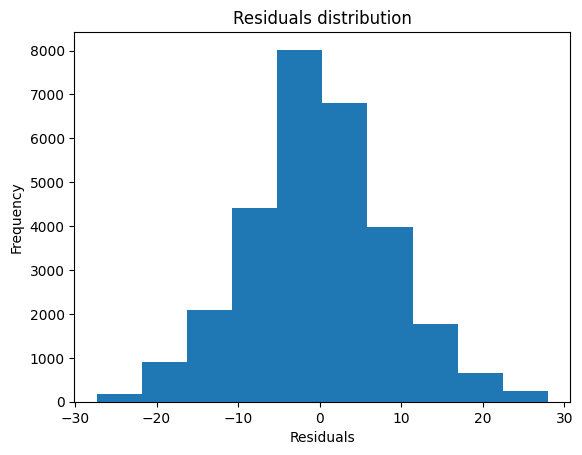

In [55]:
train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(df, input_size = 86, num_epochs=10, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=32, device=device, random_seed=42, window_size_minutes=5, iftest=1, ifoutputpredictions=0)

Mean Absolute Error: 6.65
Accuracy: -102.23 %.
Mean Squared Error: 75.29
Root Mean Squared Error: 8.68
R2: 0.08


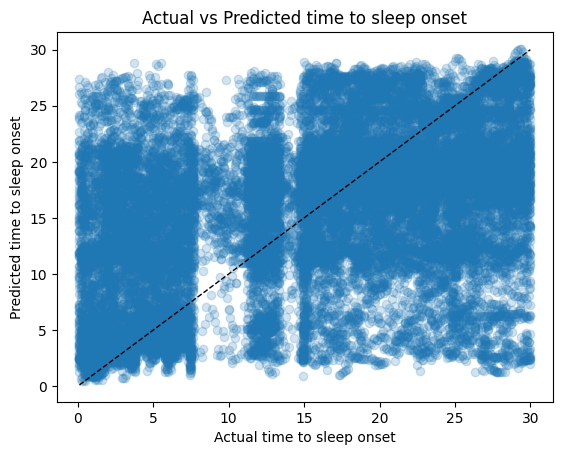

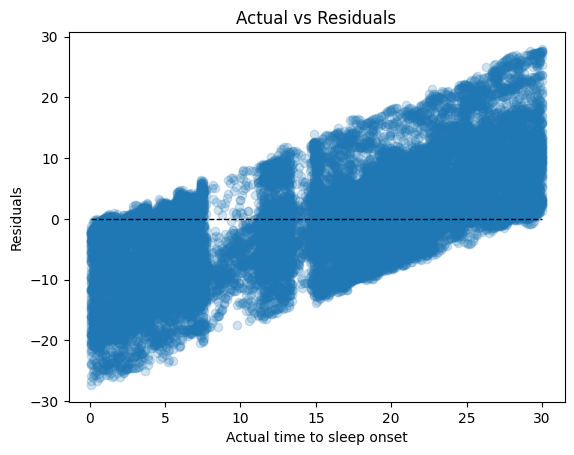

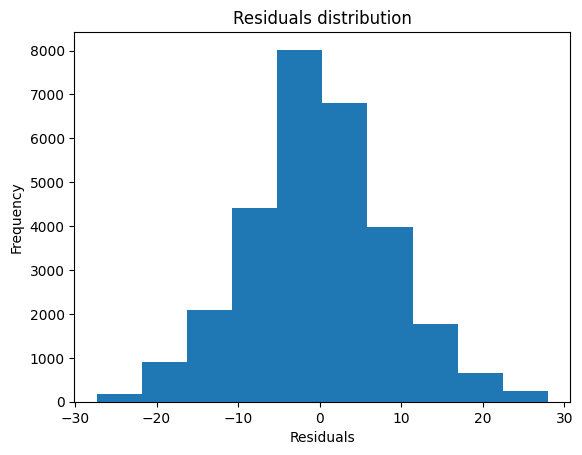

(array([19.930847, 20.584846, 22.051435, ..., 14.899531, 14.919948,
        14.940494], dtype=float32),
 array([11.830847, 15.184847, 20.351435, ...,  5.400468,  5.480052,
         4.759507], dtype=float32),
 array([ 146.05983 ,  281.20087 , 1197.1432  , ...,   26.60329 ,
          26.862999,   24.159933], dtype=float32),
 -102.22711181640625,
 array([-11.830847, -15.184847, -20.351435, ...,   5.400468,   5.480052,
          4.759507], dtype=float32))

In [57]:
evaluate_performance_test(predictions, actuals)

## Higher hidden size and l2 ##


got here
got here
got here
got here
----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 13.893976211547852, Validation Loss: 91.31873919142103
----------------------------------------------------------------------------------------------------
Validation MAPE: 322.3006248474121, Validation MAE: 9.7481107711792, Validation Accuracy: -222.3006248474121
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 7.1626715660095215, Validation Loss: 91.27098560539409
----------------------------------------------------------------------------------------------------
Validation MAPE: 301.5622854232788, Validation MAE: 9.715539932250977, Validation Accuracy: -201.5622854232788
--------------------------------------------------------------------------------------------

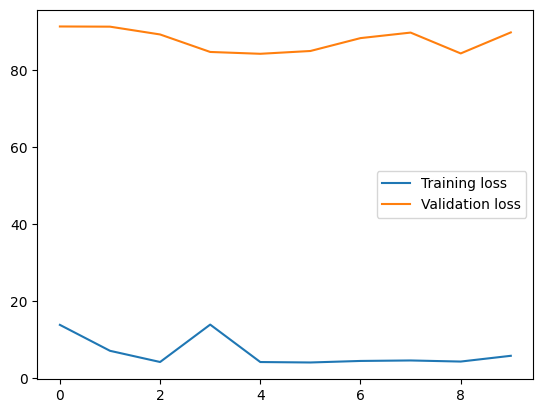

Test Loss: 83.74956171544316
(26450,) (26450,)
Mean Absolute Error: 6.73
Accuracy: -58.15 %.
Mean Squared Error: 83.75
Root Mean Squared Error: 9.15
R2: 0.03


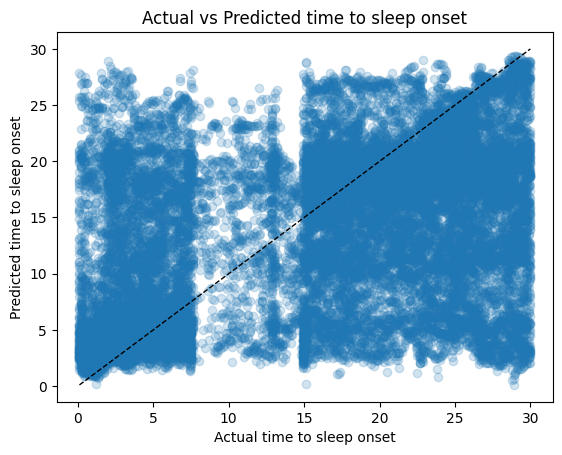

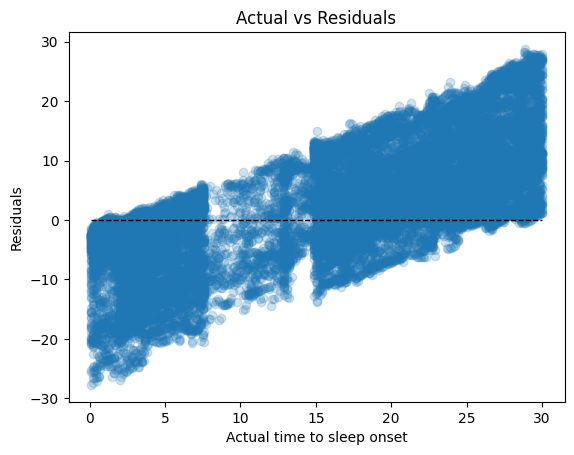

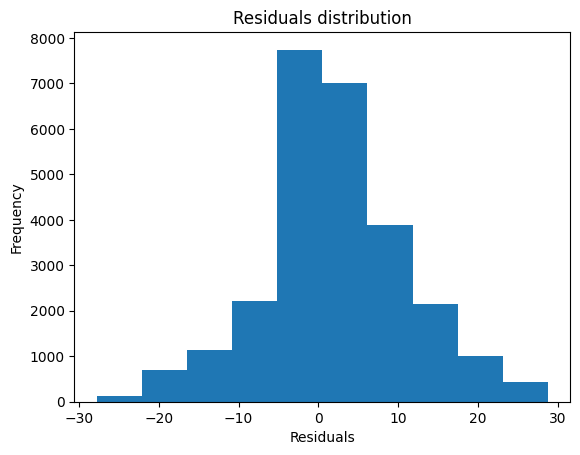

In [58]:
train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(df, input_size = 86, num_epochs=10, hidden_size=256, num_layers=2, dropout=0.0, l2=0.3, lr=0.001, weight_decay=0.0, batch_size=32, device=device, random_seed=42, window_size_minutes=7, iftest=1, ifoutputpredictions=0)

## Try to normalise with baseline awake 

In [4]:
baseline_awake_df = pd.read_csv('/Users/anastasia/Dropbox/baseline_awake_5min_6sec.csv')

In [5]:
baseline_awake_df

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,1,2,83,0,0,-4.592514,-5.907350,-5.814941,-6.378250,-8.924528,...,0.584829,0.624339,0.622510,1.391003,0,0,3.000000,0,-0.000429,0.019021
1,1,2,83,0,0,-4.575774,-6.221932,-5.947711,-6.300261,-8.338945,...,0.650421,0.724908,0.691422,1.241358,0,0,1.000000,0,-0.000152,0.035227
2,1,2,83,0,0,-4.752506,-6.199947,-5.901364,-6.229998,-8.075882,...,0.706557,0.723167,0.725879,1.160469,0,0,1.666667,0,0.000026,0.008286
3,1,2,83,0,0,-4.615919,-6.218005,-6.191263,-6.971220,-9.347704,...,0.514726,0.573459,0.597242,1.475455,0,0,2.000000,0,-0.000054,0.015150
4,1,2,83,0,0,-4.658412,-6.183120,-6.360970,-7.030083,-9.277773,...,0.527937,0.588290,0.608727,1.429733,0,0,2.666667,0,0.000043,0.027296
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15745,1,6802,65,0,0,-5.544856,-6.295327,-7.029641,-7.383314,-7.754638,...,0.834299,0.825830,0.852218,0.659382,0,0,0.000000,0,-0.000155,0.015006
15746,1,6802,65,0,0,-5.544726,-6.544366,-6.874241,-7.534556,-8.155460,...,0.798810,0.783343,0.771820,0.957457,0,0,0.000000,0,0.000063,0.040073
15747,1,6802,65,0,0,-5.286144,-6.380726,-7.033163,-7.137323,-7.465444,...,0.832082,0.878839,0.838436,0.624661,0,0,0.000000,0,-0.000807,0.024456
15748,1,6802,65,0,0,-4.854900,-5.904350,-6.286781,-7.151028,-8.261313,...,0.560594,0.631388,0.578865,1.105344,0,0,0.000000,0,-0.002979,0.070690


In [6]:
# Delete columns that are not needed
baseline_awake_df = baseline_awake_df.drop(['Label', 'Age', 'ifCleanOnset', 'SleepStage'], axis=1)

In [7]:
baseline_awake_df

,Sbj_ID,delta_power,theta_power,alpha_power,beta_power,gamma_power,Delta_to_theta_ratio,Delta_to_alpha_ratio,Delta_to_beta_ratio,Delta_to_gamma_ratio,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,2,-4.592514,-5.907350,-5.814941,-6.378250,-8.924528,1.314836,1.222427,1.785736,-0.092409,...,0.584829,0.624339,0.622510,1.391003,0,0,3.000000,0,-0.000429,0.019021
1,2,-4.575774,-6.221932,-5.947711,-6.300261,-8.338945,1.646158,1.371937,1.724487,-0.274221,...,0.650421,0.724908,0.691422,1.241358,0,0,1.000000,0,-0.000152,0.035227
2,2,-4.752506,-6.199947,-5.901364,-6.229998,-8.075882,1.447441,1.148858,1.477492,-0.298583,...,0.706557,0.723167,0.725879,1.160469,0,0,1.666667,0,0.000026,0.008286
3,2,-4.615919,-6.218005,-6.191263,-6.971220,-9.347704,1.602086,1.575344,2.355301,-0.026742,...,0.514726,0.573459,0.597242,1.475455,0,0,2.000000,0,-0.000054,0.015150
4,2,-4.658412,-6.183120,-6.360970,-7.030083,-9.277773,1.524708,1.702558,2.371671,0.177850,...,0.527937,0.588290,0.608727,1.429733,0,0,2.666667,0,0.000043,0.027296
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15745,6802,-5.544856,-6.295327,-7.029641,-7.383314,-7.754638,0.750471,1.484784,1.838457,0.734313,...,0.834299,0.825830,0.852218,0.659382,0,0,0.000000,0,-0.000155,0.015006
15746,6802,-5.544726,-6.544366,-6.874241,-7.534556,-8.155460,0.999640,1.329515,1.989830,0.329875,...,0.798810,0.783343,0.771820,0.957457,0,0,0.000000,0,0.000063,0.040073
15747,6802,-5.286144,-6.380726,-7.033163,-7.137323,-7.465444,1.094582,1.747019,1.851179,0.652437,...,0.832082,0.878839,0.838436,0.624661,0,0,0.000000,0,-0.000807,0.024456
15748,6802,-4.854900,-5.904350,-6.286781,-7.151028,-8.261313,1.049450,1.431881,2.296128,0.382431,...,0.560594,0.631388,0.578865,1.105344,0,0,0.000000,0,-0.002979,0.070690


In [8]:
# For each unique subject, show how many rows of data there are
baseline_awake_df['Sbj_ID'].value_counts()


Sbj_ID
2       30
4642    30
4592    30
4584    30
4555    30
        ..
2216    30
2212    30
2206    30
2204    30
6802    30
Name: count, Length: 525, dtype: int64

In [9]:
# Create a list of unique subject IDs
unique_subjects_baseline_awake = baseline_awake_df['Sbj_ID'].unique()
len(unique_subjects_baseline_awake)

525

In [10]:
# create two new dataframes which store the mean and std of each feature for each subject

# create an empty dataframe
baseline_awake_mean_df = pd.DataFrame()
baseline_awake_std_df = pd.DataFrame()

# for each subject, calculate the mean and std of each feature and store it in the dataframe
for i in range(len(unique_subjects_baseline_awake)):
    # calculate the mean and std of each feature for each subject with 'Label' column dropped
    mean = baseline_awake_df[baseline_awake_df['Sbj_ID'] == unique_subjects_baseline_awake[i]].drop(['Sbj_ID'], axis=1).mean()
    std = baseline_awake_df[baseline_awake_df['Sbj_ID'] == unique_subjects_baseline_awake[i]].drop(['Sbj_ID'], axis=1).std()
    # concatenate the mean to the mean dataframe
    baseline_awake_mean_df = pd.concat([baseline_awake_mean_df, mean], axis=1)
    # concatenate the std to the std dataframe
    baseline_awake_std_df = pd.concat([baseline_awake_std_df, std], axis=1)

# transpose the dataframes
baseline_awake_mean_df = baseline_awake_mean_df.transpose()
baseline_awake_std_df = baseline_awake_std_df.transpose()

# add a column with subject IDs to the start of the dataframes
baseline_awake_mean_df.insert(0, 'Sbj_ID', unique_subjects_baseline_awake)
baseline_awake_std_df.insert(0, 'Sbj_ID', unique_subjects_baseline_awake)
# reset the index in both dataframes

baseline_awake_mean_df.reset_index(drop=True, inplace=True)
baseline_awake_std_df.reset_index(drop=True, inplace=True)








In [11]:
baseline_awake_mean_df

,Sbj_ID,delta_power,theta_power,alpha_power,beta_power,gamma_power,Delta_to_theta_ratio,Delta_to_alpha_ratio,Delta_to_beta_ratio,Delta_to_gamma_ratio,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,2,-4.739478,-6.173985,-6.199871,-6.699743,-8.577232,1.434507,1.460393,1.960265,0.025886,...,0.616358,0.674408,0.664700,1.261197,0.0,0.0,1.688889,0.0,0.000080,0.036323
1,6,-5.213138,-5.686549,-5.073969,-6.695714,-9.329424,0.473411,-0.139169,1.482576,-0.612580,...,0.541266,0.543446,0.534455,1.510103,0.0,0.0,0.644444,0.0,-0.000026,0.032387
2,35,-4.699240,-5.657042,-5.179127,-6.960340,-9.873279,0.957803,0.479887,2.261100,-0.477916,...,0.477090,0.490374,0.479248,1.831622,0.0,0.0,0.644444,0.0,0.000470,0.051910
3,54,-4.391172,-6.401441,-7.067114,-7.324848,-8.887495,2.010270,2.675942,2.933677,0.665673,...,0.465177,0.505280,0.489279,1.385556,0.0,0.0,0.222222,0.0,0.003582,0.124533
4,56,-5.366687,-5.814332,-5.801073,-6.899921,-7.600090,0.447644,0.434385,1.533233,-0.013259,...,0.844210,0.827780,0.846399,0.903713,0.0,0.0,0.388889,0.0,0.000066,0.012290
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
520,6739,-4.716153,-6.102223,-6.573531,-7.443616,-8.653480,1.386069,1.857378,2.727463,0.471309,...,0.499579,0.538715,0.524577,1.402692,0.0,0.0,0.211111,0.0,-0.001444,0.111495
521,6756,-5.095024,-6.093755,-5.180947,-7.004159,-9.693351,0.998731,0.085923,1.909135,-0.912808,...,0.472513,0.481456,0.466385,1.625259,0.0,0.0,0.311111,0.0,0.004093,0.102652
522,6784,-5.370673,-5.795765,-5.486391,-6.055535,-8.394997,0.425092,0.115718,0.684862,-0.309374,...,0.729064,0.700923,0.707655,1.176341,0.0,0.0,0.555556,0.0,-0.000040,0.017179
523,6786,-4.706958,-5.983489,-6.173631,-6.604642,-8.782188,1.276531,1.466673,1.897684,0.190142,...,0.615998,0.614168,0.600458,1.544303,0.0,0.0,0.733333,0.0,0.001706,0.074788


In [12]:
baseline_awake_std_df

,Sbj_ID,delta_power,theta_power,alpha_power,beta_power,gamma_power,Delta_to_theta_ratio,Delta_to_alpha_ratio,Delta_to_beta_ratio,Delta_to_gamma_ratio,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,2,0.234745,0.318665,0.344746,0.339910,0.431211,0.251452,0.292309,0.343563,0.278602,...,0.076387,0.058686,0.058491,0.132889,0.0,0.0,0.747580,0.0,0.001016,0.035760
1,6,0.272626,0.237830,0.411834,0.257602,0.335426,0.304303,0.561831,0.390506,0.366016,...,0.043133,0.047106,0.043943,0.089942,0.0,0.0,0.437104,0.0,0.000746,0.036268
2,35,0.300121,0.212065,0.468498,0.237298,0.506246,0.322239,0.688632,0.392322,0.433097,...,0.065379,0.057093,0.063806,0.123750,0.0,0.0,0.437104,0.0,0.001594,0.077991
3,54,0.244273,0.337977,0.372984,0.400313,0.533808,0.442496,0.446717,0.500753,0.249647,...,0.103447,0.116069,0.112344,0.156170,0.0,0.0,0.281394,0.0,0.009732,0.165519
4,56,0.205873,0.255550,0.265635,0.233001,0.241093,0.260257,0.277808,0.268898,0.196184,...,0.055514,0.034552,0.038926,0.072736,0.0,0.0,0.339972,0.0,0.000354,0.016492
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
520,6739,0.353027,0.326569,0.290637,0.313637,0.321971,0.367373,0.475480,0.473480,0.249304,...,0.073385,0.069529,0.071924,0.091674,0.0,0.0,0.222892,0.0,0.009281,0.139368
521,6756,0.353814,0.312560,0.421476,0.232710,0.261971,0.295089,0.613967,0.440995,0.556251,...,0.062763,0.050322,0.057357,0.089820,0.0,0.0,0.314811,0.0,0.021672,0.154181
522,6784,0.264947,0.274566,0.259286,0.214916,0.286425,0.348654,0.370953,0.371293,0.275628,...,0.050672,0.039145,0.045492,0.112821,0.0,0.0,0.384900,0.0,0.000675,0.017178
523,6786,0.326784,0.283965,0.267124,0.280523,0.348761,0.251871,0.382723,0.439677,0.281775,...,0.079545,0.060639,0.068790,0.117213,0.0,0.0,0.549469,0.0,0.004281,0.089328


In [13]:
mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_allsbjs_fixed.csv')

In [14]:
# take the value of the first row of 'delta_power' column
delta_orig = mydata['delta_power'][0]
# take the value of the first row of 'delta_power' column in baseline_awake_mean_df
delta_baseline_mean = baseline_awake_mean_df['delta_power'][0]

# take the value of the first row of 'delta_power' column in baseline_awake_std_df
delta_baseline_std = baseline_awake_std_df['delta_power'][0]

print(delta_orig, delta_baseline_mean, delta_baseline_std)


-2.44523259852604 -4.7394777725344115 0.23474483811440172


In [15]:
# Get index of the first row with Sbj_ID == 6
mydata[mydata['Sbj_ID'] == 6].index[0]

300

In [16]:
delta_orig2 = mydata['delta_power'][mydata[mydata['Sbj_ID'] == 6].index[0]]
delta_baseline_mean2 = baseline_awake_mean_df['delta_power'][1]
delta_baseline_std2 = baseline_awake_std_df['delta_power'][1]
print(delta_orig2, delta_baseline_mean2, delta_baseline_std2)

-4.65701023783103 -5.213137815879 0.2726263397795175


In [17]:
# Calculatet the z-score for delta
delta_zscore = (delta_orig - delta_baseline_mean) / delta_baseline_std
print(delta_zscore)



9.773357286307112


In [18]:
delta_zscore2 = (delta_orig2 - delta_baseline_mean2) / delta_baseline_std2
print(delta_zscore2)

2.0398893903565205


In [21]:
# take the value of the first row of 'delta_power' column
delta_orig = mydata_normalised_raw['delta_power'][1]
# take the value of the first row of 'delta_power' column in baseline_awake_mean_df
delta_baseline_mean = baseline_awake_mean_df['delta_power'][0]

# take the value of the first row of 'delta_power' column in baseline_awake_std_df
delta_baseline_std = baseline_awake_std_df['delta_power'][0]

print(delta_orig, delta_baseline_mean, delta_baseline_std)

# Calculatet the z-score for delta
delta_zscore = (delta_orig - delta_baseline_mean) / delta_baseline_std
print(delta_zscore)

-3.32456443297852 -4.7394777725344115 0.23474483811440172
6.027452407138089


In [22]:

# take the value of the first row of 'delta_power' column in baseline_awake_mean_df
delta_baseline_mean = baseline_awake_mean_df['delta_power'][0]

# take the value of the first row of 'delta_power' column in baseline_awake_std_df
delta_baseline_std = baseline_awake_std_df['delta_power'][0]

In [20]:
# keep only the subjects (Sbj_ID) that are in the baseline awake dataframe
mydata_normalised_raw = mydata[mydata['Sbj_ID'].isin(unique_subjects_baseline_awake)].copy()


mydata_normalised_raw

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175195,0.5,6802,65,0,1,-4.131814,-5.439337,-5.870825,-6.687442,-8.292654,...,0.554334,0.615242,0.547855,1.181226,0.0,0.0,0.500000,0.0,0.050238,0.708219
175196,0.4,6802,65,0,1,-5.567545,-6.432704,-5.287658,-5.803146,-9.383270,...,0.724209,0.632373,0.627104,1.421292,0.0,0.0,1.000000,0.0,NaN,NaN
175197,0.3,6802,65,0,1,-4.994716,-5.945646,-6.331479,-6.774906,-8.245218,...,0.610569,0.580489,0.561637,1.274227,0.0,0.0,0.000000,0.0,0.080379,0.610032
175198,0.2,6802,65,0,1,-3.360931,-4.066394,-4.284614,-4.275214,-5.431883,...,0.422895,0.438173,0.427258,0.803529,0.0,0.0,0.666667,0.0,-0.000078,0.068591


In [27]:
mydata_normalised = mydata_normalised_raw.copy()

In [28]:
# find the index of delta_power
delta_index = mydata_normalised_raw.columns.get_loc('delta_power')

In [29]:
# Get the mean and std dataframes as a dictionary for quick access
mean_dict = baseline_awake_mean_df.set_index('Sbj_ID').T.to_dict('list')
std_dict = baseline_awake_std_df.set_index('Sbj_ID').T.to_dict('list')

# Get columns starting from delta_index
cols = mydata_normalised_raw.columns[delta_index:]

# Perform operations on the entire dataframe
for sbj in unique_subjects_baseline_awake:
    print('Normalising subject ' + str(sbj))

    # Get the mean and std for the current subject
    mean = np.array(mean_dict[sbj])
    std = np.array(std_dict[sbj])

    # Get a boolean mask of the rows that match the current subject
    mask = mydata_normalised_raw['Sbj_ID'] == sbj

    # Perform the normalization on the matching rows
    mydata_normalised.loc[mask, cols] = (mydata_normalised_raw.loc[mask, cols] - mean) / std

Normalising subject 2
Normalising subject 6
Normalising subject 35
Normalising subject 54
Normalising subject 56
Normalising subject 77
Normalising subject 99
Normalising subject 107
Normalising subject 110
Normalising subject 140
Normalising subject 159
Normalising subject 169
Normalising subject 188
Normalising subject 193
Normalising subject 219
Normalising subject 220
Normalising subject 271
Normalising subject 288
Normalising subject 306
Normalising subject 323
Normalising subject 329
Normalising subject 363
Normalising subject 381
Normalising subject 382
Normalising subject 384
Normalising subject 392
Normalising subject 399
Normalising subject 416
Normalising subject 419
Normalising subject 458
Normalising subject 459
Normalising subject 460
Normalising subject 485
Normalising subject 490
Normalising subject 491
Normalising subject 499
Normalising subject 519
Normalising subject 526
Normalising subject 527
Normalising subject 528
Normalising subject 534
Normalising subject 550
N

In [30]:
mydata_normalised_raw

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN,NaN
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN,NaN
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN,NaN
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175195,0.5,6802,65,0,1,-4.131814,-5.439337,-5.870825,-6.687442,-8.292654,...,0.554334,0.615242,0.547855,1.181226,0.0,0.0,0.500000,0.0,0.050238,0.708219
175196,0.4,6802,65,0,1,-5.567545,-6.432704,-5.287658,-5.803146,-9.383270,...,0.724209,0.632373,0.627104,1.421292,0.0,0.0,1.000000,0.0,NaN,NaN
175197,0.3,6802,65,0,1,-4.994716,-5.945646,-6.331479,-6.774906,-8.245218,...,0.610569,0.580489,0.561637,1.274227,0.0,0.0,0.000000,0.0,0.080379,0.610032
175198,0.2,6802,65,0,1,-3.360931,-4.066394,-4.284614,-4.275214,-5.431883,...,0.422895,0.438173,0.427258,0.803529,0.0,0.0,0.666667,0.0,-0.000078,0.068591


In [31]:
mydata_normalised

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,9.773357,9.470881,10.120615,10.995050,9.542772,...,-3.659772,-6.104153,-5.944510,-4.523980,NaN,NaN,0.416158,NaN,NaN,NaN
1,29.9,2,83,0,0,6.027452,7.268688,7.030947,7.717287,7.858091,...,-1.007306,-2.704251,-2.252918,-4.633829,NaN,NaN,-1.813258,NaN,-0.355577,-0.720069
2,29.8,2,83,0,0,10.735656,10.689219,11.274928,10.008857,9.572763,...,-4.302637,-6.283174,-5.649968,-4.066696,NaN,NaN,-1.590316,NaN,NaN,NaN
3,29.7,2,83,0,0,8.572864,9.136241,9.467319,9.967944,9.217665,...,-3.769855,-6.094331,-6.062327,-4.368251,NaN,NaN,-0.921492,NaN,NaN,NaN
4,29.6,2,83,0,0,9.624098,10.386426,10.555366,10.157560,9.582234,...,-4.530498,-6.621793,-6.710319,-4.425842,NaN,NaN,-0.921492,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175195,0.5,6802,65,0,1,3.257887,1.715737,1.830016,1.863541,-1.382500,...,-1.857886,-1.398932,-1.923649,1.664899,NaN,NaN,1.923674,NaN,19.137499,15.422550
175196,0.4,6802,65,0,1,-1.871937,-1.436787,3.378795,5.254153,-4.504674,...,-0.280502,-1.234635,-1.228475,2.910592,NaN,NaN,4.396969,NaN,NaN,NaN
175197,0.3,6802,65,0,1,0.174765,0.108926,0.606607,1.528183,-1.246703,...,-1.335715,-1.732222,-1.802749,2.147479,NaN,NaN,-0.549621,NaN,30.696003,13.183157
175198,0.2,6802,65,0,1,6.012228,6.072878,6.042688,11.112624,6.807202,...,-3.078382,-3.097063,-2.981521,-0.294949,NaN,NaN,2.748105,NaN,-0.157187,0.834261


In [32]:
mydata_normalised['delta_power'][mydata[mydata['Sbj_ID'] == 6].index[0]]

2.0398893903565205

Sbj ID:  3190


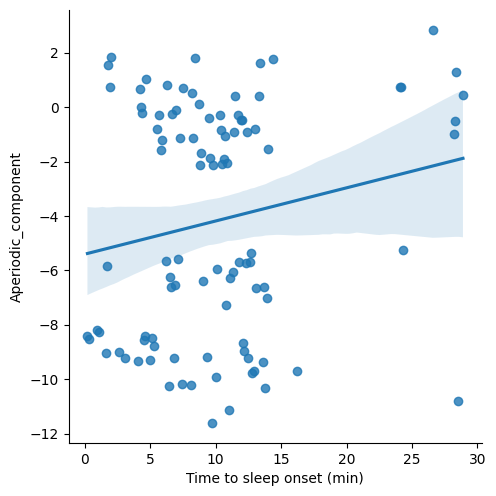

Sbj ID:  1260


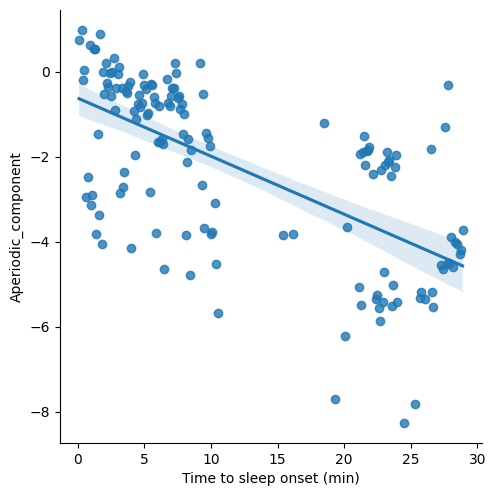

In [39]:
# plot 'Aperiodic_component' column 
show_feature_for_ransom_subjects(mydata_normalised, 'Aperiodic_component', 3, random_seed=42)

Sbj ID:  3190


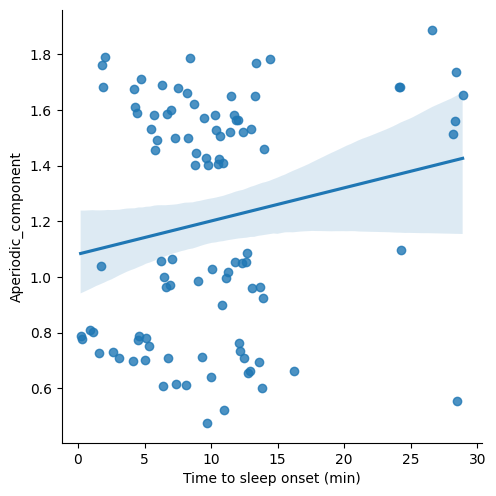

Sbj ID:  1260


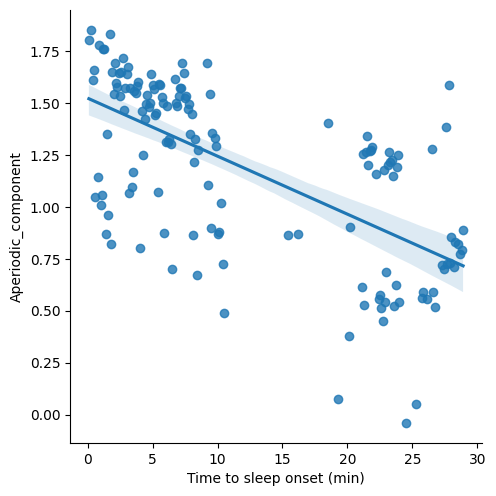

In [40]:
# plot 'Aperiodic_component' column 
show_feature_for_ransom_subjects(mydata_normalised_raw, 'Aperiodic_component', 3, random_seed=42)

## Try correlation analysis on the data normalised with baseline awake 


In [41]:
mydata_normalised.isnull().sum()

Label                            0
Sbj_ID                           0
Age                              0
ifCleanOnset                     0
SleepStage                       0
                             ...  
Biphasic_vertices_count,    141870
Sleep_spindles_count,        85188
K_complex_count,            141870
O-information               111345
S-information               111345
Length: 72, dtype: int64

In [42]:
# Drop uninformative features
mydata_normalised.drop(['Monophasic_vertices_count,', 'Biphasic_vertices_count,', 'Sleep_spindles_count,', 'K_complex_count,'], axis=1, inplace=True)

In [43]:
mydata_normalised_no_nans = mydata_normalised.copy()
mydata_normalised_no_nans.dropna(inplace=True)

In [44]:
mydata_normalised_no_nans

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information
1,29.9,2,83,0,0,6.027452,7.268688,7.030947,7.717287,7.858091,...,-9.109066,-2.650491,-2.745173,1.461743,-1.007306,-2.704251,-2.252918,-4.633829,-0.355577,-0.720069
6,29.4,2,83,0,0,-0.463816,1.116320,2.337119,2.387975,-0.088816,...,-1.271371,-1.858362,-0.056602,0.456676,0.254169,-1.176298,-0.524939,0.172174,-6.078268,3.088197
31,26.9,2,83,0,0,-0.789827,0.844049,0.449419,0.454308,0.854863,...,1.397335,-1.896082,-1.377304,1.219387,1.630346,0.636102,1.242312,-0.318166,-3.447281,3.202421
32,26.8,2,83,0,0,-3.105598,-0.098300,0.293687,-0.060337,-0.650752,...,-0.887059,0.857512,-1.966903,-1.189924,-0.073755,-1.412629,-1.172931,0.296393,12.636213,5.921232
56,24.4,2,83,0,0,-0.008665,2.194957,4.430354,2.230451,-0.084426,...,-0.692867,-1.179393,-0.198105,1.162362,0.589107,-0.525906,0.005236,0.422468,0.296550,4.688703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175189,1.1,6802,65,0,0,0.109786,0.751024,3.449226,6.084836,-1.317647,...,-1.750640,-2.927968,0.382798,-0.868611,-0.528761,-0.610789,-1.107576,1.388296,2.413179,8.923058
175195,0.5,6802,65,0,1,3.257887,1.715737,1.830016,1.863541,-1.382500,...,-2.143245,-1.459633,2.465931,-1.422734,-1.857886,-1.398932,-1.923649,1.664899,19.137499,15.422550
175197,0.3,6802,65,0,1,0.174765,0.108926,0.606607,1.528183,-1.246703,...,-1.764955,-2.340634,0.783401,-1.298785,-1.335715,-1.732222,-1.802749,2.147479,30.696003,13.183157
175198,0.2,6802,65,0,1,6.012228,6.072878,6.042688,11.112624,6.807202,...,-7.716606,-1.557522,-2.528247,-1.585568,-3.078382,-3.097063,-2.981521,-0.294949,-0.157187,0.834261


In [45]:
# Drop Sbj_ID column
mydata_normalised_no_nans.drop(['Sbj_ID'], axis=1, inplace=True)


In [46]:
# Find correlation between variables and time to sleep onset
mydata_normalised_no_nans.corr()['Label'].sort_values().dropna().drop_duplicates()


SleepStage                             -0.301628
CO_HistogramAMI_even_2_5               -0.244014
CO_Embed2_Dist_tau_d_expfit_meandiff   -0.234780
Alpha_to_gamma_ratio                   -0.200792
Aperiodic_component                    -0.190523
                                          ...   
SB_MotifThree_quantile_hh               0.136781
FC_LocalSimple_mean3_stderr             0.210339
Entropy_Rate_LZ                         0.234837
Entropy_Rate_CTW                        0.234853
Label                                   1.000000
Name: Label, Length: 67, dtype: float64

In [47]:
# Get the most correlated features (by absolute value) with 'Label' 
mydata_normalised_no_nans.corr()['Label'].sort_values().dropna().drop_duplicates().abs().sort_values(ascending=False)

Label                            1.000000e+00
SleepStage                       3.016283e-01
CO_HistogramAMI_even_2_5         2.440140e-01
Entropy_Rate_CTW                 2.348527e-01
Entropy_Rate_LZ                  2.348369e-01
                                     ...     
Temporal_coherence_theta_band    2.025059e-03
DN_OutlierInclude_p_001_mdrmd    1.809054e-03
Temporal_coherence_delta_band    1.808509e-03
Temporal_coherence_gamma_band    1.589564e-03
Phase_amplitude_coupling_TB      5.326901e-07
Name: Label, Length: 67, dtype: float64

In [48]:
# list 
list_most_correlated_features = list(mydata_normalised_no_nans.corr()['Label'].sort_values().dropna().drop_duplicates().abs().sort_values(ascending=False).index)

# remove 'Label' from the list
list_most_correlated_features.remove('Label')

# Get the correlation values for the most correlated features for each feature in the list and store it in a dictionary
correlation_values = {}
for feature in list_most_correlated_features:
    print(feature)
    correlation_values[feature] = mydata_normalised_no_nans.corr()[feature].sort_values().dropna().drop_duplicates().abs().sort_values(ascending=False)['Label']

SleepStage
CO_HistogramAMI_even_2_5
Entropy_Rate_CTW
Entropy_Rate_LZ
CO_Embed2_Dist_tau_d_expfit_meandiff
FC_LocalSimple_mean3_stderr
Alpha_to_gamma_ratio
Aperiodic_component
Theta_to_gamma_ratio
SB_BinaryStats_diff_longstretch0
Beta_to_gamma_ratio
Theta_to_alpha_ratio
Theta_to_beta_ratio
SB_BinaryStats_mean_longstretch1
Alpha_to_beta_ratio
SB_MotifThree_quantile_hh
SP_Summaries_welch_rect_centroid
IN_AutoMutualInfoStats_40_gaussian_fmmi
CO_f1ecac
CO_FirstMin_ac
gamma_power
Delta_to_beta_ratio
Phase_amplitude_coupling_BG
PD_PeriodicityWang_th0_01
MD_hrv_classic_pnn40
SB_TransitionMatrix_3ac_sumdiagcov
SP_Summaries_welch_rect_area_5_1
Age
theta_power
S-information
CO_trev_1_num
alpha_power
Peak_gamma_band_frequency
SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1
beta_power
Delta_to_theta_ratio
Peak_beta_band_frequency
delta_power
Peak_delta_band_frequency
Peak_alpha_band_frequency
Temporal_coherence_beta_band
FC_LocalSimple_mean1_tauresrat
Transition_power_ratio
Temporal_coherence_alpha_ban

In [66]:
correlation_values

{'SleepStage': 0.30162831618781033,
 'CO_HistogramAMI_even_2_5': 0.2440140019262073,
 'Entropy_Rate_CTW': 0.2348527020713865,
 'Entropy_Rate_LZ': 0.2348368992652432,
 'CO_Embed2_Dist_tau_d_expfit_meandiff': 0.23477955922355065,
 'FC_LocalSimple_mean3_stderr': 0.2103385949505606,
 'Alpha_to_gamma_ratio': 0.20079215878540427,
 'Aperiodic_component': 0.19052281345828007,
 'Theta_to_gamma_ratio': 0.17926727597766307,
 'SB_BinaryStats_diff_longstretch0': 0.17530878425751453,
 'Beta_to_gamma_ratio': 0.16850539683677923,
 'Theta_to_alpha_ratio': 0.16756000425888684,
 'Theta_to_beta_ratio': 0.16570713507140758,
 'SB_BinaryStats_mean_longstretch1': 0.15623403048499918,
 'Alpha_to_beta_ratio': 0.1468811464954375,
 'SB_MotifThree_quantile_hh': 0.136780730655346,
 'SP_Summaries_welch_rect_centroid': 0.12811256527874912,
 'IN_AutoMutualInfoStats_40_gaussian_fmmi': 0.12701999082500745,
 'CO_f1ecac': 0.12509747941244687,
 'CO_FirstMin_ac': 0.10725665288112422,
 'gamma_power': 0.10232094848190393,
 'D

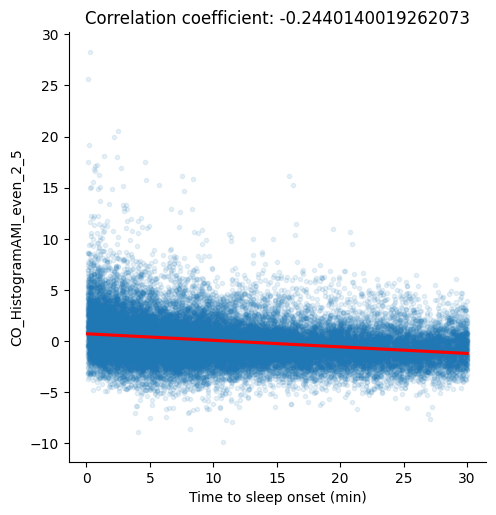

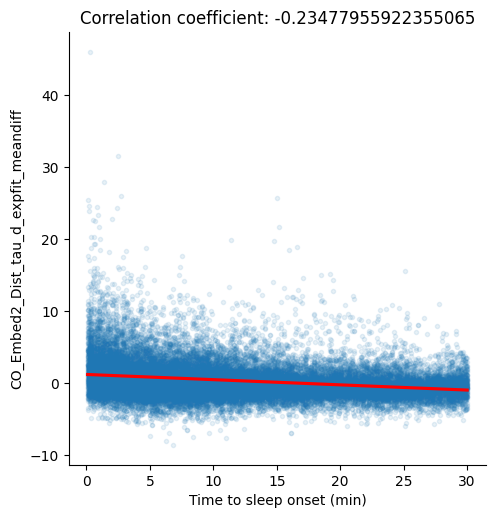

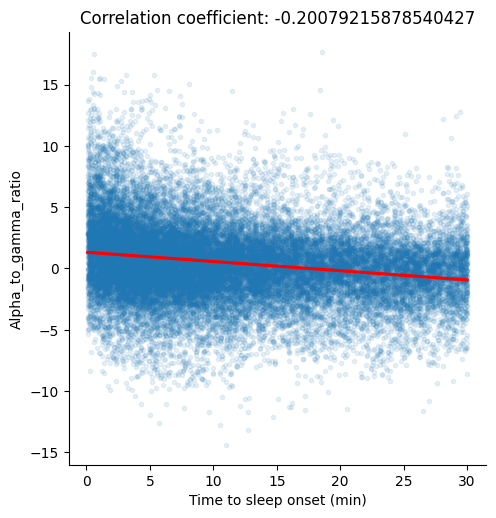

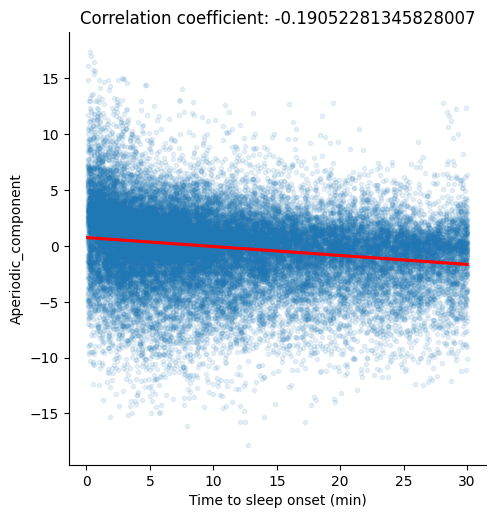

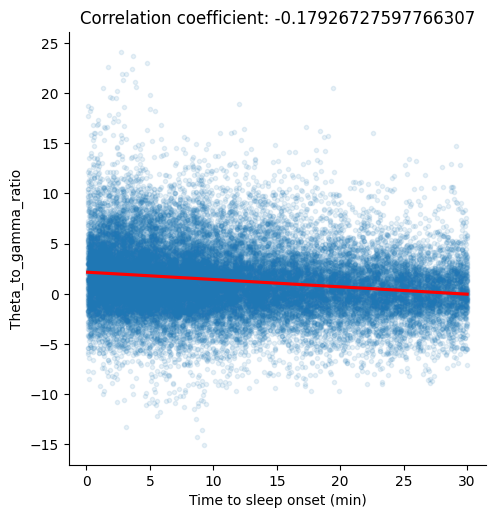

...

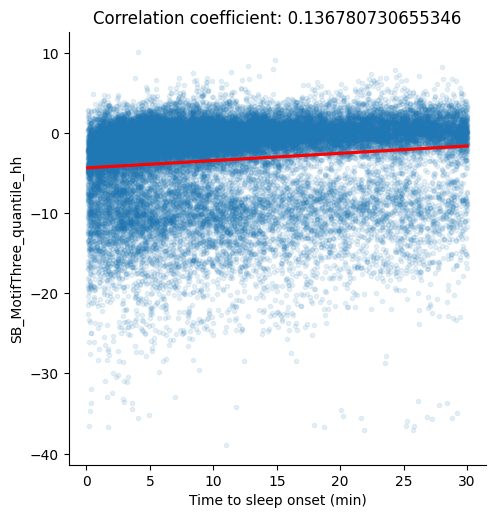

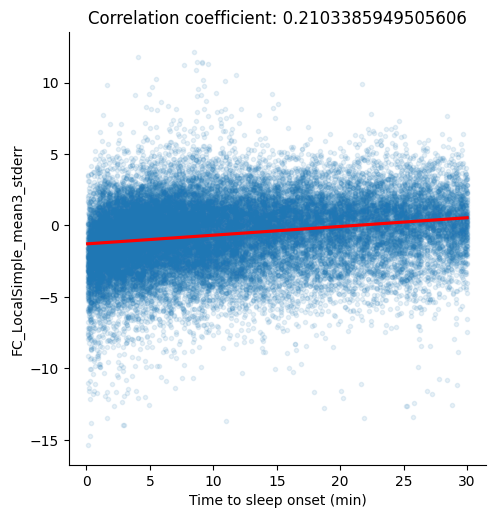

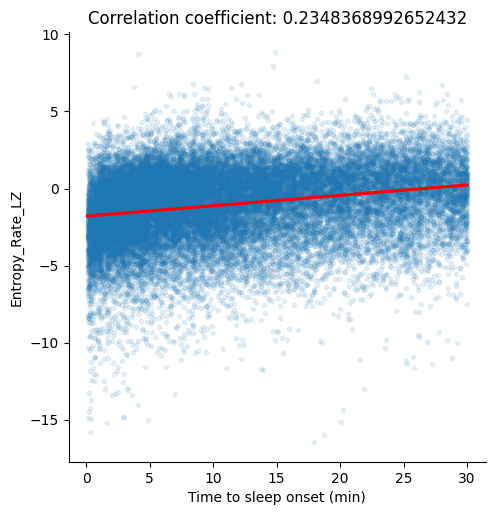

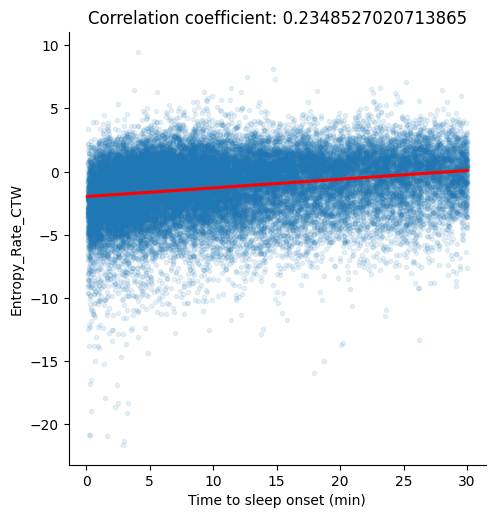

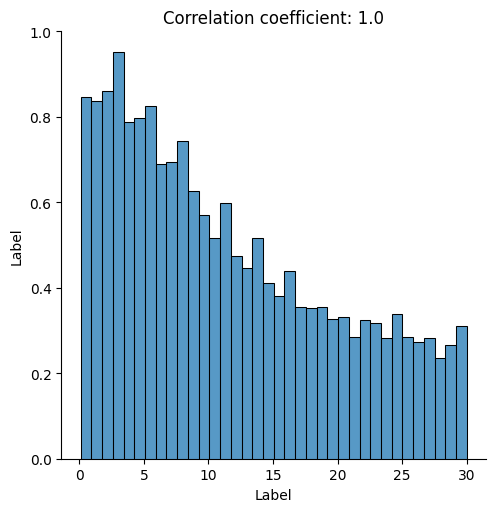

In [50]:
# Make plots the correlation between the Label and most correlated variables for each variable

import matplotlib.pyplot as plt
import seaborn as sns

for i in mydata_normalised_no_nans.corr()['Label'].sort_values().dropna().drop_duplicates().index[0:]:
    if i == 'SleepStage':
        continue
    # make the scatter plot semi-transparent and line red

    sns.pairplot(mydata_normalised_no_nans, x_vars=['Label'], y_vars=[i], height=5, aspect=1, kind='reg', markers='.', plot_kws={'scatter_kws': {'alpha': 0.1}, 'line_kws':{'color':'red'}})
    plt.xlabel('Time to sleep onset (min)')

    # put the correlation coefficient in the title
    plt.title('Correlation coefficient: ' + str(mydata_normalised_no_nans.corr()['Label'][i]))
    plt.show()

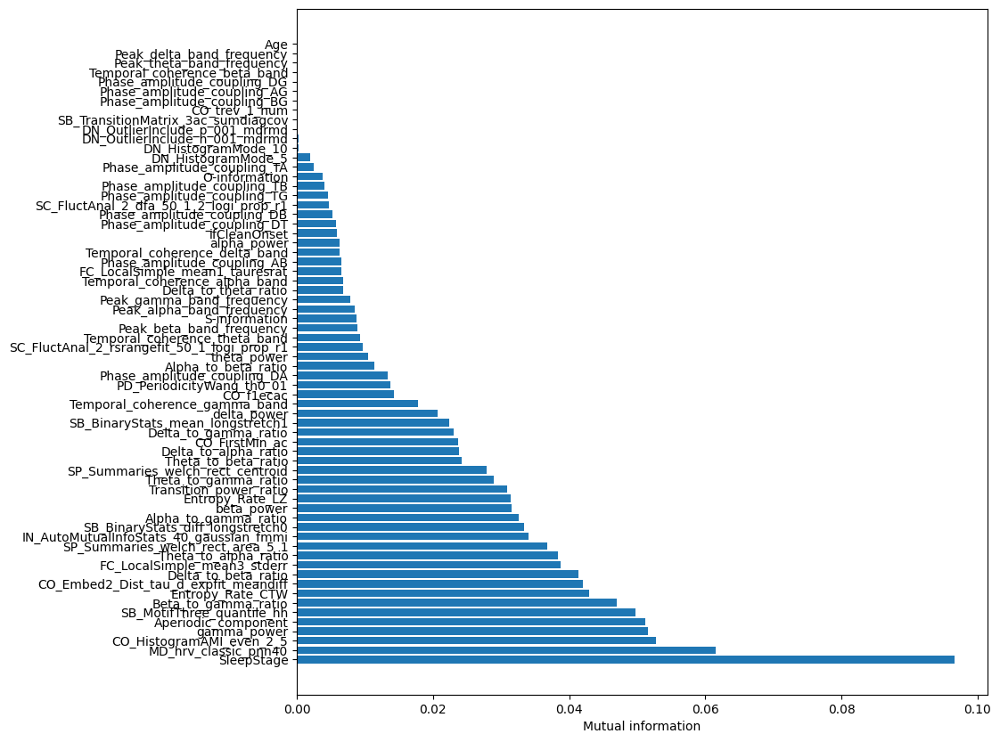

In [67]:
# calculate mutual information value between 'Label' and all the features using 

from sklearn.feature_selection import mutual_info_regression


# get the features
X = mydata_normalised_no_nans.drop(['Label'], axis=1)

# get the labels
y = mydata_normalised_no_nans['Label']


# calculate mutual information between 'Label' and all the features
mutual_info = mutual_info_regression(X, y, random_state=42)

# create a dataframe with the mutual information values
mutual_info_df = pd.DataFrame(mutual_info, index=X.columns, columns=['Mutual_info'])

# sort the dataframe by mutual information values

mutual_info_df.sort_values(by='Mutual_info', ascending=False, inplace=True)


# plot the mutual information values

plt.figure(figsize=(10, 10))
plt.barh(mutual_info_df.index, mutual_info_df['Mutual_info'])

plt.xlabel('Mutual information')

plt.show()


In [51]:
# Look which subjects have beta_power > 5
mydata_normalised[mydata_normalised['beta_power'] > 5]


,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information
0,30.0,2,83,0,0,9.773357,9.470881,10.120615,10.995050,9.542772,...,-15.755557,-2.763653,-3.028181,-0.420085,-3.659772,-6.104153,-5.944510,-4.523980,NaN,NaN
1,29.9,2,83,0,0,6.027452,7.268688,7.030947,7.717287,7.858091,...,-9.109066,-2.650491,-2.745173,1.461743,-1.007306,-2.704251,-2.252918,-4.633829,-0.355577,-0.720069
2,29.8,2,83,0,0,10.735656,10.689219,11.274928,10.008857,9.572763,...,-15.903870,-2.650491,-3.028181,-0.890542,-4.302637,-6.283174,-5.649968,-4.066696,NaN,NaN
3,29.7,2,83,0,0,8.572864,9.136241,9.467319,9.967944,9.217665,...,-15.665421,-2.650491,-0.622617,-0.633929,-3.769855,-6.094331,-6.062327,-4.368251,NaN,NaN
4,29.6,2,83,0,0,9.624098,10.386426,10.555366,10.157560,9.582234,...,-16.675818,-2.650491,-3.028181,-1.638996,-4.530498,-6.621793,-6.710319,-4.425842,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175189,1.1,6802,65,0,0,0.109786,0.751024,3.449226,6.084836,-1.317647,...,-1.750640,-2.927968,0.382798,-0.868611,-0.528761,-0.610789,-1.107576,1.388296,2.413179,8.923058
175194,0.6,6802,65,0,2,-0.528248,1.765804,3.249108,5.490527,-2.822589,...,-2.108756,-2.732190,2.866534,-0.642588,-0.723115,-0.798936,-1.349375,2.014604,NaN,NaN
175196,0.4,6802,65,0,1,-1.871937,-1.436787,3.378795,5.254153,-4.504674,...,-2.397272,-2.927968,-0.658769,-0.467602,-0.280502,-1.234635,-1.228475,2.910592,NaN,NaN
175198,0.2,6802,65,0,1,6.012228,6.072878,6.042688,11.112624,6.807202,...,-7.716606,-1.557522,-2.528247,-1.585568,-3.078382,-3.097063,-2.981521,-0.294949,-0.157187,0.834261


In [52]:
# get the unique ids of the subjects that have beta_power > 5
unique_subjects_beta_power = mydata_normalised[mydata_normalised['beta_power'] > 5]['Sbj_ID'].unique()
len(unique_subjects_beta_power)

522

In [53]:
# Look which subjects have beta_power > 5
mydata_normalised[mydata_normalised['beta_power'] < 5]


,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,SB_MotifThree_quantile_hh,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information
6,29.4,2,83,0,0,-0.463816,1.116320,2.337119,2.387975,-0.088816,...,-1.271371,-1.858362,-0.056602,0.456676,0.254169,-1.176298,-0.524939,0.172174,-6.078268,3.088197
11,28.9,2,83,0,0,2.163004,3.125984,1.543029,0.515388,-0.236514,...,-1.479721,-1.066232,2.490467,-0.847773,-0.705777,-0.850679,-1.820923,1.692150,NaN,NaN
29,27.1,2,83,0,0,-0.601457,0.477539,-0.466559,1.850783,3.539382,...,3.403956,-2.197846,-2.603670,5.439244,4.434235,2.940894,3.716464,-2.963280,NaN,NaN
30,27.0,2,83,0,0,-0.783725,3.548891,3.755707,1.589592,-0.419069,...,-2.004675,-1.518877,-2.603670,0.520829,-0.377021,-2.545654,-2.527824,1.019836,NaN,NaN
31,26.9,2,83,0,0,-0.789827,0.844049,0.449419,0.454308,0.854863,...,1.397335,-1.896082,-1.377304,1.219387,1.630346,0.636102,1.242312,-0.318166,-3.447281,3.202421
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175187,1.3,6802,65,0,0,-0.742424,0.930490,-0.311926,0.629996,-3.643181,...,-1.539596,-2.732190,2.866534,-1.196710,-0.716113,-0.867910,-0.684427,3.469690,NaN,NaN
175188,1.2,6802,65,0,0,1.115224,1.097663,0.968950,1.495366,-2.776439,...,-2.645981,-2.927968,2.706293,-1.677921,-2.394513,-2.929279,-3.223320,3.217340,NaN,NaN
175193,0.7,6802,65,0,2,0.605170,-1.903846,0.578622,3.493154,-3.538803,...,-2.331494,-2.927968,2.546052,-1.371696,-1.080740,-1.384074,-1.288925,3.343464,NaN,NaN
175195,0.5,6802,65,0,1,3.257887,1.715737,1.830016,1.863541,-1.382500,...,-2.143245,-1.459633,2.465931,-1.422734,-1.857886,-1.398932,-1.923649,1.664899,19.137499,15.422550


In [54]:
# get the unique ids of the subjects that have beta_power > 5
unique_subjects_beta_power_less = mydata_normalised[mydata_normalised['beta_power'] < 5]['Sbj_ID'].unique()
len(unique_subjects_beta_power_less)

524

In [55]:
# Calculate for each subject, whether they have more rows with beta_power > 5 or less
beta_power_more = {}
beta_power_less ={}

for sbj in unique_subjects_beta_power:
    number_more_than_5 = sum(mydata_normalised[mydata_normalised['Sbj_ID'] == sbj]['beta_power'] > 5)
    proportion_more_than_5 = number_more_than_5 / len(mydata_normalised[mydata_normalised['Sbj_ID'] == sbj]['beta_power'].dropna())
    number_less_than_5 = sum(mydata_normalised[mydata_normalised['Sbj_ID'] == sbj]['beta_power'] < 5)
    proportion_less_than_5 = number_less_than_5 / len(mydata_normalised[mydata_normalised['Sbj_ID'] == sbj]['beta_power'].dropna())

    if number_more_than_5 > number_less_than_5:
        beta_power_more[sbj] = proportion_more_than_5
    else:
        beta_power_less[sbj] = proportion_less_than_5

# sort the proportions by descending order
beta_power_more = {k: v for k, v in sorted(beta_power_more.items(), key=lambda item: item[1], reverse=True)}
beta_power_less = {k: v for k, v in sorted(beta_power_less.items(), key=lambda item: item[1], reverse=True)}




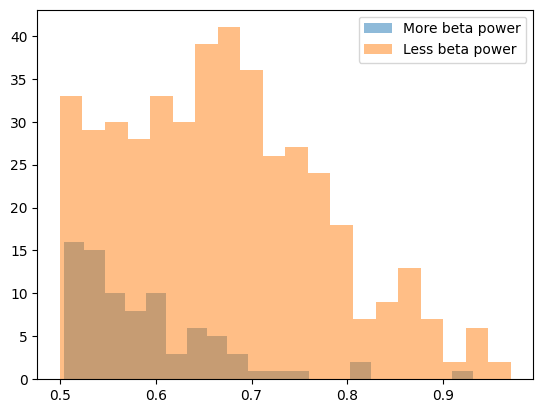

In [56]:
# plot the distribution of proportions for each group
plt.hist(list(beta_power_more.values()), bins=20, alpha=0.5, label='More beta power')
plt.hist(list(beta_power_less.values()), bins=20, alpha=0.5, label='Less beta power')
plt.legend(loc='upper right')


Sbj ID:  3190


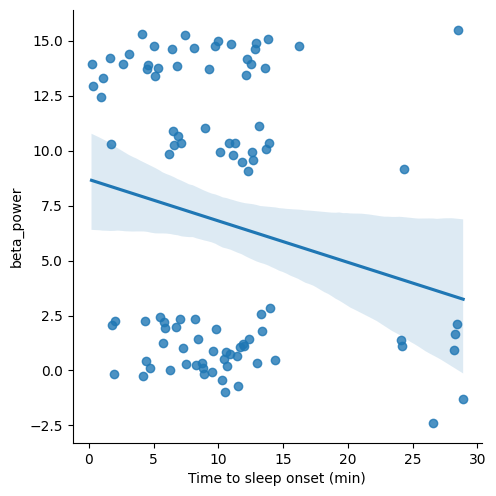

Sbj ID:  1260


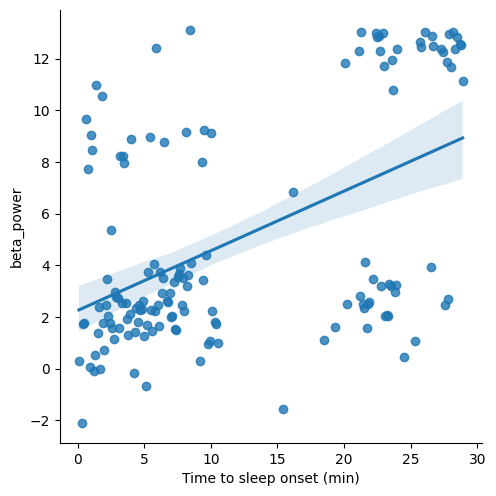

Sbj ID:  6020


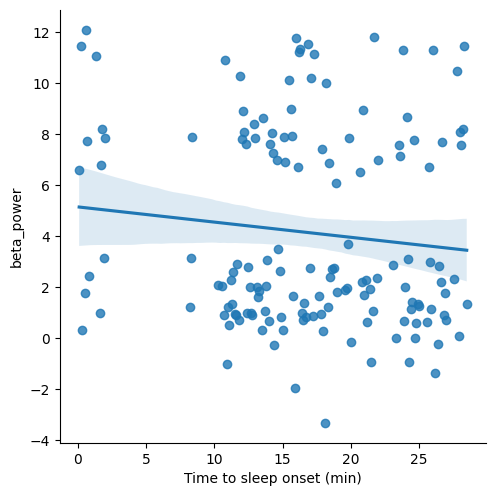

Sbj ID:  2216


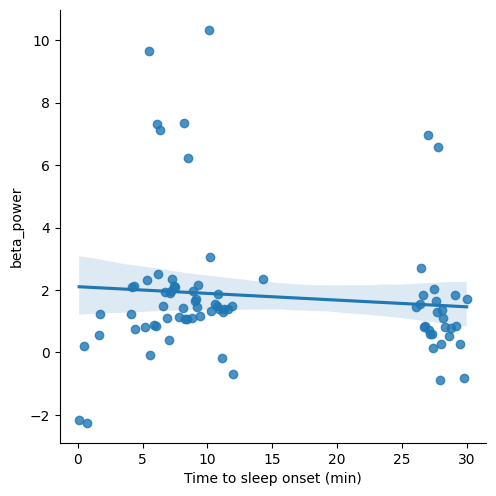

Sbj ID:  107


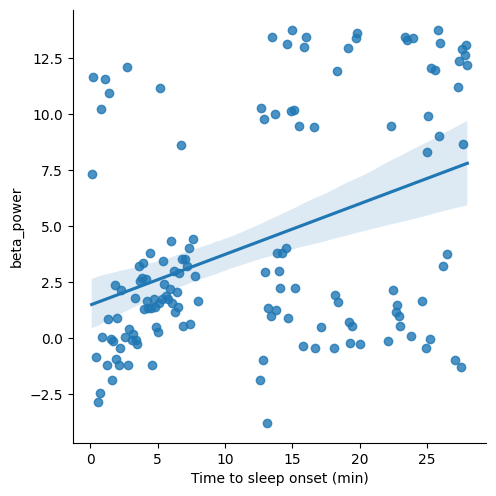

Sbj ID:  1890


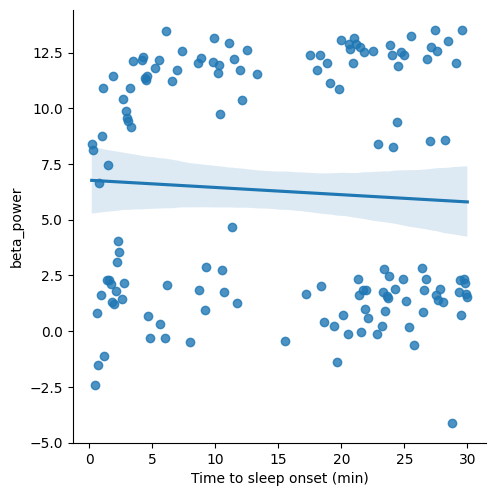

Sbj ID:  6549


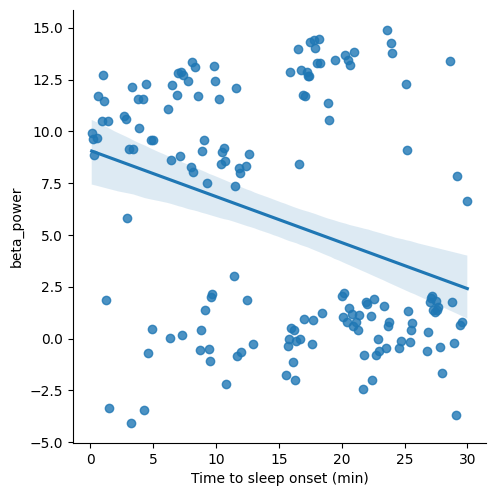

Sbj ID:  2443


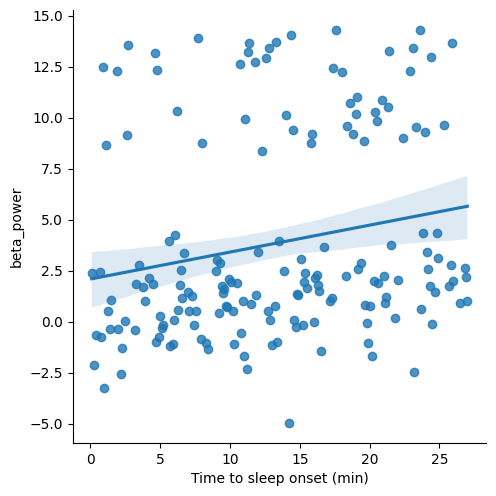

Sbj ID:  1995


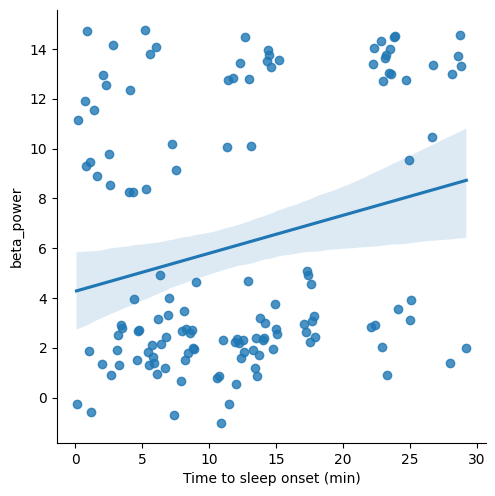

In [253]:
# show subject 3803
show_feature_for_ransom_subjects(mydata_normalised, 'beta_power', 10, random_seed=42)

In [250]:
beta_power_more

{3803: 0.9310344827586207,
 6784: 0.8202247191011236,
 5274: 0.8125,
 3920: 0.7441860465116279,
 6786: 0.7217391304347827,
 460: 0.7164179104477612,
 2504: 0.6931818181818182,
 2451: 0.6888888888888889,
 5621: 0.6842105263157895,
 821: 0.6704545454545454,
 854: 0.6666666666666666,
 5513: 0.6643356643356644,
 596: 0.6637931034482759,
 4301: 0.6567164179104478,
 526: 0.6511627906976745,
 3389: 0.6363636363636364,
 2167: 0.6356589147286822,
 54: 0.6352941176470588,
 680: 0.6330275229357798,
 6075: 0.6326530612244898,
 2614: 0.6307692307692307,
 3743: 0.6237623762376238,
 962: 0.6210526315789474,
 1959: 0.6086956521739131,
 725: 0.6071428571428571,
 2104: 0.6062176165803109,
 5396: 0.6036036036036037,
 2363: 0.6022099447513812,
 2616: 0.6,
 6076: 0.6,
 3793: 0.5974025974025974,
 2574: 0.5960264900662252,
 581: 0.5954198473282443,
 3347: 0.5869565217391305,
 6475: 0.5822784810126582,
 1570: 0.5816993464052288,
 4389: 0.5789473684210527,
 4174: 0.5777777777777777,
 1527: 0.5730337078651685,


In [59]:
mydata_normalised_raw['Sbj_ID'].nunique()

524

In [62]:
# Get the number of data points for each timepoint

# transform value_count() into a dictionary
value_per_time_point_dict = mydata_normalised_no_nans['Label'].value_counts().to_dict()

# normalise it agains the total number of subjects
for key in value_per_time_point_dict:
    value_per_time_point_dict[key] = value_per_time_point_dict[key] #/ mydata_normalised_raw['Sbj_ID'].nunique()

In [64]:
value_per_time_point_dict

{2.3: 204,
 3.0: 197,
 3.1: 192,
 1.5: 190,
 1.7: 189,
 2.9: 189,
 2.0: 188,
 2.5: 185,
 1.9: 185,
 1.6: 184,
 2.2: 183,
 3.5: 182,
 2.8: 181,
 1.8: 181,
 2.7: 179,
 2.4: 179,
 1.1: 177,
 4.2: 176,
 0.5: 176,
 4.8: 176,
 2.6: 175,
 3.8: 175,
 1.2: 175,
 4.6: 174,
 4.7: 174,
 1.3: 174,
 4.5: 173,
 3.3: 173,
 4.1: 173,
 4.4: 172,
 0.300000000000001: 169,
 1.4: 168,
 3.2: 168,
 1.0: 167,
 3.4: 166,
 5.3: 166,
 5.2: 166,
 5.0: 165,
 3.6: 165,
 4.9: 165,
 3.9: 164,
 6.8: 162,
 5.5: 162,
 5.6: 161,
 8.4: 160,
 3.7: 159,
 2.1: 159,
 4.3: 159,
 5.1: 157,
 0.899999999999999: 157,
 0.800000000000001: 156,
 5.7: 155,
 7.3: 155,
 7.6: 154,
 5.4: 154,
 6.2: 153,
 7.2: 152,
 6.3: 151,
 8.6: 151,
 6.5: 151,
 0.399999999999999: 149,
 0.699999999999999: 148,
 6.6: 148,
 5.9: 148,
 6.7: 147,
 7.8: 147,
 7.0: 146,
 7.4: 146,
 7.1: 146,
 6.1: 145,
 4.0: 145,
 6.0: 145,
 8.5: 144,
 6.9: 142,
 8.3: 140,
 0.600000000000001: 140,
 0.199999999999999: 140,
 9.2: 138,
 7.9: 138,
 7.7: 137,
 8.1: 135,
 5.8: 134,


In [65]:
# Sum all the values for each timepoint
sum_values = sum(value_per_time_point_dict.values())
sum_values

30525

Text(0, 0.5, 'Number of values that are not NaNs')

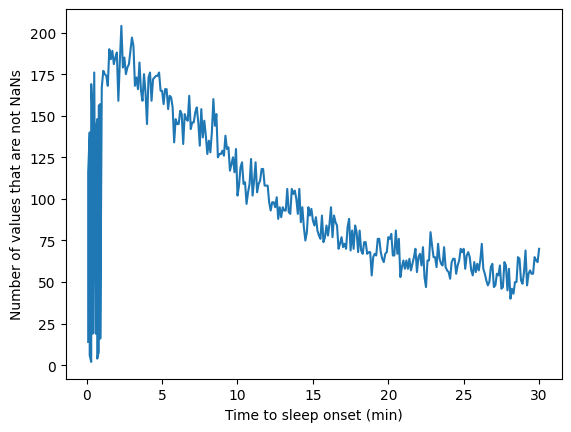

In [63]:
# plot the number of values that are not NaNs for each 'Label', ordered by the value of 'Label' where the x-axis is the 'Label' value and the y-axis is the number of values that are not NaNs
labels = mydata_normalised_no_nans['Label'].unique()
labels.sort()
num_not_nans = []
for label in labels:
    num_not_nans.append(value_per_time_point_dict[label])

plt.plot(labels, num_not_nans)
plt.xlabel('Time to sleep onset (min)')
plt.ylabel('Number of values that are not NaNs')


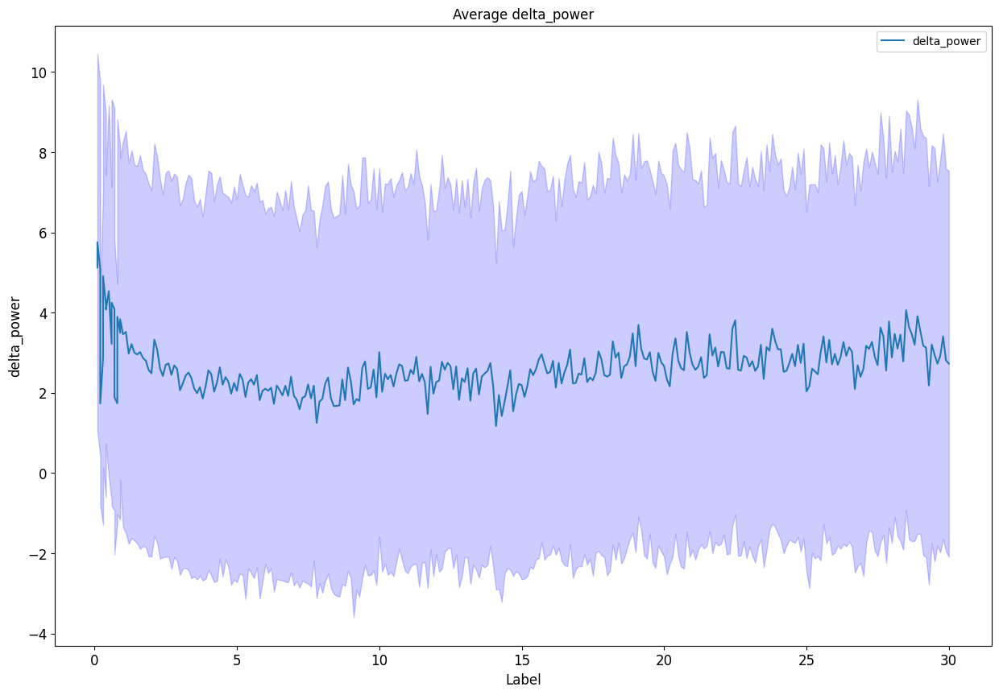

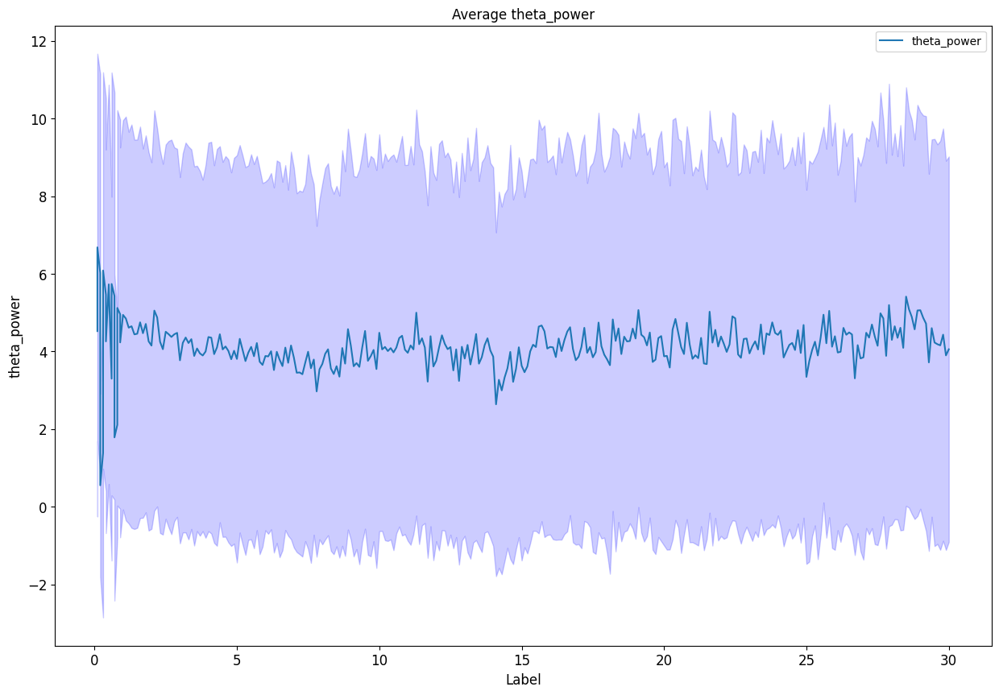

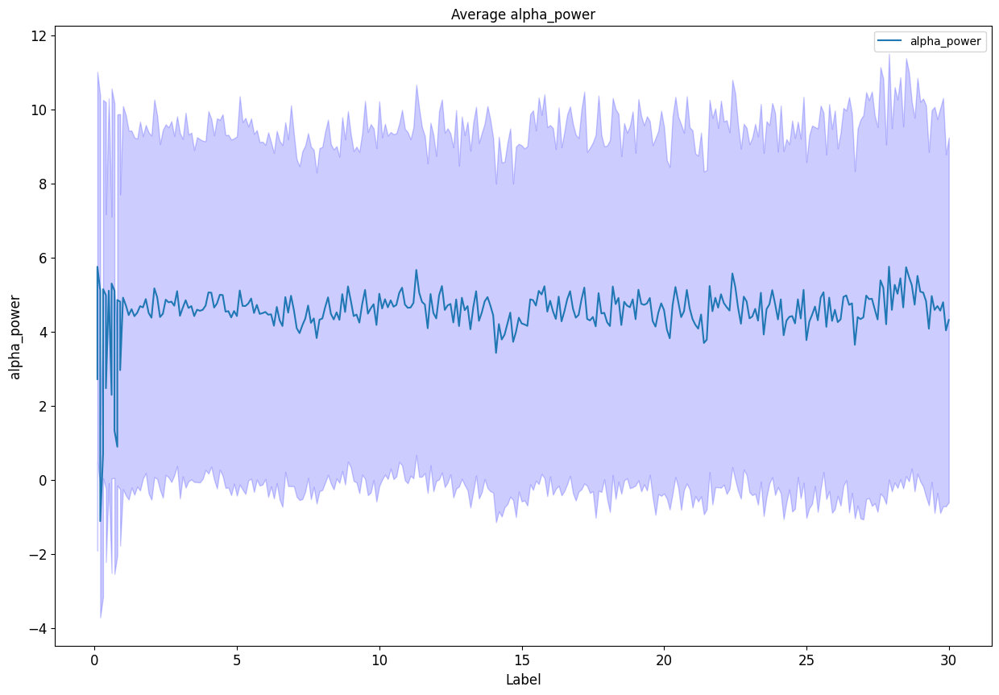

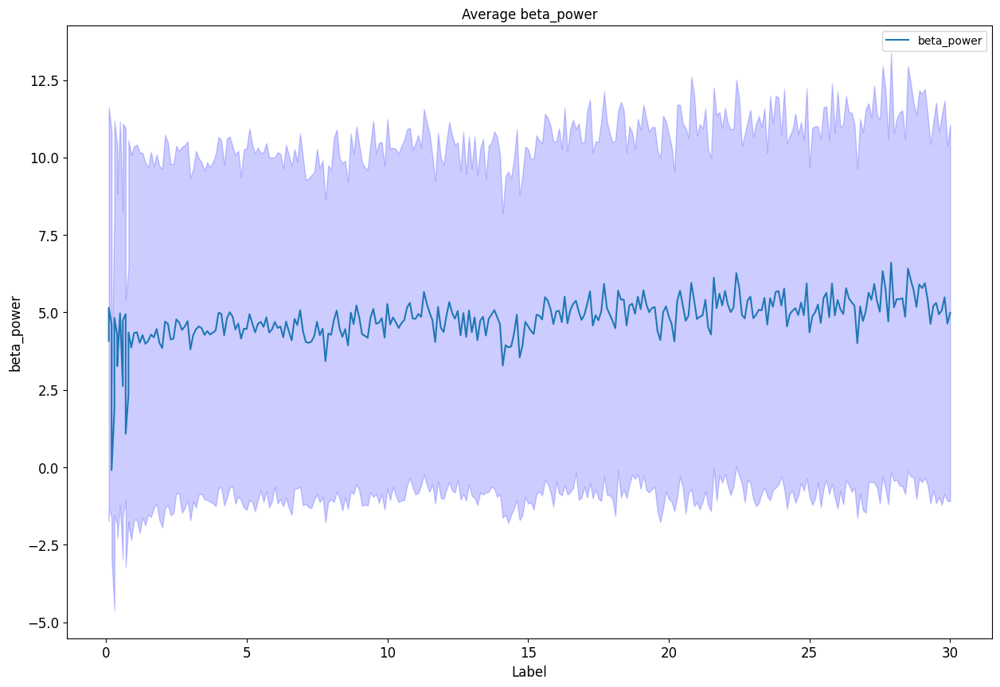

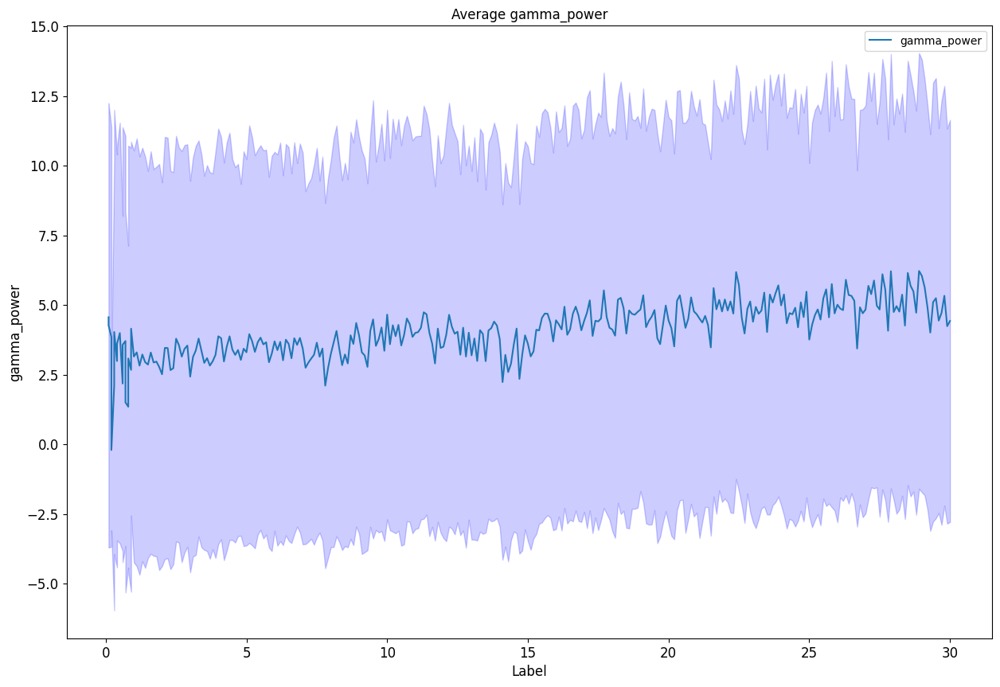

...

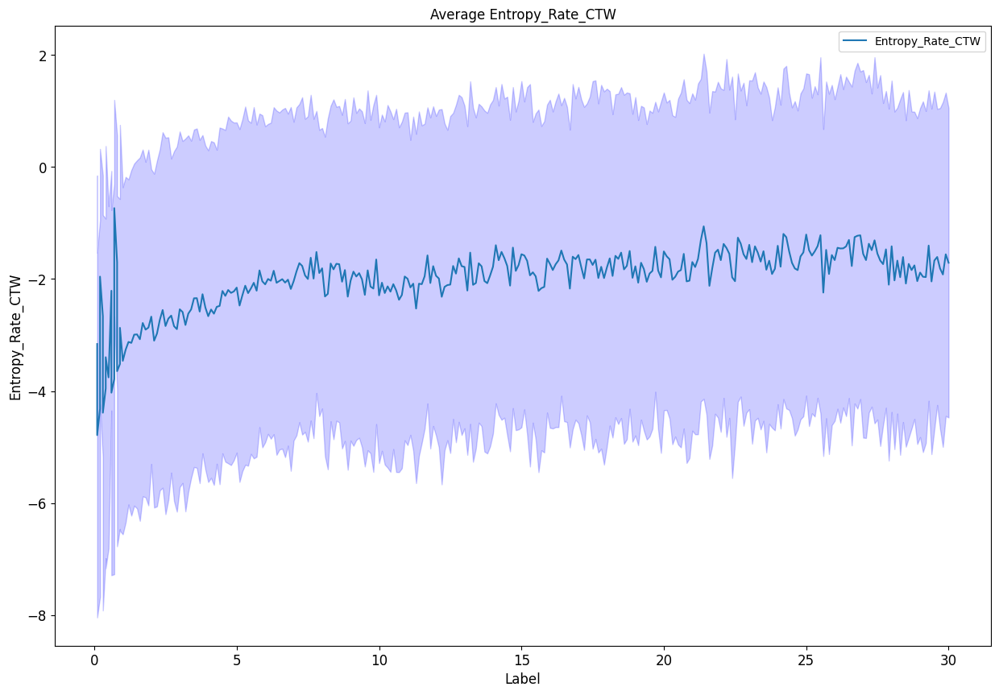

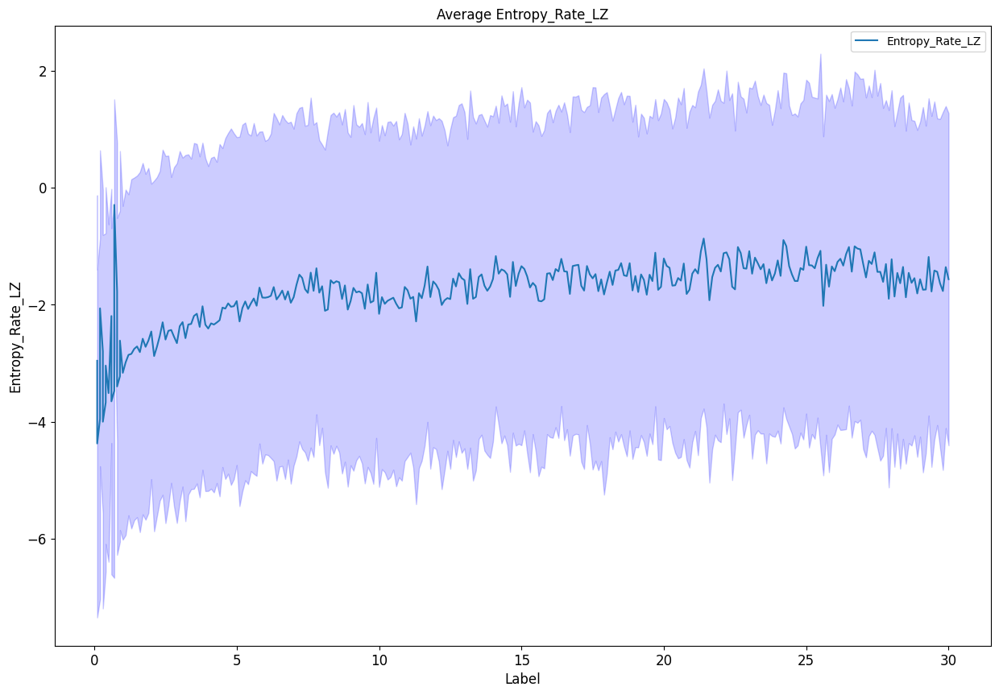

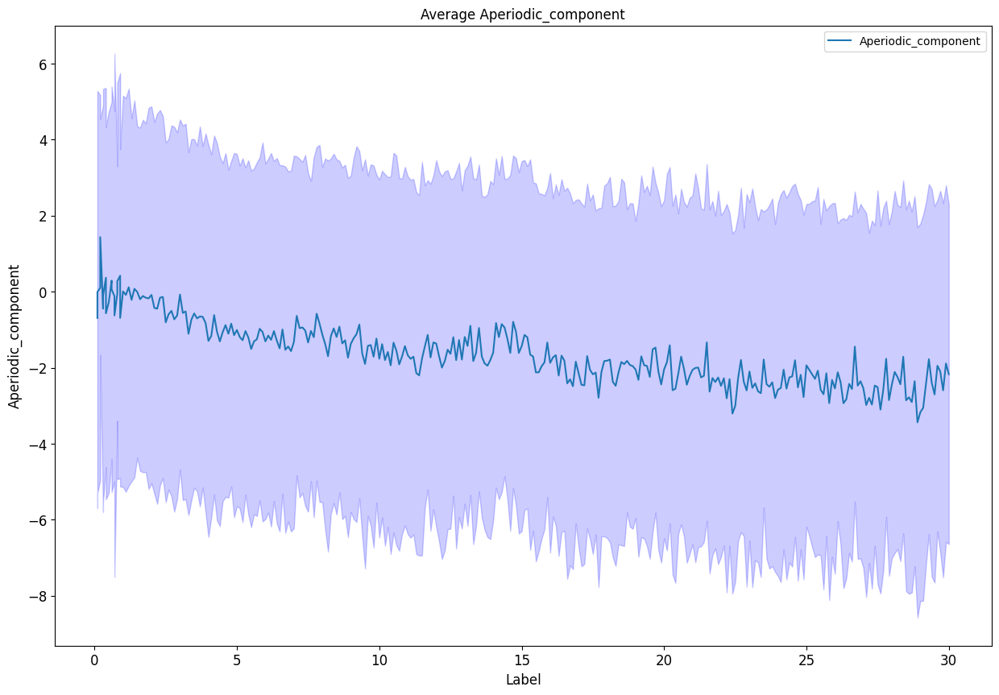

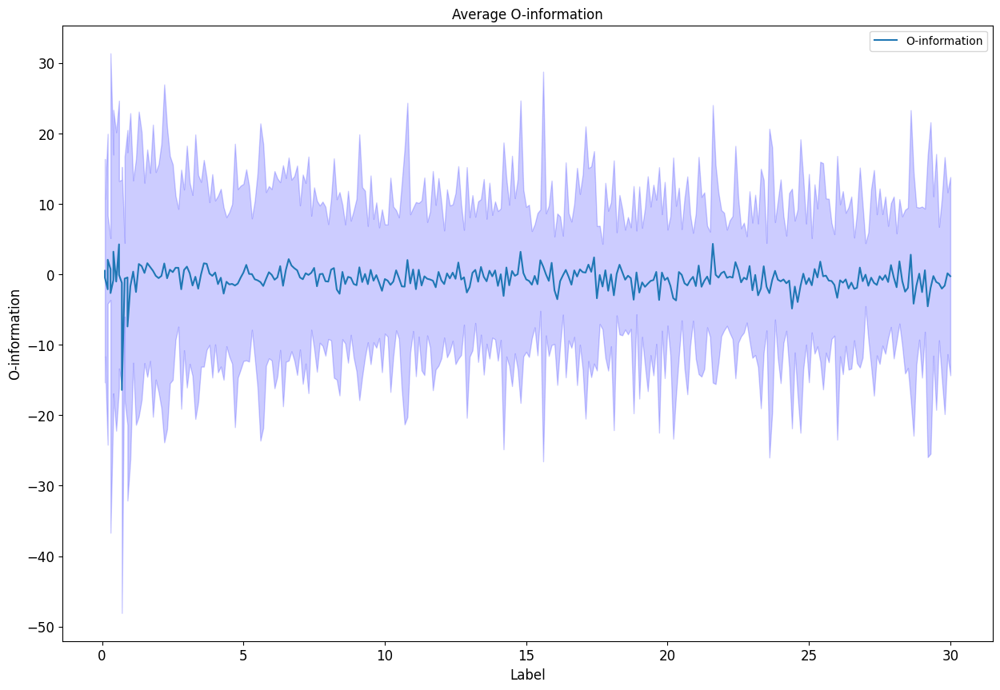

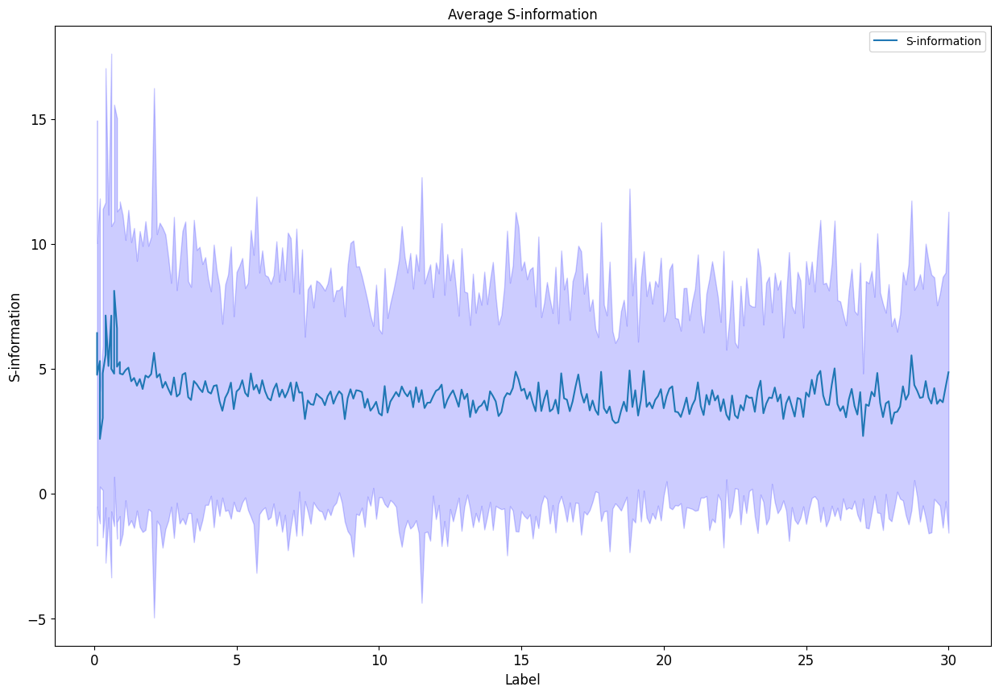

In [254]:
# For all features plot how their values change with the decreasing time to sleep onset(average + std)

labels = mydata_normalised['Label'].unique()
labels.sort()

for i in mydata_normalised.columns[4:]:
    # exclude SleepStage
    if i == 'SleepStage':
        continue
    average = mydata_normalised.groupby('Label')[i].mean()
    std = mydata_normalised.groupby('Label')[i].std()
    plot = average.plot(title='Average ' + i, figsize=(15, 10), legend=True, fontsize=12)
    plot.fill_between(labels, average - std, average + std, color='b', alpha=0.2)
    plot.set_xlabel('Label', fontsize=12)
    plot.set_ylabel(i, fontsize=12)
    plt.show()

## Preparation of baseline-awake normalised data for LSTM ##

In [156]:
#check how many nans we have in the mydata_normalised dataframe
mydata_normalised.isnull().sum()

Label                            0
Sbj_ID                           0
Age                              0
ifCleanOnset                     0
SleepStage                       0
                             ...  
Biphasic_vertices_count,    141870
Sleep_spindles_count,        85188
K_complex_count,            141870
O-information               111345
S-information               111345
Length: 72, dtype: int64

In [159]:
mydata_normalised.columns

Index(['Label', 'Sbj_ID', 'Age', 'ifCleanOnset', 'SleepStage', 'delta_power',
       'theta_power', 'alpha_power', 'beta_power', 'gamma_power',
       'Delta_to_theta_ratio', 'Delta_to_alpha_ratio', 'Delta_to_beta_ratio',
       'Delta_to_gamma_ratio', 'Theta_to_alpha_ratio', 'Theta_to_beta_ratio',
       'Theta_to_gamma_ratio', 'Alpha_to_beta_ratio', 'Alpha_to_gamma_ratio',
       'Beta_to_gamma_ratio', 'Transition_power_ratio',
       'Peak_delta_band_frequency', 'Peak_theta_band_frequency',
       'Peak_alpha_band_frequency', 'Peak_beta_band_frequency',
       'Peak_gamma_band_frequency', 'Temporal_coherence_delta_band',
       'Temporal_coherence_theta_band', 'Temporal_coherence_alpha_band',
       'Temporal_coherence_beta_band', 'Temporal_coherence_gamma_band',
       'Phase_amplitude_coupling_DT', 'Phase_amplitude_coupling_DA',
       'Phase_amplitude_coupling_DB', 'Phase_amplitude_coupling_DG',
       'Phase_amplitude_coupling_TA', 'Phase_amplitude_coupling_TB',
       'Phase_am

In [158]:
# Drop uninformative features
mydata_normalised.drop(['Monophasic_vertices_count,', 'Biphasic_vertices_count,', 'Sleep_spindles_count,', 'K_complex_count,'], axis=1, inplace=True)

KeyError: "['Monophasic_vertices_count,', 'Biphasic_vertices_count,', 'Sleep_spindles_count,', 'K_complex_count,'] not found in axis"

In [160]:
#check how many nans we have in the mydata_normalised dataframe
mydata_normalised.isnull().sum()

Label                       0
Sbj_ID                      0
Age                         0
ifCleanOnset                0
SleepStage                  0
                        ...  
Entropy_Rate_CTW        85057
Entropy_Rate_LZ         85057
Aperiodic_component     85057
O-information          111345
S-information          111345
Length: 68, dtype: int64

In [162]:
missing_mask_normalised = mydata_normalised.isnull().sum(axis=1).astype(bool).astype(int)

missing_mask_normalised.sum()


111345

In [163]:
mydata_normalised_locf = mydata_normalised.copy()
mydata_normalised_locf.fillna(method='ffill', inplace=True)

# Concatenating the missing value flags to the DataFrame
mydata_normalised_locf = pd.concat([mydata_normalised_locf, missing_mask_normalised.rename("missing_value_indicator")], axis=1)

In [166]:
mydata_normalised_locf.isnull().sum()

Label                      0
Sbj_ID                     0
Age                        0
ifCleanOnset               0
SleepStage                 0
                          ..
Entropy_Rate_LZ            0
Aperiodic_component        0
O-information              1
S-information              1
missing_value_indicator    0
Length: 69, dtype: int64

In [167]:
mydata_normalised_locf.fillna(method='bfill', inplace=True)

In [168]:
mydata_normalised_locf

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,SC_FluctAnal_2_rsrangefit_50_1_logi_prop_r1,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information,missing_value_indicator
0,30.0,2,83,0,0,9.773357,9.470881,10.120615,10.995050,9.542772,...,-2.763653,-3.028181,-0.420085,-3.659772,-6.104153,-5.944510,-4.523980,-0.355577,-0.720069,1
1,29.9,2,83,0,0,6.027452,7.268688,7.030947,7.717287,7.858091,...,-2.650491,-2.745173,1.461743,-1.007306,-2.704251,-2.252918,-4.633829,-0.355577,-0.720069,0
2,29.8,2,83,0,0,10.735656,10.689219,11.274928,10.008857,9.572763,...,-2.650491,-3.028181,-0.890542,-4.302637,-6.283174,-5.649968,-4.066696,-0.355577,-0.720069,1
3,29.7,2,83,0,0,8.572864,9.136241,9.467319,9.967944,9.217665,...,-2.650491,-0.622617,-0.633929,-3.769855,-6.094331,-6.062327,-4.368251,-0.355577,-0.720069,1
4,29.6,2,83,0,0,9.624098,10.386426,10.555366,10.157560,9.582234,...,-2.650491,-3.028181,-1.638996,-4.530498,-6.621793,-6.710319,-4.425842,-0.355577,-0.720069,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175195,0.5,6802,65,0,1,3.257887,1.715737,1.830016,1.863541,-1.382500,...,-1.459633,2.465931,-1.422734,-1.857886,-1.398932,-1.923649,1.664899,19.137499,15.422550,0
175196,0.4,6802,65,0,1,-1.871937,-1.436787,3.378795,5.254153,-4.504674,...,-2.927968,-0.658769,-0.467602,-0.280502,-1.234635,-1.228475,2.910592,19.137499,15.422550,1
175197,0.3,6802,65,0,1,0.174765,0.108926,0.606607,1.528183,-1.246703,...,-2.340634,0.783401,-1.298785,-1.335715,-1.732222,-1.802749,2.147479,30.696003,13.183157,0
175198,0.2,6802,65,0,1,6.012228,6.072878,6.042688,11.112624,6.807202,...,-1.557522,-2.528247,-1.585568,-3.078382,-3.097063,-2.981521,-0.294949,-0.157187,0.834261,0


Sbj ID:  3190


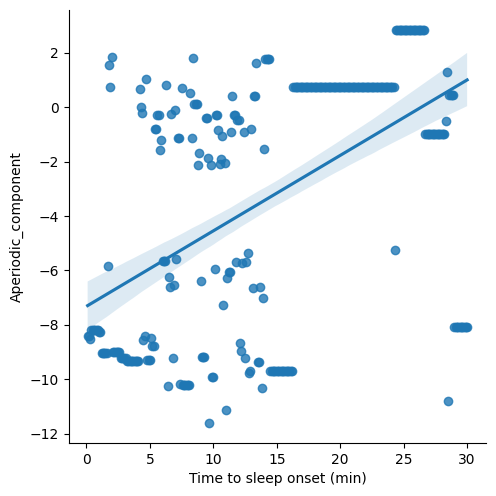

Sbj ID:  1260


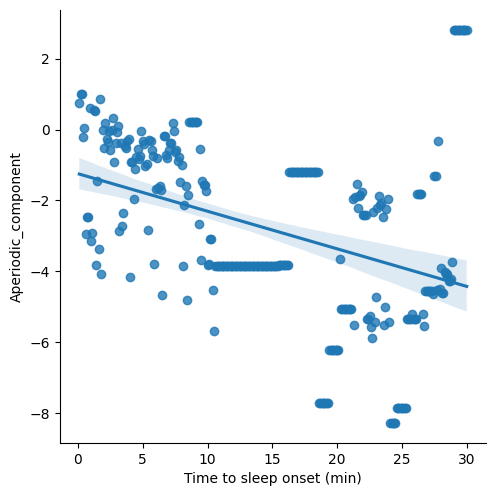

Sbj ID:  6020


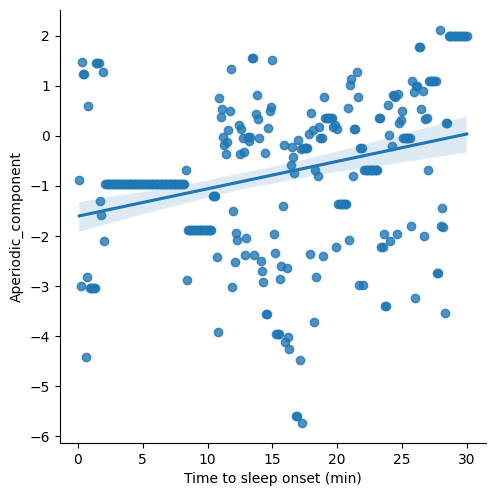

Sbj ID:  2216


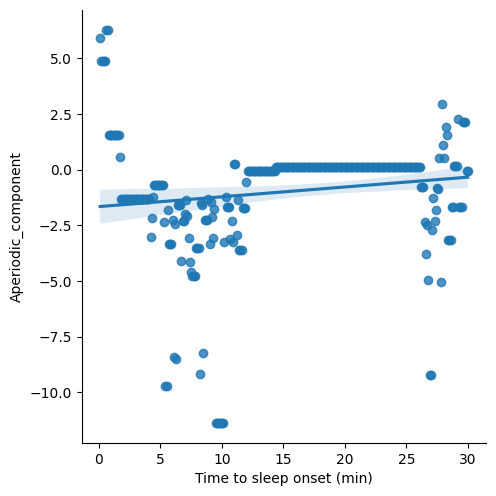

In [169]:
# show the same subjects as before but now with interpolated data
show_feature_for_ransom_subjects(mydata_normalised_locf, 'Aperiodic_component', 5)

In [170]:
# read matlab file containing mesa demo
mat = scipy.io.loadmat('/Users/anastasia/Dropbox/missing data/MESA_demo.mat')
id_mat = scipy.io.loadmat('/Users/anastasia/Dropbox/missing data/MESA_ID.mat')

# take 'MESA_Gender' and 'MESA_Race' from the mat matlab file and add them to the mesa_meta dataframe
mesa_gender = mat['MESA_Gender']
mesa_race = mat['MESA_Race']
mesa_age = mat['MESA_Age']

id_mat = id_mat['MESA_ID']

# check which subjects in the mydata dataframe are in the id_mat list and create a mask for id_mat list for subjects in mydata
mask = np.isin(id_mat, mydata_normalised_locf['Sbj_ID'])
cleaned_id_mat = id_mat[mask]
cleaned_gender= mesa_gender[mask]
cleaned_race = mesa_race[mask]


# apply teh mask to mesa_age and check whether it's the same as in mydata['Age']
mesa_age_masked = mesa_age[mask]

# check whether the age is the same as mydata unique age per subject
unique_age = mydata_normalised_locf.groupby('Sbj_ID')['Age'].unique()

# check whether the age is the same as mydata unique age per subject
np.array_equal(mesa_age_masked, unique_age)

# to each unique subject, add the age, gender and race in mydata
mydata_normalised_locf['Gender'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(cleaned_id_mat, cleaned_gender)))
mydata_normalised_locf['Race'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(cleaned_id_mat, cleaned_race)))


In [179]:
# in mesa meta, only leave the subjects that are in unique subjects in mydata
unique_subjects_norm = mydata_normalised_locf['Sbj_ID'].unique()
mesa_meta_cleaned_norm= mesa_meta[mesa_meta['mesaid'].isin(unique_subjects_norm)].copy()

In [180]:
# Only leave the following columns in mesa_meta_cleaned: 'wkdaysleepdur5t', 
# 'wkendsleepdur5t', 'nap5', 'trbleslpng5', 'splngpills5', 'sleepy5', 'slpapnea5', 'legdscmfrt', 'rubbnglgs5'
# 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirsc5c', 
# 'epsipscl5c', 'hoostmeq5c'

mesa_meta_cleaned_norm = mesa_meta_cleaned_norm[['mesaid', 'wkdaysleepdur5t', 'wkendsleepdur5t', 'nap5', 'trbleslpng5', 'slpngpills5', 'sleepy5', 'legsdscmfrt5', 'rubbnglgs5', 'wrserest5', 'wrseltr5', 'slpapnea5', 'cpap5', 'dntaldv5', 'uvula5', 'insmnia5', 'rstlesslgs5', 'whiirs5c', 'epslpscl5c', 'hoostmeq5c']].copy()

In [181]:
# replace missing values with 0
mesa_meta_cleaned_norm = mesa_meta_cleaned_norm.fillna(0)

In [182]:
mesa_meta_cleaned_norm

,mesaid,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,sleepy5,legsdscmfrt5,rubbnglgs5,wrserest5,wrseltr5,slpapnea5,cpap5,dntaldv5,uvula5,insmnia5,rstlesslgs5,whiirs5c,epslpscl5c,hoostmeq5c
1,2,8.0,8.0,1.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,2.0,23.0
2,6,7.0,7.0,1.0,4.0,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,16.0,20.0
12,35,7.5,7.5,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,15.0
19,54,7.0,5.5,1.0,3.0,1.0,3.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,3.0,17.0
20,56,8.5,8.5,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,2.0,16.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2211,6739,9.0,9.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,1.0,16.0
2217,6756,8.5,8.5,1.0,1.0,1.0,5.0,1.0,0.0,9.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,11.0,8.0,18.0
2223,6784,7.0,6.5,1.0,1.0,5.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,5.0,20.0
2224,6786,6.0,6.0,0.0,3.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,4.0,16.0


In [183]:
# for each subject in mydata, find the corresponding mesa_meta_cleaned row and add the mesa_meta_cleaned columns to mydata for all datapoints for this subject without map
mydata_normalised_locf['wkdaysleepdur5t'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['wkdaysleepdur5t'])))
mydata_normalised_locf['wkendsleepdur5t'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['wkendsleepdur5t'])))
mydata_normalised_locf['nap5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['nap5'])))
mydata_normalised_locf['trbleslpng5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['trbleslpng5'])))
mydata_normalised_locf['slpngpills5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['slpngpills5'])))
mydata_normalised_locf['sleepy5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['sleepy5'])))
mydata_normalised_locf['legsdscmfrt5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['legsdscmfrt5'])))
mydata_normalised_locf['rubbnglgs5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['rubbnglgs5'])))
mydata_normalised_locf['wrserest5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['wrserest5'])))
mydata_normalised_locf['wrseltr5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['wrseltr5'])))
mydata_normalised_locf['slpapnea5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['slpapnea5'])))
mydata_normalised_locf['cpap5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['cpap5'])))
mydata_normalised_locf['dntaldv5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['dntaldv5'])))
mydata_normalised_locf['uvula5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['uvula5'])))
mydata_normalised_locf['insmnia5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['insmnia5'])))
mydata_normalised_locf['rstlesslgs5'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['rstlesslgs5'])))
mydata_normalised_locf['whiirs5c'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['whiirs5c'])))
mydata_normalised_locf['epslpscl5c'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['epslpscl5c'])))
mydata_normalised_locf['hoostmeq5c'] = mydata_normalised_locf['Sbj_ID'].map(dict(zip(mesa_meta_cleaned_norm['mesaid'], mesa_meta_cleaned_norm['hoostmeq5c'])))
mydata_normalised_locf

,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information,missing_value_indicator,Set
0,30.0,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-3.028181,-0.420085,-3.659772,-6.104153,-5.944510,-4.523980,-0.355577,-0.720069,1,train
1,29.9,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-2.745173,1.461743,-1.007306,-2.704251,-2.252918,-4.633829,-0.355577,-0.720069,0,train
2,29.8,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-3.028181,-0.890542,-4.302637,-6.283174,-5.649968,-4.066696,-0.355577,-0.720069,1,train
3,29.7,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-0.622617,-0.633929,-3.769855,-6.094331,-6.062327,-4.368251,-0.355577,-0.720069,1,train
4,29.6,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-3.028181,-1.638996,-4.530498,-6.621793,-6.710319,-4.425842,-0.355577,-0.720069,1,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175195,0.5,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,2.465931,-1.422734,-1.857886,-1.398932,-1.923649,1.664899,19.137499,15.422550,0,train
175196,0.4,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,-0.658769,-0.467602,-0.280502,-1.234635,-1.228475,2.910592,19.137499,15.422550,1,train
175197,0.3,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,0.783401,-1.298785,-1.335715,-1.732222,-1.802749,2.147479,30.696003,13.183157,0,train
175198,0.2,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,-2.528247,-1.585568,-3.078382,-3.097063,-2.981521,-0.294949,-0.157187,0.834261,0,train


In [184]:
# let's relocate all the columns after Gender to go after Age

# get the index of Gender
a = mydata_normalised_locf.columns.get_loc('Gender')

# get the index of Age
b = mydata_normalised_locf.columns.get_loc('Age')

# get the list of columns
cols = list(mydata_normalised_locf.columns)

# reidex the list of columns usign reindex()

cols = cols[:b+1] + cols[a:] + cols[b+1:a]

# reindex the dataframe using reindex()
mydata_normalised_locf = mydata_normalised_locf.reindex(columns = cols)

mydata_normalised_locf

,Label,Sbj_ID,Age,Gender,Race,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,...,SC_FluctAnal_2_dfa_50_1_2_logi_prop_r1,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,O-information,S-information,missing_value_indicator,Set
0,30.0,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-3.028181,-0.420085,-3.659772,-6.104153,-5.944510,-4.523980,-0.355577,-0.720069,1,train
1,29.9,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-2.745173,1.461743,-1.007306,-2.704251,-2.252918,-4.633829,-0.355577,-0.720069,0,train
2,29.8,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-3.028181,-0.890542,-4.302637,-6.283174,-5.649968,-4.066696,-0.355577,-0.720069,1,train
3,29.7,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-0.622617,-0.633929,-3.769855,-6.094331,-6.062327,-4.368251,-0.355577,-0.720069,1,train
4,29.6,2,83,0,1,8.0,8.0,1.0,2.0,2.0,...,-3.028181,-1.638996,-4.530498,-6.621793,-6.710319,-4.425842,-0.355577,-0.720069,1,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175195,0.5,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,2.465931,-1.422734,-1.857886,-1.398932,-1.923649,1.664899,19.137499,15.422550,0,train
175196,0.4,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,-0.658769,-0.467602,-0.280502,-1.234635,-1.228475,2.910592,19.137499,15.422550,1,train
175197,0.3,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,0.783401,-1.298785,-1.335715,-1.732222,-1.802749,2.147479,30.696003,13.183157,0,train
175198,0.2,6802,65,0,3,9.5,9.5,0.0,1.0,1.0,...,-2.528247,-1.585568,-3.078382,-3.097063,-2.981521,-0.294949,-0.157187,0.834261,0,train


In [185]:
delta_power_index = mydata_normalised_locf.columns.get_loc('delta_power')

In [186]:
# NOT SURE ABOUT THIS AS MANY OF THEM ARE CATEGORICAL 
# for columns from 'Age' to 'hoostmeq5c', perform normalization across all subjects

for i in range(2, delta_power_index):
    mydata_normalised_locf.iloc[:, i] = mydata_normalised_locf[mydata_normalised_locf.columns[i]].transform(lambda x: (x - x.mean()) / x.std())

got here
----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 26.188631057739258, Validation Loss: 107.07232163787758
----------------------------------------------------------------------------------------------------
Validation MAPE: 254.95076179504395, Validation MAE: 9.462570190429688, Validation Accuracy: -154.95076179504395
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 19.71035385131836, Validation Loss: 104.39957382940028
----------------------------------------------------------------------------------------------------
Validation MAPE: 289.86263275146484, Validation MAE: 9.155126571655273, Validation Accuracy: -189.86263275146484
----------------------------------------------------------------------------------------------------

----------

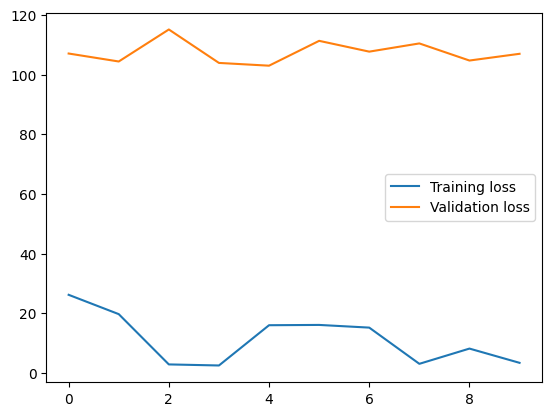

Test Loss: 99.35622072539874
(23810,) (23810,)
Mean Absolute Error: 8.0
Accuracy: -139.16 %.
Mean Squared Error: 99.39
Root Mean Squared Error: 9.97
R2: -0.21


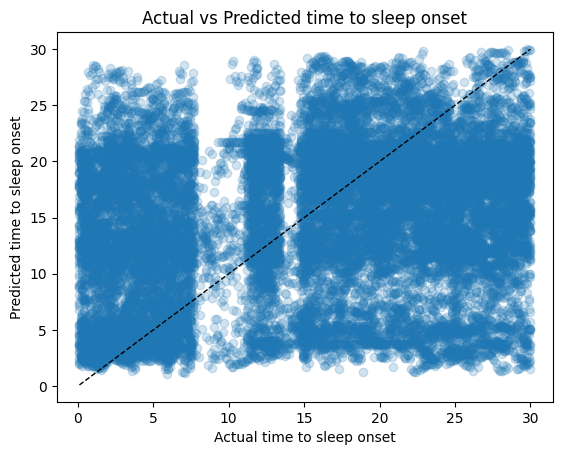

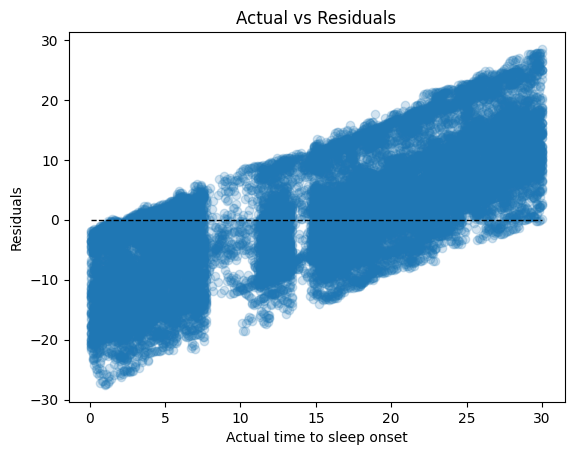

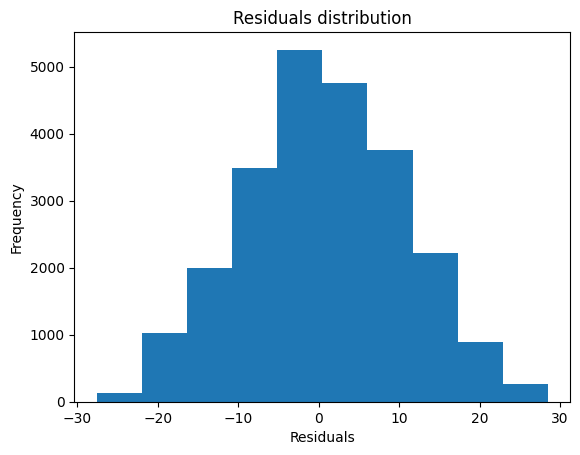

In [187]:
train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(mydata_normalised_locf, input_size = 86, num_epochs=10, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=32, device=device, random_seed=42, window_size_minutes=5, iftest=1, ifoutputpredictions=0)

## Try darts library (TFT)

## Experimentation with interpolation of missing values

In [ ]:
# introduce a datetime index column from the 'label' column
mydata['datetime'] = pd.to_datetime(mydata['Label']*60, unit='s')

In [ ]:
# For each subject, apply linear interpolation to fill in the NaNs unless the number of consecutive NaNs is more than 10

mydata_interp = mydata.copy()
mydata_interp = mydata_interp.drop(['datetime'], axis=1)
mydata_interp = mydata_interp.interpolate(method='linear', limit = 10, limit_direction='both')




Sbj ID:  3399


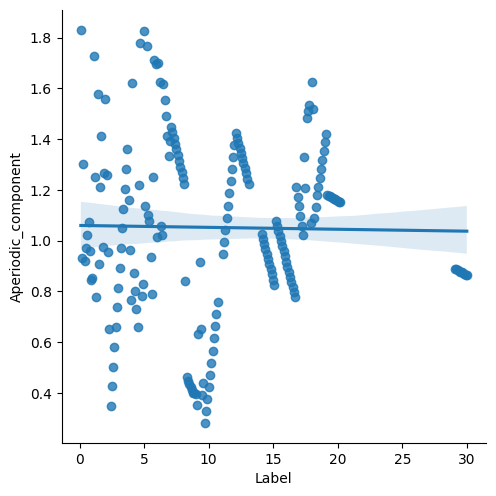

Sbj ID:  2887


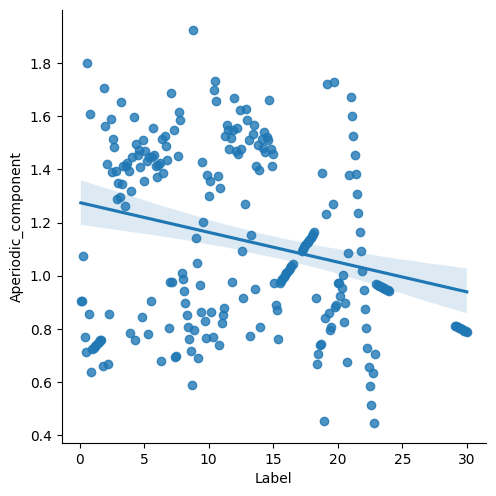

Sbj ID:  6351


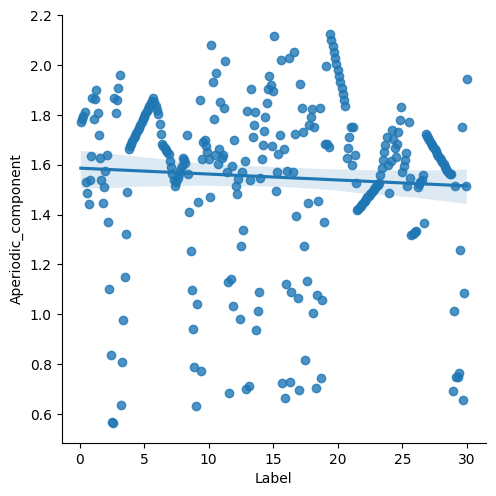

Sbj ID:  1256


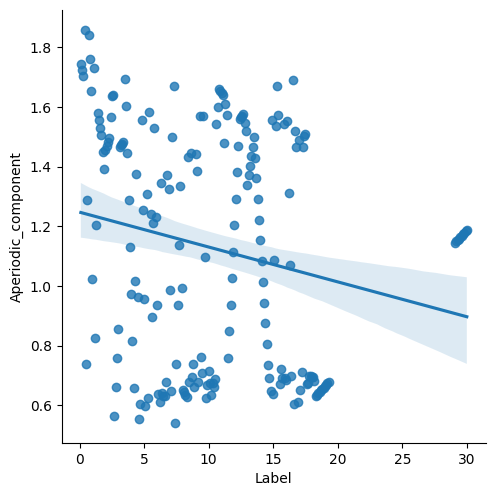

In [ ]:
# show the same subjects as before but now with interpolated data
show_feature_for_ransom_subjects(mydata_interp, 'Aperiodic_component', 5)

In [ ]:
mydata_interp_time = mydata.copy()
mydata_interp_time = mydata_interp_time.interpolate(method='bfill',limit = 30, limit_direction='backward')


Sbj ID:  3399


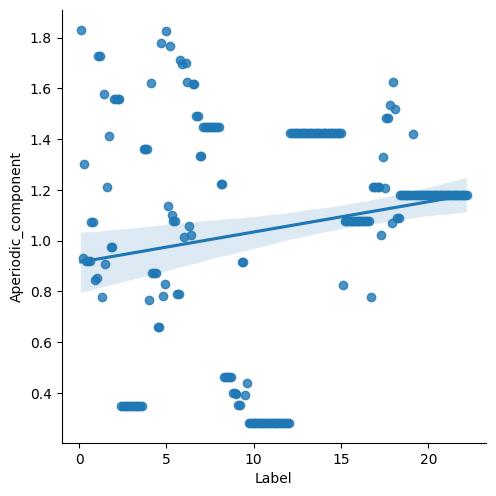

Sbj ID:  2887


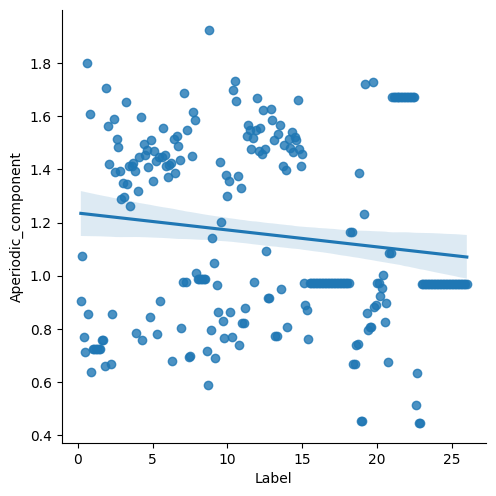

Sbj ID:  6351


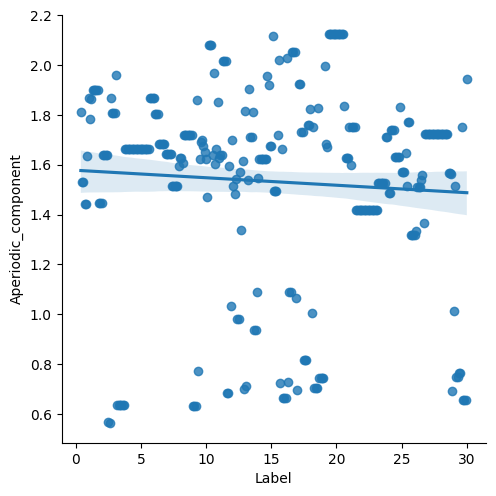

Sbj ID:  1256


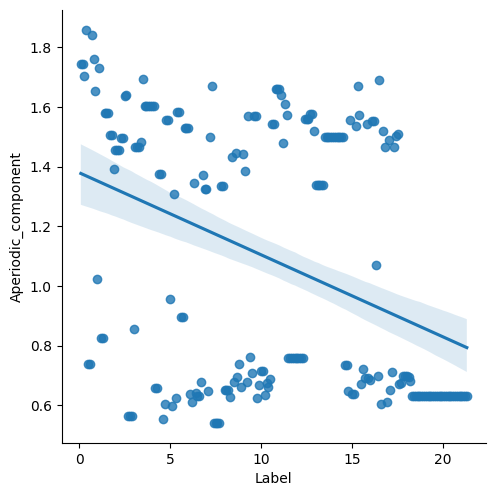

In [ ]:
# show the same subjects as before but now with interpolated data
show_feature_for_ransom_subjects(mydata_interp_time, 'Aperiodic_component', 5)

## Try models that uses missing indicator values and Last Observation Carried Forward (LOCF) aka forward fill ##

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.preprocessing import StandardScaler
import seaborn as sns


In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
#Create a PyTorch dataset
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
class SleepDataset(Dataset):
    def __init__(self, sequences, labels):
        self.sequences = sequences
        self.labels = labels

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return torch.from_numpy(self.sequences[idx]).float(), torch.from_numpy(np.array(self.labels[idx])).float()

In [ ]:
# Create a function for creating sliding windows of selected length 

def create_sliding_windows(data,  window_size_minutes=5, random_seed = 42):

    # Assert whether therea are any NaNs in the data
    assert data.isnull().sum().sum() == 0, "There are NaNs in the data"

    # Create a list of all unique subjects
    subjects = data['Sbj_ID'].unique()


    # Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set
    np.random.seed(random_seed)
    train_subjects = np.random.choice(subjects, size=int(0.6*len(subjects)), replace=False)
    val_subjects = np.random.choice(np.setdiff1d(subjects, train_subjects), size=int(0.2*len(subjects)), replace=False)
    test_subjects = np.setdiff1d(subjects, np.concatenate((train_subjects, val_subjects)))
   
    
    # Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
    data['Set'] = 'train'
    data.loc[data['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
    data.loc[data['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'

    # Sort your dataframe by Sbj_ID if not already sorted
    data = data.sort_values('Sbj_ID')

    # Convert the window size from minutes to 6-second epochs
    window_size = int((window_size_minutes*60)/6)

    # Create empty lists to store your sequences and labels
    train_sequences = []
    train_labels = []
    val_sequences = []
    val_labels = []
    test_sequences = []
    test_labels = []

    # Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
    for _, group in data.groupby('Sbj_ID'):
        
        # For each group, get the feature columns and convert them into numpy array
        group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

        train_test = group['Set'].iloc[0]
        
        if window_size == len(group_features):
            if train_test == 'train':
                print('got here')
                train_sequences.append(group_features)
                train_labels.append(group['Label'].iloc[0])
            elif train_test == 'val':
                val_sequences.append(group_features)
                val_labels.append(group['Label'].iloc[0])
            elif train_test == 'test':
                test_sequences.append(group_features)
                test_labels.append(group['Label'].iloc[0])
        elif window_size > len(group_features):
            continue


        # Iterate over the group array with a sliding window
        for i in range(len(group_features) - window_size):
            

            if train_test == 'train':

                # Append the window data to your sequences
                train_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                train_labels.append(group['Label'].iloc[i + window_size])

            
            elif train_test == 'val':
                # Append the window data to your sequences
                val_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                val_labels.append(group['Label'].iloc[i + window_size])

            elif train_test == 'test':
                # Append the window data to your sequences
                test_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                test_labels.append(group['Label'].iloc[i + window_size])
            
    # Convert the sequences and labels into numpy arrays
    train_sequences = np.array(train_sequences)
    train_labels = np.array(train_labels)
    val_sequences = np.array(val_sequences)
    val_labels = np.array(val_labels)
    test_sequences = np.array(test_sequences)
    test_labels = np.array(test_labels)

    return train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels




In [ ]:
class SleepOnsetRNN(nn.Module):

    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])

        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)

        return out + self.l2 * l2_reg

In [ ]:
def train(model, train_loader, val_loader, num_epochs, criterion, optimizer, device, ifoutputpredictions):

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):

        # Train the model
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
        
            loss = criterion(outputs, labels.view(-1, 1))

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Validate the model
        model.eval()
        with torch.no_grad():
            val_loss = 0
            predictions, actuals = [], []
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                val_loss += criterion(outputs, labels.view(-1, 1)).item()

                

                predictions.append(outputs.cpu().numpy())
                actuals.append(labels.cpu().numpy())
            
            
           
            print('-'*100)
            print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Loss: {val_loss/len(val_loader)}')

        # Save the model training and validation losses for plotting 
        train_losses.append(loss.item())
        val_losses.append(val_loss/len(val_loader))

        # Calculate the mape, mae, and accuracy for the validation set
        predictions = np.concatenate(predictions)
        actuals = np.concatenate(actuals)
        mape = np.mean(np.abs(predictions - actuals)/actuals) * 100
        mae = np.mean(np.abs(predictions - actuals))
        # calculate accuracy in percentage
        accuracy = 100 - np.mean(mape)
      
        print('-'*100 )
        print(f'Validation MAPE: {mape}, Validation MAE: {mae}, Validation Accuracy: {accuracy}')
        print('-'*100 + '\n')

        
        last_predictions = predictions
    if ifoutputpredictions: 
        return train_losses, val_losses, model, accuracy, mape, mae, predictions, actuals
    else:    
        return train_losses, val_losses, model, accuracy, mape, mae
# test the trained model

def test(model, test_loader, device, criterion):
    model.eval()
    predictions, actuals = [], []
    with torch.no_grad():
        test_loss = 0
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            test_loss += criterion(outputs, labels.view(-1, 1)).item()

            predictions.append(outputs.cpu().numpy())
            actuals.append(labels.cpu().numpy())

        print(f'Test Loss: {test_loss/len(test_loader)}')

    return np.concatenate(predictions), np.concatenate(actuals)


In [ ]:
def evaluate_performance_test(predictions, y_test):

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    #residuals = y_test - predictions
    #plt.scatter(y_test, residuals)
    #plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    #plt.xlabel('Actual time to sleep onset')
    #plt.ylabel('Residuals')
    #plt.title('Actual vs Residuals')
    #plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

In [ ]:
def training_loop_feature_RNN(mydata, input_size, num_epochs, hidden_size, num_layers, dropout, l2, lr, weight_decay, batch_size, device, random_seed = 42, window_size_minutes = 1, iftest = 0, ifoutputpredictions = 0):

    train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels = create_sliding_windows(mydata, window_size_minutes, random_seed)
    

    # Initialize the scaler
    scaler = StandardScaler()

    # Scale each sequence individually, excluding the first feature
    train_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.fit_transform(seq[:, 1:])], axis=-1) for seq in train_sequences])
    val_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in val_sequences])
    test_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in test_sequences])


    # Convert the numpy arrays into PyTorch tensors
    #train_sequences_scaled = torch.from_numpy(train_sequences_scaled).float()
    #train_labels = torch.from_numpy(train_labels).float()
    #val_sequences_scaled = torch.from_numpy(val_sequences_scaled).float()
    #val_labels = torch.from_numpy(val_labels).float()
    #test_sequences_scaled = torch.from_numpy(test_sequences_scaled).float()
    #test_labels = torch.from_numpy(test_labels).float()

    # Create the training, validation and test sets
    train_dataset = SleepDataset(train_sequences_scaled, train_labels)
    val_dataset = SleepDataset(val_sequences_scaled, val_labels)
    test_dataset = SleepDataset(test_sequences_scaled, test_labels)

    # Create the training, validation and test loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    
    # show size of the test loader
    # Initialize the model
    model = SleepOnsetRNN(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, dropout=dropout, l2=l2).to(device)

    # Define the loss function
    criterion = nn.MSELoss()

    # Define the optimizer
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

    # Empty lists to store training and validation losses
    train_losses = []
    val_losses = []

    # Train the model
    if ifoutputpredictions:
        train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals  = train(model, train_loader, val_loader, num_epochs=num_epochs, criterion=criterion, optimizer=optimizer, device=device, ifoutputpredictions = ifoutputpredictions)
    else: 
        train_losses, val_losses, model, accuracy, mape, mae = train(model, train_loader, val_loader, num_epochs=num_epochs, criterion=criterion, optimizer=optimizer, device=device, ifoutputpredictions = ifoutputpredictions)
    # plot the training and validation losses

    plt.plot(train_losses, label='Training loss')
    plt.plot(val_losses, label='Validation loss')
    plt.legend()
    plt.show()

    # test the trained model
    if iftest == 1:

        predictions, actuals = test(model, test_loader, device, criterion)
        predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)    
    
        return train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model
    else:
        if ifoutputpredictions:
            return train_losses, val_losses, model, accuracy, mape, mae, last_predictions, last_actuals
        else:
            return train_losses, val_losses, model, accuracy, mape, mae



----------------------------------------------------------------------------------------------------
Epoch 1/10, Loss: 40.96309280395508, Validation Loss: 104.16470569583167
----------------------------------------------------------------------------------------------------
Validation MAPE: 226.51779651641846, Validation MAE: 9.499674797058105, Validation Accuracy: -126.51779651641846
----------------------------------------------------------------------------------------------------

----------------------------------------------------------------------------------------------------
Epoch 2/10, Loss: 27.657514572143555, Validation Loss: 104.46845700519275
----------------------------------------------------------------------------------------------------
Validation MAPE: 254.3896198272705, Validation MAE: 9.476834297180176, Validation Accuracy: -154.3896198272705
----------------------------------------------------------------------------------------------------

---------------------

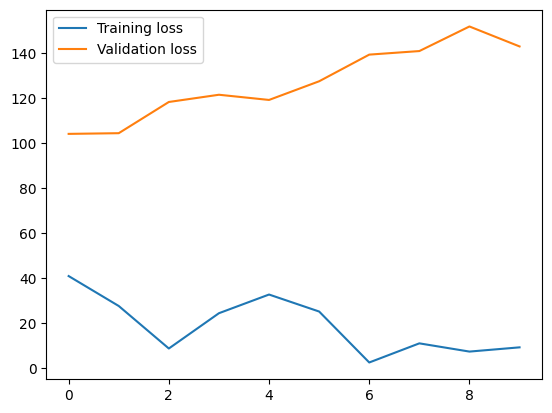

Test Loss: 137.20719650266457


NameError: name 'sklearn' is not defined

In [ ]:
train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(df, input_size = 69, num_epochs=10, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=32, device=device, random_seed=42, window_size_minutes=5, iftest=1, ifoutputpredictions=0)

## Try to include metadata from the subjects ##

In [338]:
mydata

,Label,Sbj_ID,Age,Gender,wkdaysleepdur5t,wkendsleepdur5t,nap5,trbleslpng5,slpngpills5,sleepy5,...,SP_Summaries_welch_rect_centroid,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information
0,30.0,2,83,0,8.0,8.0,1.0,2.0,2.0,1.0,...,0.138058,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,NaN
1,29.9,2,83,0,8.0,8.0,1.0,2.0,2.0,1.0,...,0.273049,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281
2,29.8,2,83,0,8.0,8.0,1.0,2.0,2.0,1.0,...,0.104311,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,NaN
3,29.7,2,83,0,8.0,8.0,1.0,2.0,2.0,1.0,...,0.122718,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,NaN
4,29.6,2,83,0,8.0,8.0,1.0,2.0,2.0,1.0,...,0.050621,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,7.5,7.0,1.0,1.0,1.0,1.0,...,0.001534,0.132739,0.187623,0.148162,0.900491,0.0,0.0,0.500000,0.0,NaN
175296,0.4,6811,79,1,7.5,7.0,1.0,1.0,1.0,1.0,...,0.035282,0.412933,0.448138,0.423812,1.977827,0.0,0.0,0.000000,0.0,-0.000735
175297,0.3,6811,79,1,7.5,7.0,1.0,1.0,1.0,1.0,...,0.010738,0.175018,0.184974,0.168836,0.948615,0.0,0.0,0.500000,0.0,NaN
175298,0.2,6811,79,1,7.5,7.0,1.0,1.0,1.0,1.0,...,0.007670,0.163801,0.226120,0.182618,0.892886,0.0,0.0,1.000000,0.0,NaN


## Try to get a lower-dimensional represenation with Autoencoders ##

In [248]:
# Create a function for creating sliding windows of selected length 

def create_sliding_windows_VAE(data, window_size_minutes= 30, random_seed = 42):

    # Assert whether therea are any NaNs in the data
    assert data.isnull().sum().sum() == 0, "There are NaNs in the data"

    # Create a list of all unique subjects
    subjects = data['Sbj_ID'].unique()


    # Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set
    np.random.seed(random_seed)
    train_subjects = np.random.choice(subjects, size=int(0.6*len(subjects)), replace=False)
    val_subjects = np.random.choice(np.setdiff1d(subjects, train_subjects), size=int(0.2*len(subjects)), replace=False)
    test_subjects = np.setdiff1d(subjects, np.concatenate((train_subjects, val_subjects)))
   
    
    # Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
    data['Set'] = 'train'
    data.loc[data['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
    data.loc[data['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'

    # Sort your dataframe by Sbj_ID if not already sorted
    data = data.sort_values('Sbj_ID')


    # Convert the window size from minutes to 6-second epochs
    window_size = int((window_size_minutes*60)/6)

    # Create empty lists to store your sequences and labels
    train_sequences = []
    train_labels = []
    val_sequences = []
    val_labels = []
    test_sequences = []
    test_labels = []

    # Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
    for sbj_id, group in data.groupby('Sbj_ID'):

        #Sort the group by the label column (so it's descending)
        group = group.sort_values('Label', ascending=False)

        # For each group, get the feature columns and convert them into numpy array
        group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

        train_test = group['Set'].iloc[0]
        
        if window_size == len(group_features):
            if train_test == 'train':
                train_sequences.append(group_features)
                train_labels.append(sbj_id)
            elif train_test == 'val':
                val_sequences.append(group_features)
                val_labels.append(sbj_id)
            elif train_test == 'test':
                test_sequences.append(group_features)
                test_labels.append(sbj_id)
        elif window_size > len(group_features):
            continue
        else:

            if train_test == 'train':

                # extract from the end of the sequneces the window size of data
                train_sequences.append(group_features[-window_size:])
               
                # Append the label corresponding to the end of the window
                train_labels.append(sbj_id)

            
            elif train_test == 'val':
                # Append the window data to your sequences
                val_sequences.append(group_features[-window_size:])

                # Append the label corresponding to the end of the window
                val_labels.append(sbj_id)

            elif train_test == 'test':
                # Append the window data to your sequences
                test_sequences.append(group_features[-window_size:])

                # Append the label corresponding to the end of the window
                test_labels.append(sbj_id)
            
    # Convert the sequences and labels into numpy arrays
    train_sequences = np.array(train_sequences)
    train_labels = np.array(train_labels)
    val_sequences = np.array(val_sequences)
    val_labels = np.array(val_labels)
    test_sequences = np.array(test_sequences)
    test_labels = np.array(test_labels)

    return train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels

In [11]:
df_for_encoding = mydata.copy()

In [12]:
df_for_encoding.fillna(method='ffill', inplace=True)

In [13]:
df_for_encoding.fillna(method = 'bfill', inplace = True)

In [14]:
df_for_encoding.isnull().sum()

Label                       0
Sbj_ID                      0
Age                         0
ifCleanOnset                0
SleepStage                  0
                           ..
Biphasic_vertices_count,    0
Sleep_spindles_count,       0
K_complex_count,            0
O-information               0
S-information               0
Length: 72, dtype: int64

In [16]:
df_for_encoding.columns

Index(['Label', 'Sbj_ID', 'Age', 'ifCleanOnset', 'SleepStage', 'delta_power',
       'theta_power', 'alpha_power', 'beta_power', 'gamma_power',
       'Delta_to_theta_ratio', 'Delta_to_alpha_ratio', 'Delta_to_beta_ratio',
       'Delta_to_gamma_ratio', 'Theta_to_alpha_ratio', 'Theta_to_beta_ratio',
       'Theta_to_gamma_ratio', 'Alpha_to_beta_ratio', 'Alpha_to_gamma_ratio',
       'Beta_to_gamma_ratio', 'Transition_power_ratio',
       'Peak_delta_band_frequency', 'Peak_theta_band_frequency',
       'Peak_alpha_band_frequency', 'Peak_beta_band_frequency',
       'Peak_gamma_band_frequency', 'Temporal_coherence_delta_band',
       'Temporal_coherence_theta_band', 'Temporal_coherence_alpha_band',
       'Temporal_coherence_beta_band', 'Temporal_coherence_gamma_band',
       'Phase_amplitude_coupling_DT', 'Phase_amplitude_coupling_DA',
       'Phase_amplitude_coupling_DB', 'Phase_amplitude_coupling_DG',
       'Phase_amplitude_coupling_TA', 'Phase_amplitude_coupling_TB',
       'Phase_am

In [17]:
missing_mask = mydata.isnull().sum(axis=1).astype(bool).astype(int)
df_for_encoding['missing'] = missing_mask

In [19]:
# show how many missing values are there in each row
df_for_encoding['missing'].value_counts()

missing
1    137816
0     37484
Name: count, dtype: int64

In [73]:
# delete 'count', 'datetime' columns 
df_for_encoding.drop(['count', 'datetime'], axis=1, inplace=True)

In [48]:
# Create the dataset from the dataframe
train_sequences_vae, train_labels_vae, val_sequences_vae, val_labels_vae, test_sequences_vae, test_labels_vae = create_sliding_windows_VAE(df_for_encoding, window_size_minutes=30, random_seed=42)


In [49]:
train_sequences_vae.shape

(288, 300, 69)

In [177]:
from sklearn.preprocessing import MinMaxScaler

# Initialize the scaler
scaler = MinMaxScaler(feature_range=(0, 1))

# Fit the scaler to the training data
# We're assuming here that your training data is a 3D array with shape 
# (number_of_sequences, sequence_length, number_of_features)
# and that you want to scale the data across all sequences and time steps, but not across features.
scaler.fit(train_sequences_vae.reshape(-1, train_sequences_vae.shape[-1]))

# Use the scaler to transform the train, validation, and test data
train_sequences_scaled_vae = scaler.transform(train_sequences_vae.reshape(-1, train_sequences_vae.shape[-1])).reshape(train_sequences_vae.shape)
val_sequences_scaled_vae = scaler.transform(val_sequences_vae.reshape(-1, val_sequences_vae.shape[-1])).reshape(val_sequences_vae.shape)
test_sequences_scaled_vae = scaler.transform(test_sequences_vae.reshape(-1, test_sequences_vae.shape[-1])).reshape(test_sequences_vae.shape)

In [166]:
from sklearn.preprocessing import StandardScaler

# Initialize the scaler
scaler = StandardScaler()

# Initialize the arrays to hold the scaled sequences
train_sequences_scaled_vae = []
val_sequences_scaled_vae = []
test_sequences_scaled_vae = []

# Scale each sequence individually, excluding the first feature
for seq in train_sequences_vae:
    scaler.fit(seq[:, 0:])
    train_sequences_scaled_vae.append(np.concatenate([seq[:, :0], scaler.transform(seq[:, 0:])], axis=-1))

for seq in val_sequences_vae:
    scaler.fit(seq[:, 0:])
    val_sequences_scaled_vae.append(np.concatenate([seq[:, :0], scaler.transform(seq[:, 0:])], axis=-1))

for seq in test_sequences_vae:
    scaler.fit(seq[:, 0:])
    test_sequences_scaled_vae.append(np.concatenate([seq[:, :0], scaler.transform(seq[:, 0:])], axis=-1))

# Convert the lists to arrays
train_sequences_scaled_vae = np.array(train_sequences_scaled_vae)
val_sequences_scaled_vae = np.array(val_sequences_scaled_vae)
test_sequences_scaled_vae = np.array(test_sequences_scaled_vae)

In [174]:
# Check sequence for one subject and one feature
train_sequences_scaled_vae[1][:, 67]

array([0.09708568, 0.09708568, 0.09708568, 0.09708568, 0.09708568,
       0.09708568, 0.05363683, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.09708568, 0.05363683, 0.05363683, 0.09708568,
       0.11714366, 0.01331702, 0.10508031, 0.06877085, 0.06877085,
       0.05363683, 0.06877085, 0.06877085, 0.02844317, 0.02602974,
       0.10508031, 0.01331702, 0.01331702, 0.2493718 , 0.2493718 ,
       0.10508031, 0.10508031, 0.10508031, 0.10508031, 0.01331702,
       0.05363683, 0.05363683, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.05363683, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.05363683, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.06877085, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.05363683, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.05363683, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.05363683, 0.05363683, 0.05363683, 0.05363683,
       0.05363683, 0.05363683, 0.05363683, 0.06877085, 0.04985

In [178]:
# Check that the min and max values are 0 and 1 in the training, validation and test sets
print(train_sequences_scaled_vae.min(), train_sequences_scaled_vae.max())
print(val_sequences_scaled_vae.min(), val_sequences_scaled_vae.max())
print(test_sequences_scaled_vae.min(), test_sequences_scaled_vae.max())


0.0 1.0000000000000002
-0.05025510082473683 1.194050217168483
-0.11716520005792676 1.1272772482714444


In [100]:
# Find where the maximum value is in the training set
train_sequences_scaled_vae.max(axis=0).argmax()

4

In [93]:
# show the maximum value in the training set
train_sequences_scaled_vae.max(axis=0).max()

93.0

In [69]:
# show train labels
train_labels_vae

array([   2,   10,   12,   54,   56,   77,  105,  107,  110,  125,  188,
        219,  220,  285,  288,  323,  329,  344,  363,  381,  382,  392,
        419,  459,  485,  490,  491,  499,  518,  526,  528,  534,  586,
        596,  626,  651,  680,  688,  694,  725,  762,  782,  800,  812,
        821,  823,  854,  892,  893,  914,  916,  977, 1021, 1077, 1087,
       1098, 1109, 1162, 1173, 1260, 1328, 1334, 1349, 1395, 1404, 1472,
       1476, 1501, 1515, 1531, 1542, 1591, 1607, 1656, 1672, 1684, 1703,
       1704, 1735, 1744, 1756, 1760, 1766, 1833, 1847, 1876, 1890, 1914,
       1951, 1995, 2040, 2104, 2126, 2167, 2175, 2204, 2216, 2239, 2251,
       2363, 2368, 2375, 2400, 2443, 2452, 2468, 2567, 2572, 2574, 2582,
       2603, 2659, 2676, 2696, 2723, 2750, 2796, 2798, 2807, 2836, 2881,
       2887, 2897, 2958, 2970, 2977, 2995, 3021, 3024, 3032, 3068, 3086,
       3106, 3140, 3158, 3190, 3211, 3212, 3223, 3257, 3311, 3375, 3389,
       3399, 3452, 3492, 3537, 3541, 3542, 3555, 35

In [70]:
# show the sizes of the datasets
print('Train sequences shape:', train_sequences_vae.shape)
print('Train labels shape:', train_labels_vae.shape)
print('Validation sequences shape:', val_sequences_vae.shape)
print('Validation labels shape:', val_labels_vae.shape)
print('Test sequences shape:', test_sequences_vae.shape)
print('Test labels shape:', test_labels_vae.shape)


Train sequences shape: (288, 300, 69)
Train labels shape: (288,)
Validation sequences shape: (101, 300, 69)
Validation labels shape: (101,)
Test sequences shape: (103, 300, 69)
Test labels shape: (103,)


In [71]:
# Check the datatypes of the sequences and labels numpy arrays
print('Train sequences datatype:', train_sequences_vae.dtype)


Train sequences datatype: float64


In [180]:
from torch.utils.data import TensorDataset, DataLoader



# Create the training, validation and test sets
#train_dataset_vae = TensorDataset(torch.from_numpy(np.vstack(train_sequences_vae)).float(), torch.from_numpy(train_labels_vae).float())
##val_dataset_vae = TensorDataset(torch.from_numpy(val_sequences_vae).float(), torch.from_numpy(val_labels_vae).float())
#test_dataset_vae = TensorDataset(torch.from_numpy(test_sequences_vae).float(), torch.from_numpy(test_labels_vae).float())

train_dataset_vae = SleepDataset(train_sequences_scaled_vae, train_labels_vae)
val_dataset_vae = SleepDataset(val_sequences_scaled_vae, val_labels_vae)
test_dataset_vae = SleepDataset(test_sequences_scaled_vae, test_labels_vae)


# Create the training, validation and test loaders
train_loader_vae = DataLoader(train_dataset_vae, batch_size=32, shuffle=True)
val_loader_vae = DataLoader(val_dataset_vae, batch_size=32, shuffle=False)
test_loader_vae = DataLoader(test_dataset_vae, batch_size=1, shuffle=False)




In [150]:
class VAE(nn.Module):
    def __init__(self, feature_dim, hidden_dim, latent_dim):
        super(VAE, self).__init__()

        # Encoder
        self.feature_dim = feature_dim
        self.fc1 = nn.Linear(feature_dim, hidden_dim)
        self.bn1 = nn.BatchNorm1d(hidden_dim)  # Batch Normalization layer
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.bn2 = nn.BatchNorm1d(hidden_dim)  # Batch Normalization layer
        self.fc3_mean = nn.Linear(hidden_dim, latent_dim)
        self.fc3_logvar = nn.Linear(hidden_dim, latent_dim)
        
        # Decoder
        self.fc4 = nn.Linear(latent_dim, hidden_dim)
        self.bn3 = nn.BatchNorm1d(hidden_dim)  # Batch Normalization layer
        self.fc5 = nn.Linear(hidden_dim, hidden_dim)
        self.bn4 = nn.BatchNorm1d(hidden_dim)  # Batch Normalization layer
        self.fc6 = nn.Linear(hidden_dim, feature_dim)

    def encode(self, x):
        h1 = F.relu(self.bn1(self.fc1(x)))
        h2 = F.relu(self.bn2(self.fc2(h1)))
        return self.fc3_mean(h2), self.fc3_logvar(h2)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        h3 = F.relu(self.bn3(self.fc4(z)))
        h4 = F.relu(self.bn4(self.fc5(h3)))
        return torch.sigmoid(self.fc6(h4))

    def forward(self, x):
        mu, logvar = self.encode(x.view(-1, self.feature_dim))
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

In [156]:
class VAE(nn.Module):
    def __init__(self, feature_dim, hidden_dim, latent_dim):
        super(VAE, self).__init__()

        self.fc1 = nn.Linear(feature_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3_mean = nn.Linear(hidden_dim, latent_dim)
        self.fc3_logvar = nn.Linear(hidden_dim, latent_dim)

        self.fc4 = nn.Linear(latent_dim, hidden_dim)
        self.fc5 = nn.Linear(hidden_dim, hidden_dim)
        self.fc6 = nn.Linear(hidden_dim, feature_dim)

        self.bn1 = nn.BatchNorm1d(hidden_dim)
        self.bn2 = nn.BatchNorm1d(hidden_dim)
        self.bn3 = nn.BatchNorm1d(feature_dim)

    def encode(self, x):
        h1 = F.relu(self.bn1(self.fc1(x)))
        h2 = F.relu(self.bn2(self.fc2(h1)))
        return self.fc3_mean(h2), self.fc3_logvar(h2)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        h4 = F.relu(self.bn1(self.fc4(z)))
        h5 = F.relu(self.bn2(self.fc5(h4)))
        return torch.sigmoid(self.bn3(self.fc6(h5)))  # use sigmoid to ensure output is in [0, 1]

    def forward(self, x):
        mu, logvar = self.encode(x.view(-1, x.shape[2]))
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

In [157]:
def vae_loss(recon_x, x, mu, logvar):
    BCE = F.binary_cross_entropy(recon_x, x.view(-1, x.shape[2]), reduction='sum')
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return BCE + KLD, BCE, KLD

In [194]:
# Define the dimensions
feature_dim = 69  # as you have 68 features
hidden_dim = 200  # you can choose this
latent_dim = 20  # this will be the size of your lower-dimensional representation
epochs = 30

# Initialize the model and the optimizer
model = VAE(feature_dim, hidden_dim, latent_dim)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

model.train()
bce_array = []
kld_array = []
for epoch in range(epochs):
    train_loss = 0
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
        print(data.shape)
        optimizer.zero_grad()
        recon_batch, mu, logvar = model(data)
        loss, bce, kld = vae_loss(recon_batch, data, mu, logvar)
        print(loss)
        loss.backward()
        
    
        train_loss += loss.item()
        optimizer.step()
    
    bce_array.append(bce.detach().numpy())
    kld_array.append(kld.detach().numpy())

    print(f"Epoch {epoch}, Loss: {train_loss / len(train_loader_vae.dataset)}")

# Plot the loss
plt.plot(bce_array, label='BCE')
plt.plot(kld_array, label='KLD')
plt.legend()
plt.show()


torch.Size([32, 300, 69])
tensor(531777.2500, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(483247.2188, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(478914.2812, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(482522.5312, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(462984.4688, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(451200.5312, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(460861.6875, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(445021.9688, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(426663.4688, grad_fn=<AddBackward0>)
Epoch 0, Loss: 14663.865993923611
torch.Size([32, 300, 69])
tensor(426345.7500, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(419791.2812, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(419731.3438, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(407995.4062, grad_fn=<AddBackward0>)
torch.Size([32, 300, 69])
tensor(399378.0312, grad_fn=<A

: 

: 

In [176]:
# get the latent representation of the test data
model.eval()
with torch.no_grad():
    for batch_idx, (data, labels) in enumerate(test_loader_vae):
        print(data.shape)
        recon_batch, mu, logvar = model(data)
        latent_rep = mu.detach().numpy()

print(latent_rep.shape)


torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])
torch.Size([1, 300, 69])


In [27]:
class VAERNN(nn.Module):
    def __init__(self, input_size, hidden_size, latent_size):
        super(VAERNN, self).__init__()

        # LSTM layer for encoding
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)

        # Latent space layers
        self.fc_mean = nn.Linear(hidden_size, latent_size)
        self.fc_logvar = nn.Linear(hidden_size, latent_size)

        # Decoding layers
        self.fc_decode = nn.Linear(latent_size, hidden_size)
        self.lstm_decode = nn.LSTM(hidden_size, input_size, batch_first=True)
        
    def encode(self, x):
        _, (h_n, _) = self.lstm(x)
        h_n = h_n.squeeze(0)
        return self.fc_mean(h_n), self.fc_logvar(h_n)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std

    def decode(self, z):
        h = self.fc_decode(z)
        h = h.unsqueeze(0)
        seq_len = 300  # change this to match your sequence length
        h = h.expand(seq_len, -1, -1).contiguous()
        out, _ = self.lstm_decode(h)
        # scale the sequence output to be between 0 and 1
        out = torch.sigmoid(out)
        return out

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

In [126]:

def vae_rnn_loss(recon_x, x, mu, logvar):
    # assert that x tensor is between 0 and 1
    assert torch.max(x) <= 1.0
    assert torch.min(x) >= 0.0
    BCE = F.binary_cross_entropy(recon_x, x, reduction='none')
    BCE = BCE.view(BCE.size(0), -1)
    BCE = BCE.mean(dim=1)
    BCE = BCE.sum()
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp(), dim=1)
    KLD = KLD.sum()
    return BCE + KLD, BCE, KLD



Epoch 0, Loss: 0.6998816861046685
Epoch 1, Loss: 0.6656006442175971
Epoch 2, Loss: 0.6476554340786405
Epoch 3, Loss: 0.6379946072896322
Epoch 4, Loss: 0.6348936557769775
Epoch 5, Loss: 0.632996552520328
Epoch 6, Loss: 0.6321036881870694
Epoch 7, Loss: 0.6316661834716797
Epoch 8, Loss: 0.6315054363674588
Epoch 9, Loss: 0.6312118238872952
Epoch 10, Loss: 0.6309842003716363
Epoch 11, Loss: 0.630917059050666
Epoch 12, Loss: 0.6307379868295457
Epoch 13, Loss: 0.6307236486011081
Epoch 14, Loss: 0.6307012769911025
Epoch 15, Loss: 0.630683614148034
Epoch 16, Loss: 0.6305788490507338
Epoch 17, Loss: 0.6305629478560554
Epoch 18, Loss: 0.6304973165194193
Epoch 19, Loss: 0.6304469241036309
Epoch 20, Loss: 0.6306663486692641
Epoch 21, Loss: 0.6304421159956191
Epoch 22, Loss: 0.6303283241060045
Epoch 23, Loss: 0.6305343508720398
Epoch 24, Loss: 0.630338536368476
Epoch 25, Loss: 0.6305065287484063
Epoch 26, Loss: 0.630373027589586
Epoch 27, Loss: 0.6303826570510864
Epoch 28, Loss: 0.6303095817565918


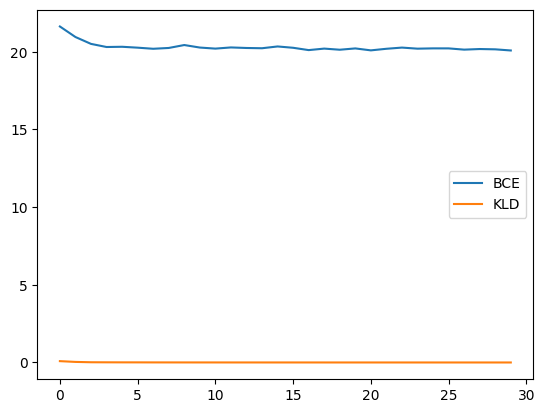

In [127]:
# Define the dimensions
feature_dim = 69  # as you have 68 features
hidden_dim = 512  # you can choose this
latent_dim = 30  # this will be the size of your lower-dimensional representation
epochs = 30

# Initialize the model and the optimizer
model = VAERNN(feature_dim, hidden_dim, latent_dim)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0012)

model.train()
bce_array = []
kld_array = []
for epoch in range(epochs):
    train_loss = 0
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
        
        optimizer.zero_grad()
        recon_batch, mu, logvar = model(data)
        recon_batch = recon_batch.permute(1, 0, 2)  # rearrange dimensions to match the input
        loss, bce, kld = vae_rnn_loss(recon_batch, data, mu, logvar)
        loss.backward()
        
        train_loss += loss.item()
        optimizer.step()
    
    bce_array.append(bce.detach().numpy())
    kld_array.append(kld.detach().numpy())

    print(f"Epoch {epoch}, Loss: {train_loss / len(train_loader_vae.dataset)}")

# Plot the loss
plt.plot(bce_array, label='BCE')
plt.plot(kld_array, label='KLD')
plt.legend()
plt.show()







(288, 30)


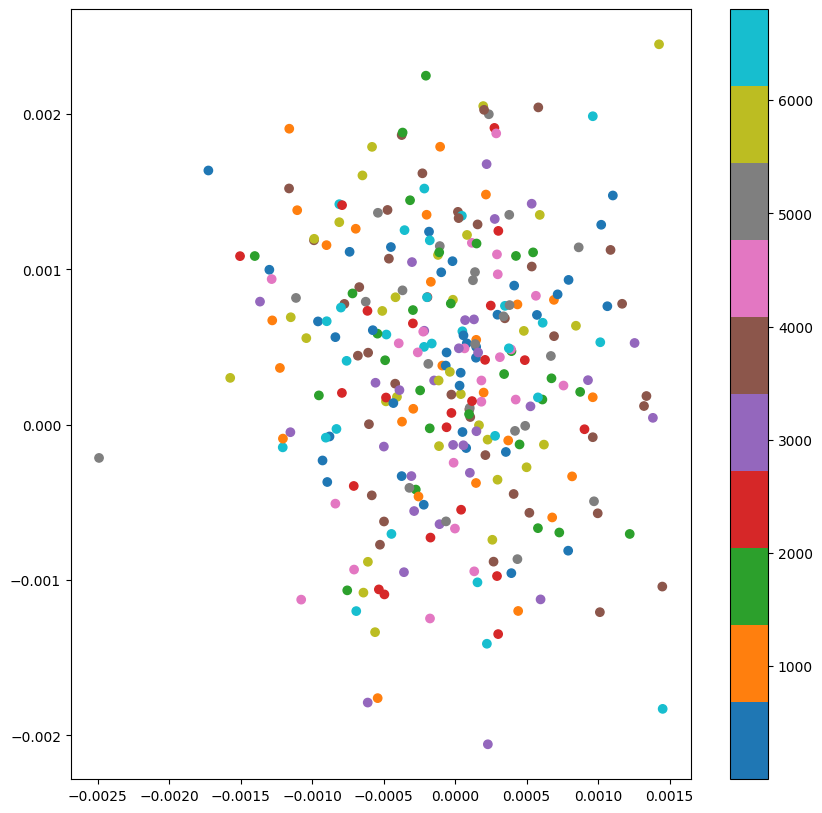

In [134]:
# Plot the latent representation  

# get the latent representation of the test data
latent = [] 
sbj_ids = []

model.eval()
with torch.no_grad():
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
        recon_batch, mu, logvar = model(data)
        latent_rep = mu.detach().numpy()
        latent.append(latent_rep)
        sbj_ids.append(labels.detach().numpy())

latent = np.concatenate(latent, axis=0)
print(latent.shape)

# plot the latent representation
plt.figure(figsize=(10, 10))
# each dot should have a annotation showing the subject id
plt.scatter(latent[:, 0], latent[:, 1], c=sbj_ids, cmap='tab10')
plt.colorbar()
plt.show()

sbj_ids = np.concatenate(sbj_ids, axis=0)




#

In [135]:
sbj_ids

array([6.940e+02, 4.116e+03, 1.173e+03, 3.801e+03, 3.920e+03, 2.368e+03,
       1.050e+02, 4.880e+03, 7.620e+02, 6.475e+03, 5.429e+03, 6.336e+03,
       5.450e+03, 1.876e+03, 6.132e+03, 1.334e+03, 5.414e+03, 3.024e+03,
       4.662e+03, 4.910e+02, 2.572e+03, 6.414e+03, 8.230e+02, 6.445e+03,
       6.416e+03, 2.251e+03, 1.395e+03, 1.672e+03, 5.463e+03, 3.630e+02,
       4.230e+03, 3.230e+02, 3.021e+03, 4.038e+03, 6.261e+03, 2.000e+00,
       2.836e+03, 3.717e+03, 1.951e+03, 3.311e+03, 1.607e+03, 2.216e+03,
       9.160e+02, 6.880e+02, 2.995e+03, 1.000e+01, 3.257e+03, 3.558e+03,
       1.328e+03, 3.541e+03, 5.295e+03, 2.190e+02, 1.995e+03, 4.345e+03,
       6.223e+03, 3.920e+02, 3.820e+02, 2.796e+03, 6.739e+03, 4.167e+03,
       1.162e+03, 4.760e+03, 1.250e+02, 3.223e+03, 4.622e+03, 4.731e+03,
       2.375e+03, 8.000e+02, 3.557e+03, 5.827e+03, 5.810e+03, 1.704e+03,
       3.736e+03, 5.789e+03, 4.016e+03, 3.542e+03, 1.703e+03, 2.040e+03,
       6.616e+03, 1.501e+03, 5.308e+03, 4.190e+02, 

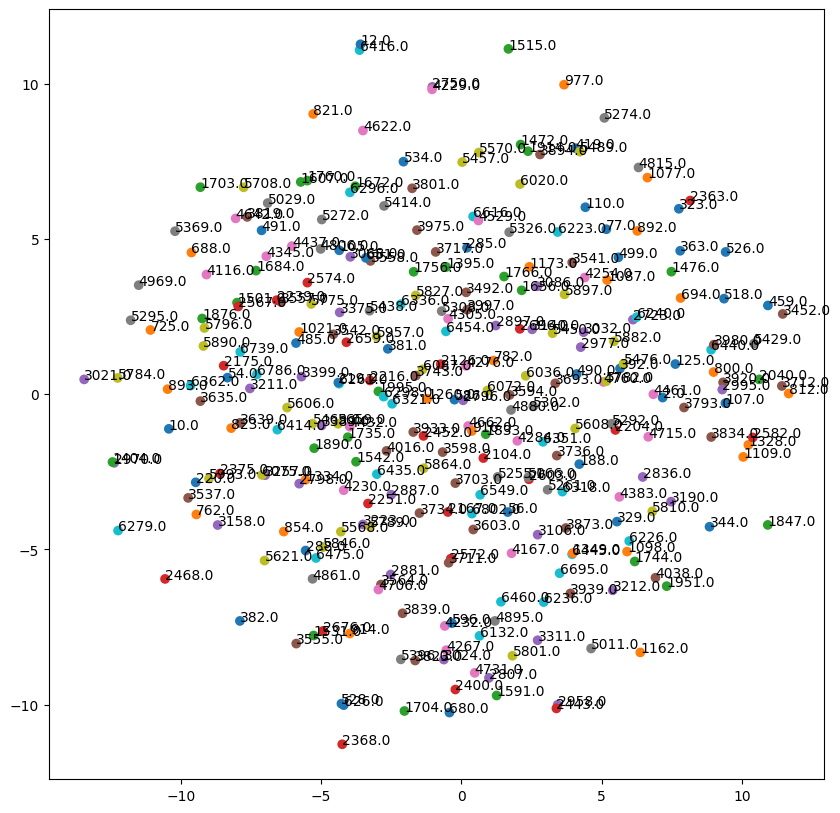

In [136]:
# plot latent representation using t-SNE
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=0)
latent_tsne = tsne.fit_transform(latent)
plt.figure(figsize=(10, 10))
# each dot should have a annotation showing the subject id (not colorcoded but labeled)
plt.scatter(latent_tsne[:, 0], latent_tsne[:, 1], c=sbj_ids, cmap='tab10')
for i, txt in enumerate(sbj_ids):
    plt.annotate(txt, (latent_tsne[i, 0], latent_tsne[i, 1]))



plt.show()


torch.Size([32, 300, 69])
(32, 300, 69)


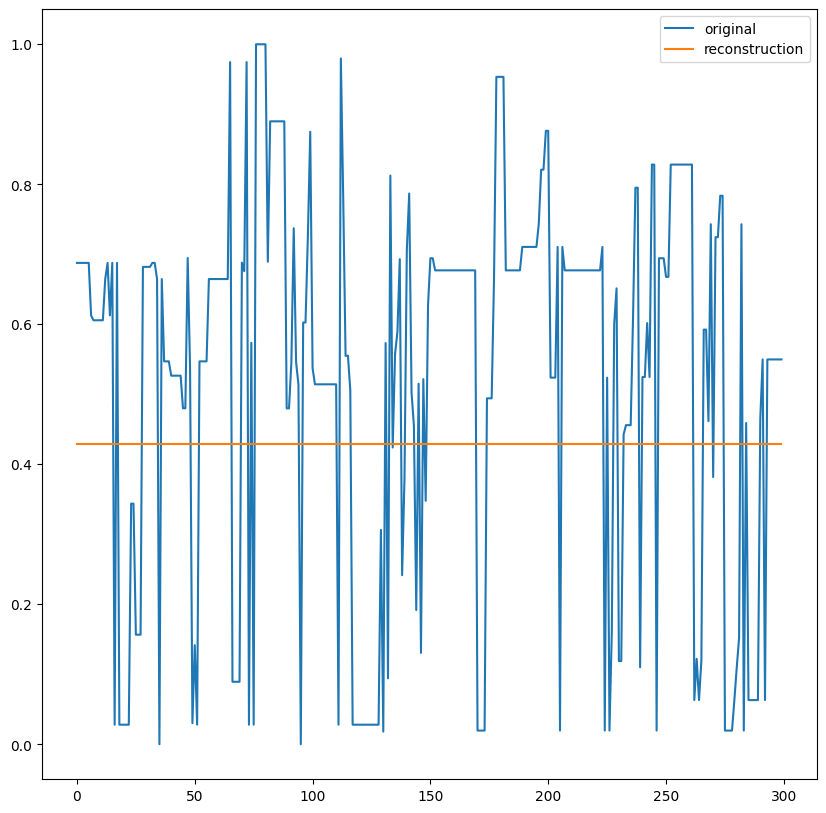

In [141]:
# Show the reconstruction of the test data
model.eval()
with torch.no_grad():
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
        print(data.shape)
        recon_batch, mu, logvar = model(data)
        recon_batch = recon_batch.permute(1, 0, 2)
        recon_batch = recon_batch.detach().numpy()
        print(recon_batch.shape)
        data = data.detach().numpy()
        break

# plot the reconstruction of the test data
plt.figure(figsize=(10, 10))
plt.plot(data[0, :, 8], label='original')
plt.plot(recon_batch[0, :, 8], label='reconstruction')
plt.legend()
plt.show()


In [227]:
import torch
import torch.nn as nn
from torch.nn import functional as F
from torch.autograd import Variable



class LSTM_VAE(nn.Module):
    def __init__(self, feature_dim, hidden_dim, num_layers, latent_dim):
        super(LSTM_VAE, self).__init__()

        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim
        self.relu = nn.LeakyReLU()

        # encoder: LSTM layer and a linear layer
        self.lstm1 = nn.LSTM(feature_dim, hidden_dim, num_layers=num_layers, batch_first=True)
        self.fc1 = nn.Linear(hidden_dim, latent_dim)
        self.fc2 = nn.Linear(hidden_dim, latent_dim)

        # decoder: linear layer and LSTM layer
        self.fc3 = nn.Linear(latent_dim, hidden_dim)
        self.lstm2 = nn.LSTM(hidden_dim, feature_dim, num_layers=num_layers, batch_first=True)

        # Xavier/Glorot initialization
        for name, param in self.named_parameters():
            if 'weight' in name:
                nn.init.xavier_normal_(param)
            elif 'bias' in name:
                nn.init.constant_(param, 0)

    def encode(self, x):
        _, (h_n, _) = self.lstm1(x)
        h_n = self.relu(h_n[-1])  # take the last hidden state
        return self.fc1(h_n), self.fc2(h_n)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std

    def decode(self, z):
        z = self.relu(self.fc3(z))
        z = z.unsqueeze(1).repeat(1, sequence_length, 1)  # repeat along sequence
        out, _ = self.lstm2(z)
        return out

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

# loss function
def loss_function(recon_x, x, mu, logvar):
    BCE = F.mse_loss(recon_x, x, reduction='sum')  # use mean squared error loss
    KLD = -0.8 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return BCE + KLD, BCE, KLD




Epoch 0, Loss: 2767.181735568576
Epoch 1, Loss: 1414.6589762369792
Epoch 2, Loss: 852.4386867947048
Epoch 3, Loss: 617.8257649739584
Epoch 4, Loss: 546.6126912434896
Epoch 5, Loss: 536.7694430881077
Epoch 6, Loss: 533.8857218424479
Epoch 7, Loss: 530.8825378417969
Epoch 8, Loss: 529.9444105360243
Epoch 9, Loss: 528.2590908474392
Epoch 10, Loss: 527.9901190863716
Epoch 11, Loss: 526.8779635959202
Epoch 12, Loss: 526.4262424045139
Epoch 13, Loss: 525.6024983723959
Epoch 14, Loss: 525.4534030490452
Epoch 15, Loss: 525.3397725423177
Epoch 16, Loss: 523.1475592719185
Epoch 17, Loss: 522.5235324435764
Epoch 18, Loss: 520.7525770399305
Epoch 19, Loss: 522.3200480143229


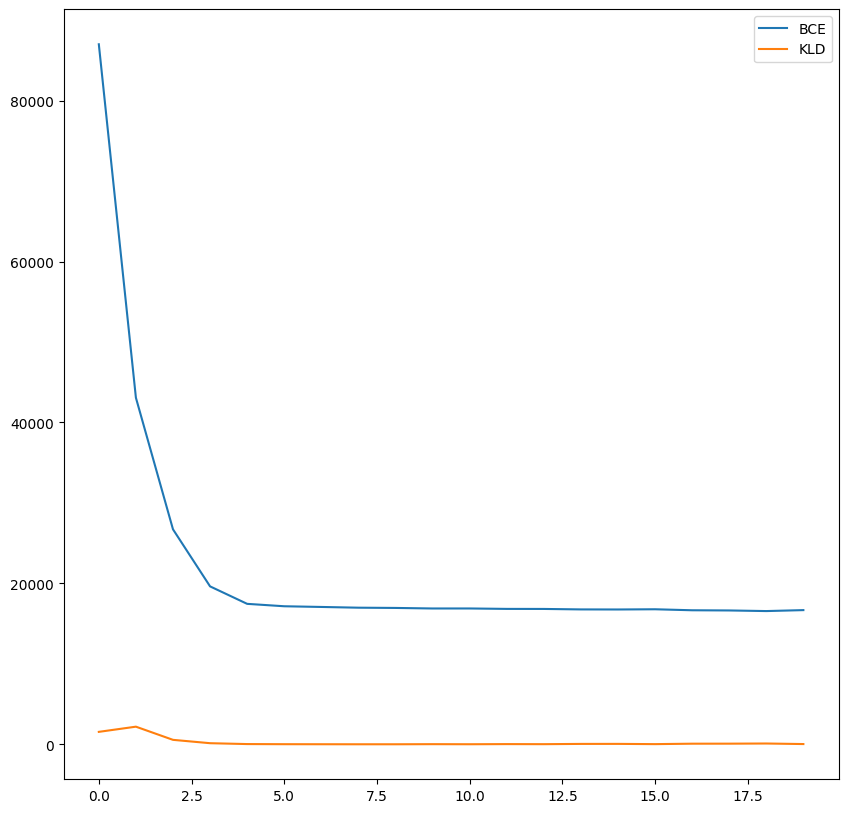

In [229]:
# Initialize the model and the optimizer



# dimensions
sequence_length = 300
feature_dim = 69  # as you have 68 features
hidden_dim = 600  # adjust this
latent_dim = 300  # this will be the size of your lower-dimensional representation
num_layers = 2

model = LSTM_VAE(hidden_dim=hidden_dim, latent_dim=latent_dim, feature_dim=feature_dim, num_layers=num_layers)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
model.train()

epochs = 20
bce_epochs = []
kld_epochs = []
for epoch in range(epochs):
    train_loss = 0
    bce_array = []
    kld_array = []
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
       #data = data.permute(1, 0, 2)  # rearrange dimensions to [sequence_length, batch_size, feature_dim]
        optimizer.zero_grad()
        recon_batch, mu, logvar = model(data)
        loss, bce, kld = loss_function(recon_batch, data, mu, logvar)
        loss.backward()
        train_loss += loss.item()
        # apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1)
        optimizer.step()
        bce_array.append(bce.detach().numpy())
        kld_array.append(kld.detach().numpy())
    bce_epochs.append(np.mean(bce_array))
    kld_epochs.append(np.mean(kld_array))
    print(f"Epoch {epoch}, Loss: {train_loss / len(train_loader_vae.dataset)}")

# plot the loss
plt.figure(figsize=(10, 10))
plt.plot(bce_epochs, label='BCE')
plt.plot(kld_epochs, label='KLD')
plt.legend()

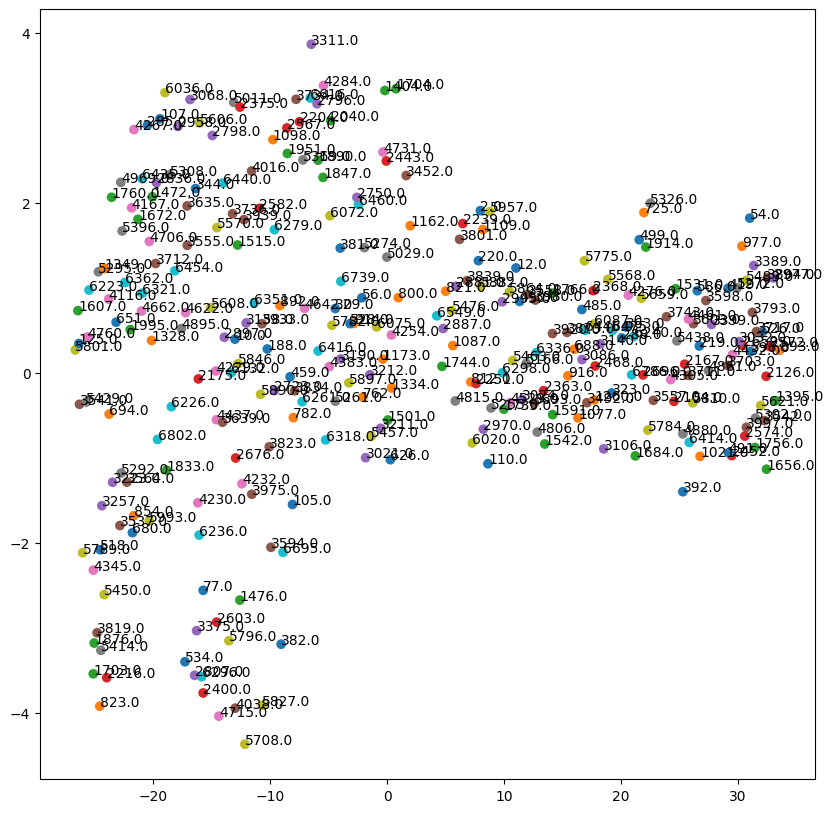

In [231]:
# plot the latent representation
latent = []
sbj_ids = []
model.eval()
with torch.no_grad():
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
        recon_batch, mu, logvar = model(data)
        mu = mu.detach().numpy()
        latent.append(mu)
        sbj_ids.append(labels.detach().numpy())
latent = np.concatenate(latent, axis=0)
sbj_ids = np.concatenate(sbj_ids, axis=0)

# plot latent representation using t-SNE
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=0)
latent_tsne = tsne.fit_transform(latent)
plt.figure(figsize=(10, 10))
# each dot should have a annotation showing the subject id (not colorcoded but labeled)
plt.scatter(latent_tsne[:, 0], latent_tsne[:, 1], c=sbj_ids, cmap='tab10')
for i, txt in enumerate(sbj_ids):
    plt.annotate(txt, (latent_tsne[i, 0], latent_tsne[i, 1]))

plt.show()


torch.Size([32, 300, 69])
(32, 300, 69)


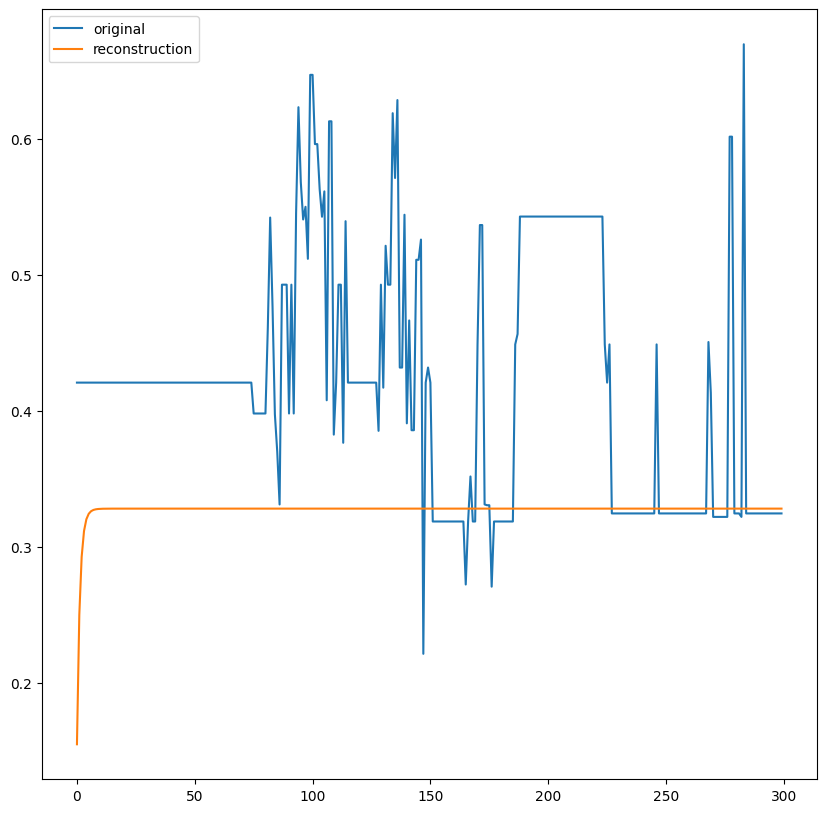

In [230]:
# Show the reconstruction of the test data
model.eval()
with torch.no_grad():
    
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
        print(data.shape)
        recon_batch, mu, logvar = model(data)
        
        recon_batch = recon_batch.detach().numpy()
        print(recon_batch.shape)
        data = data.detach().numpy()
        break

# plot the reconstruction of the test data
plt.figure(figsize=(10, 10))
plt.plot(data[1, :, 8], label='original')
plt.plot(recon_batch[1, :, 8], label='reconstruction')
plt.legend()
plt.show()


In [197]:
recon_batch.shape

(32, 300, 69)

## Try a separate LSTM for each feature ##

In [242]:
class multi_LSTM_VAE(nn.Module):
    def __init__(self, feature_dim, hidden_dim, latent_dim, num_layers):
        super(multi_LSTM_VAE, self).__init__()

        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim
        self.feature_dim = feature_dim

        # encoder: LSTM layer and a linear layer
        self.lstm1 = nn.ModuleList([nn.LSTM(1, hidden_dim, batch_first=True) for _ in range(feature_dim)])
        self.fc1 = nn.Linear(hidden_dim * feature_dim, latent_dim)
        self.fc2 = nn.Linear(hidden_dim * feature_dim, latent_dim)

        # decoder: linear layer and LSTM layer
        self.fc3 = nn.Linear(latent_dim, hidden_dim)
        self.lstm2 = nn.ModuleList([nn.LSTM(hidden_dim, 1, batch_first=True) for _ in range(feature_dim)])

    def encode(self, x):
        h_n = []
        for i in range(self.feature_dim):
            _, (h, _) = self.lstm1[i](x[:, :, i].unsqueeze(-1))
            h_n.append(h[-1])  # take the last hidden state
        h_n = torch.cat(h_n, dim=-1)
        return self.fc1(h_n), self.fc2(h_n)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std
    
    def decode(self, z):
        z = self.fc3(z)
        out = []
        for i in range(self.feature_dim):
            z_feature = z.unsqueeze(1).repeat(1, sequence_length, 1)  # repeat along sequence
            out_feature, _ = self.lstm2[i](z_feature)
            out.append(out_feature)
        out = torch.cat(out, dim=-1)
        return out

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

Epoch 0, Loss: 6252.193196614583
Epoch 1, Loss: 4871.315104166667
Epoch 2, Loss: 3645.0574001736113
Epoch 3, Loss: 3069.8619520399307
Epoch 4, Loss: 2904.357666015625
Epoch 5, Loss: 2639.036431206597
Epoch 6, Loss: 2293.0984700520835
Epoch 7, Loss: 2205.1698133680557
Epoch 8, Loss: 2154.2641872829863
Epoch 9, Loss: 2093.8193630642363
Epoch 10, Loss: 2051.0699462890625
Epoch 11, Loss: 2042.145751953125
Epoch 12, Loss: 2034.23193359375
Epoch 13, Loss: 2027.8959011501736
Epoch 14, Loss: 1991.7985161675347
Epoch 15, Loss: 1959.1863878038193
Epoch 16, Loss: 1949.064208984375
Epoch 17, Loss: 1927.2805311414932
Epoch 18, Loss: 1854.5318603515625
Epoch 19, Loss: 1795.6932508680557


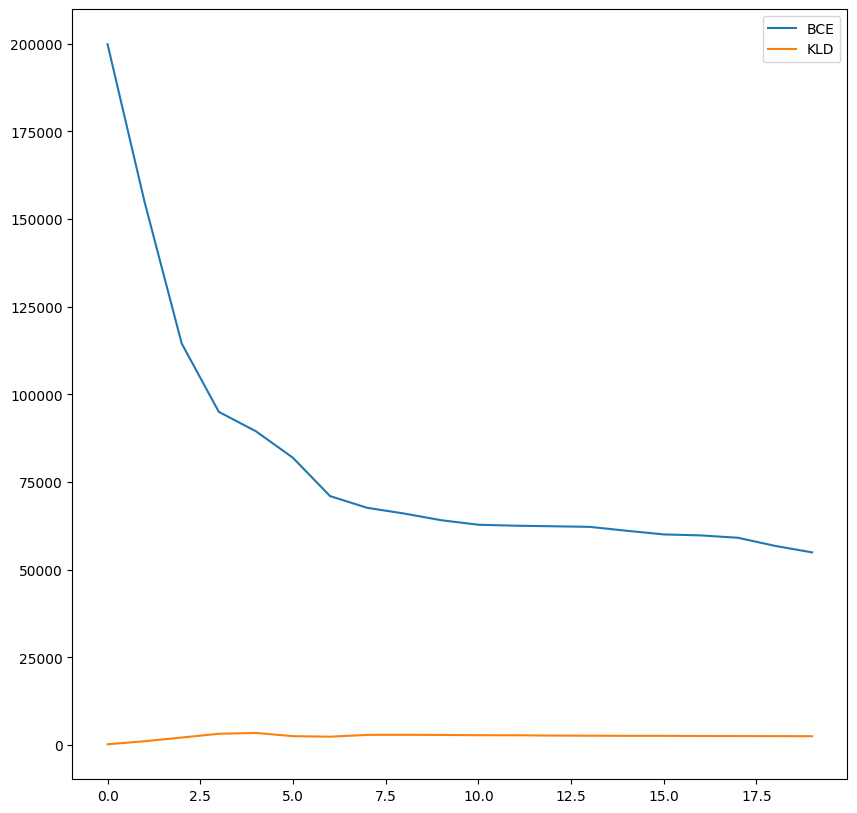

In [243]:
# dimensions
sequence_length = 300
feature_dim = 69  # as you have 68 features
hidden_dim = 128 # adjust this
latent_dim = 20  # this will be the size of your lower-dimensional representation
num_layers = 2

model = multi_LSTM_VAE(hidden_dim=hidden_dim, latent_dim=latent_dim, feature_dim=feature_dim, num_layers=num_layers)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
model.train()

epochs = 20
bce_epochs = []
kld_epochs = []
for epoch in range(epochs):
    train_loss = 0
    bce_array = []
    kld_array = []
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
       #data = data.permute(1, 0, 2)  # rearrange dimensions to [sequence_length, batch_size, feature_dim]
        optimizer.zero_grad()
        recon_batch, mu, logvar = model(data)
        loss, bce, kld = loss_function(recon_batch, data, mu, logvar)
        loss.backward()
        train_loss += loss.item()
        # apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1)
        optimizer.step()
        bce_array.append(bce.detach().numpy())
        kld_array.append(kld.detach().numpy())
    bce_epochs.append(np.mean(bce_array))
    kld_epochs.append(np.mean(kld_array))
    print(f"Epoch {epoch}, Loss: {train_loss / len(train_loader_vae.dataset)}")

# plot the loss
plt.figure(figsize=(10, 10))
plt.plot(bce_epochs, label='BCE')
plt.plot(kld_epochs, label='KLD')
plt.legend()
plt.show()


torch.Size([32, 300, 69])
(32, 300, 69)


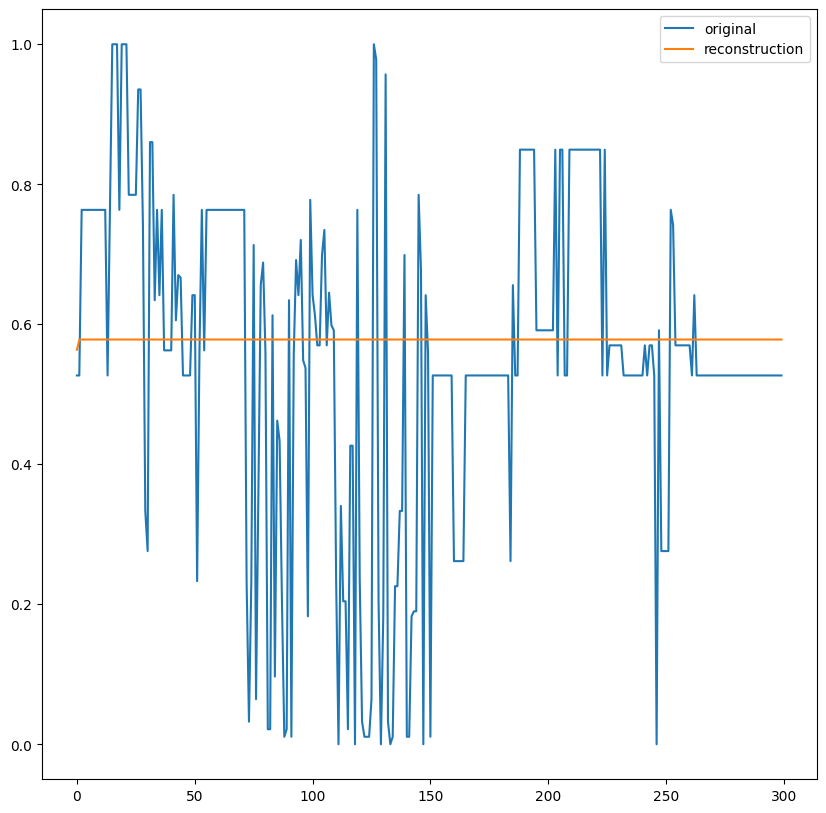

In [247]:
# Show the reconstruction of the test data
model.eval()
with torch.no_grad():
    
    for batch_idx, (data, labels) in enumerate(train_loader_vae):
        print(data.shape)
        recon_batch, mu, logvar = model(data)
        
        recon_batch = recon_batch.detach().numpy()
        print(recon_batch.shape)
        data = data.detach().numpy()
        break

# plot the reconstruction of the test data
plt.figure(figsize=(10, 10))
plt.plot(data[1, :, 19], label='original')
plt.plot(recon_batch[1, :, 19], label='reconstruction')
plt.legend()
plt.show()

# Experimentation with another loss function (CTC) #

In [186]:
# New loss function with CTC
def loss_function_ctc(recon_x, x, mu, logvar, input_lengths, target_lengths):
    BCE = F.mse_loss(recon_x, x, reduction='sum')  # use mean squared error loss
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    # Prepare target for CTC loss
    target = torch.flatten(x.long(), end_dim=-2)  # flattening all but last dimension

    # Add CTC loss
    CTC = F.ctc_loss(recon_x.log_softmax(2), target, input_lengths, target_lengths)

    return BCE + KLD + CTC, BCE, KLD, CTC

In [187]:
# Initialize the model and the optimizer
model = LSTM_VAE()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
model.train()

bce_epochs = []
kld_epochs = []
for epoch in range(epochs):
    train_loss = 0
    bce_array = []
    kld_array = []
    for batch_idx, data in enumerate(train_loader_vae):
        optimizer.zero_grad()
        recon_batch, mu, logvar = model(data)
        
        # Assume `inputs` is your input batch and `targets` are your target sequences
        input_lengths = torch.full(size=(data.shape[0],), fill_value=300, dtype=torch.long)
        target_lengths = torch.full(size=(data.shape[0],), fill_value=300, dtype=torch.long)  # replace `target_sequence_length` with actual lengths

        loss, bce, kld, ctc = loss_function_ctc(recon_batch, data, mu, logvar, input_lengths, target_lengths)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
        
        bce_array.append(bce.detach().numpy())
        kld_array.append(kld.detach().numpy())
        
    bce_epochs.append(np.mean(bce_array))
    kld_epochs.append(np.mean(kld_array))
    print(f"Epoch {epoch}, Loss: {train_loss / len(train_loader_vae.dataset)}")

# plot the loss
plt.figure(figsize=(10, 10))
plt.plot(bce_epochs, label='BCE')
plt.plot(kld_epochs, label='KLD')
plt.legend()

AttributeError: 'list' object has no attribute 'dim'

## Let's try only extracting 5 minutes prior to the sleep onset ##

In [256]:
# Create a function for creating sliding windows of selected length 

def create_sliding_windows_VAE(data, window_size_minutes= 30, random_seed = 42):

    # Assert whether therea are any NaNs in the data
    assert data.isnull().sum().sum() == 0, "There are NaNs in the data"

    # Create a list of all unique subjects
    subjects = data['Sbj_ID'].unique()


    # Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set
    np.random.seed(random_seed)
    train_subjects = np.random.choice(subjects, size=int(0.6*len(subjects)), replace=False)
    val_subjects = np.random.choice(np.setdiff1d(subjects, train_subjects), size=int(0.2*len(subjects)), replace=False)
    test_subjects = np.setdiff1d(subjects, np.concatenate((train_subjects, val_subjects)))
   
    
    # Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
    data['Set'] = 'train'
    data.loc[data['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
    data.loc[data['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'

    # Sort your dataframe by Sbj_ID if not already sorted
    data = data.sort_values('Sbj_ID')


    # Convert the window size from minutes to 6-second epochs
    window_size = int((window_size_minutes*60)/6)

    # Create empty lists to store your sequences and labels
    train_sequences = []
    train_labels = []
    val_sequences = []
    val_labels = []
    test_sequences = []
    test_labels = []

    # Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
    for sbj_id, group in data.groupby('Sbj_ID'):

        #Sort the group by the label column (so it's descending)
        group = group.sort_values('Label', ascending=False)

        # For each group, get the feature columns and convert them into numpy array
        group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

        train_test = group['Set'].iloc[0]
        
        if window_size == len(group_features):
            if train_test == 'train':
                train_sequences.append(group_features)
                train_labels.append(sbj_id)
            elif train_test == 'val':
                val_sequences.append(group_features)
                val_labels.append(sbj_id)
            elif train_test == 'test':
                test_sequences.append(group_features)
                test_labels.append(sbj_id)
        elif window_size > len(group_features):
            continue
        else:

            if train_test == 'train':

                # extract from the end of the sequneces the window size of data
                train_sequences.append(group_features[-window_size:])
               
            
                # Append the label corresponding to the end of the window
                train_labels.append(sbj_id)

            
            elif train_test == 'val':
                # Append the window data to your sequences
                val_sequences.append(group_features[-window_size:])

                # Append the label corresponding to the end of the window
                val_labels.append(sbj_id)

            elif train_test == 'test':
                # Append the window data to your sequences
                test_sequences.append(group_features[-window_size:])

                # Append the label corresponding to the end of the window
                test_labels.append(sbj_id)
            
    # Convert the sequences and labels into numpy arrays
    train_sequences = np.array(train_sequences)
    train_labels = np.array(train_labels)
    val_sequences = np.array(val_sequences)
    val_labels = np.array(val_labels)
    test_sequences = np.array(test_sequences)
    test_labels = np.array(test_labels)

    return train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels

In [257]:
# Create the dataset from the dataframe
train_sequences_vae_5, train_labels_vae_5, val_sequences_vae_5, val_labels_vae_5, test_sequences_vae_5, test_labels_vae_5 = create_sliding_windows_VAE(df_for_encoding, window_size_minutes=5, random_seed=42)


In [253]:
train_sequences_vae_5 = torch.from_numpy(train_sequences_vae_5).float()

In [258]:
from sklearn.preprocessing import MinMaxScaler

# Initialize the scaler
scaler = MinMaxScaler(feature_range=(0, 1))

# Fit the scaler to the training data
# We're assuming here that your training data is a 3D array with shape 
# (number_of_sequences, sequence_length, number_of_features)
# and that you want to scale the data across all sequences and time steps, but not across features.
scaler.fit(train_sequences_vae_5.reshape(-1, train_sequences_vae_5.shape[-1]))

# Transform the training data
train_sequences_vae_5_scaled = scaler.transform(train_sequences_vae_5.reshape(-1, train_sequences_vae_5.shape[-1])).reshape(train_sequences_vae_5.shape)
val_sequences_vae_5_scaled = scaler.transform(val_sequences_vae_5.reshape(-1, val_sequences_vae_5.shape[-1])).reshape(val_sequences_vae_5.shape)
test_sequences_vae_5_scaled = scaler.transform(test_sequences_vae_5.reshape(-1, test_sequences_vae_5.shape[-1])).reshape(test_sequences_vae_5.shape)



In [262]:
# Check that the min and max values are 0 and 1 in the training, validation and test sets
print(train_sequences_vae_5_scaled.min(), train_sequences_vae_5_scaled.max())
print(val_sequences_vae_5_scaled.min(), val_sequences_vae_5_scaled.max())
print(test_sequences_vae_5_scaled.min(), test_sequences_vae_5_scaled.max())

0.0 1.0000000000000002
-0.12564879211402707 1.1520955909506145
-0.2367084850360104 1.3191196698762018


In [263]:

# Print the shape of the training, validation and test sets
print(train_sequences_vae_5_scaled.shape)
print(val_sequences_vae_5_scaled.shape)
print(test_sequences_vae_5_scaled.shape)



(390, 50, 69)
(131, 50, 69)
(132, 50, 69)


In [264]:
# Check the datatypes of the sequences and labels numpy arrays
print('Train sequences datatype:', train_sequences_vae_5_scaled.dtype)

Train sequences datatype: float64


In [265]:
from torch.utils.data import TensorDataset, DataLoader

# Create the training, validation and test sets
#train_dataset_vae = TensorDataset(torch.from_numpy(np.vstack(train_sequences_vae)).float(), torch.from_numpy(train_labels_vae).float())
##val_dataset_vae = TensorDataset(torch.from_numpy(val_sequences_vae).float(), torch.from_numpy(val_labels_vae).float())
#test_dataset_vae = TensorDataset(torch.from_numpy(test_sequences_vae).float(), torch.from_numpy(test_labels_vae).float())

train_dataset_vae_5 = SleepDataset(train_sequences_vae_5_scaled, train_labels_vae_5)
val_dataset_vae_5 = SleepDataset(val_sequences_vae_5_scaled, val_labels_vae_5)
test_dataset_vae_5 = SleepDataset(test_sequences_vae_5_scaled, test_labels_vae_5)

# Create the training, validation and test dataloaders
train_dataloader_vae_5 = DataLoader(train_dataset_vae_5, batch_size=64, shuffle=True)
val_dataloader_vae_5 = DataLoader(val_dataset_vae_5, batch_size=64, shuffle=True)
test_dataloader_vae_5 = DataLoader(test_dataset_vae_5, batch_size=64, shuffle=True)



In [266]:
import torch
import torch.nn as nn
from torch.nn import functional as F
from torch.autograd import Variable



class LSTM_VAE(nn.Module):
    def __init__(self, feature_dim, hidden_dim, num_layers, latent_dim):
        super(LSTM_VAE, self).__init__()

        self.hidden_dim = hidden_dim
        self.latent_dim = latent_dim
        self.relu = nn.LeakyReLU()

        # encoder: LSTM layer and a linear layer
        self.lstm1 = nn.LSTM(feature_dim, hidden_dim, num_layers=num_layers, batch_first=True)
        self.fc1 = nn.Linear(hidden_dim, latent_dim)
        self.fc2 = nn.Linear(hidden_dim, latent_dim)

        # decoder: linear layer and LSTM layer
        self.fc3 = nn.Linear(latent_dim, hidden_dim)
        self.lstm2 = nn.LSTM(hidden_dim, feature_dim, num_layers=num_layers, batch_first=True)

        # Xavier/Glorot initialization
        for name, param in self.named_parameters():
            if 'weight' in name:
                nn.init.xavier_normal_(param)
            elif 'bias' in name:
                nn.init.constant_(param, 0)

    def encode(self, x):
        _, (h_n, _) = self.lstm1(x)
        h_n = self.relu(h_n[-1])  # take the last hidden state
        return self.fc1(h_n), self.fc2(h_n)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mu + eps*std

    def decode(self, z):
        z = self.relu(self.fc3(z))
        z = z.unsqueeze(1).repeat(1, sequence_length, 1)  # repeat along sequence
        out, _ = self.lstm2(z)
        return out

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

# loss function
def loss_function(recon_x, x, mu, logvar):
    BCE = F.mse_loss(recon_x, x, reduction='sum')  # use mean squared error loss
    KLD = -0.8 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return BCE + KLD, BCE, KLD

Epoch 0, Loss: 504.4125
Epoch 1, Loss: 272.6127184745593
Epoch 2, Loss: 155.53885231996193
Epoch 3, Loss: 121.38556831555489
Epoch 4, Loss: 112.42732450045072
Epoch 5, Loss: 108.08908394055489
Epoch 6, Loss: 105.37572209284856
Epoch 7, Loss: 103.60703719701523
Epoch 8, Loss: 102.42979501577524
Epoch 9, Loss: 100.95443662985777
Epoch 10, Loss: 99.06842400966546
Epoch 11, Loss: 97.75572822766426
Epoch 12, Loss: 98.14446270282451
Epoch 13, Loss: 95.85344739082532
Epoch 14, Loss: 94.94161032652244
Epoch 15, Loss: 94.6786619528746
Epoch 16, Loss: 94.30789403670873
Epoch 17, Loss: 93.88240998096956
Epoch 18, Loss: 95.28934263571715
Epoch 19, Loss: 94.17672275641026
Epoch 20, Loss: 94.23643298026843
Epoch 21, Loss: 93.18572747646233
Epoch 22, Loss: 93.01933781550481
Epoch 23, Loss: 93.83534858899239
Epoch 24, Loss: 92.76292662009214
Epoch 25, Loss: 92.86112467447917
Epoch 26, Loss: 93.10467435396635
Epoch 27, Loss: 92.84783825996594
Epoch 28, Loss: 92.25651558117988
Epoch 29, Loss: 92.4600615

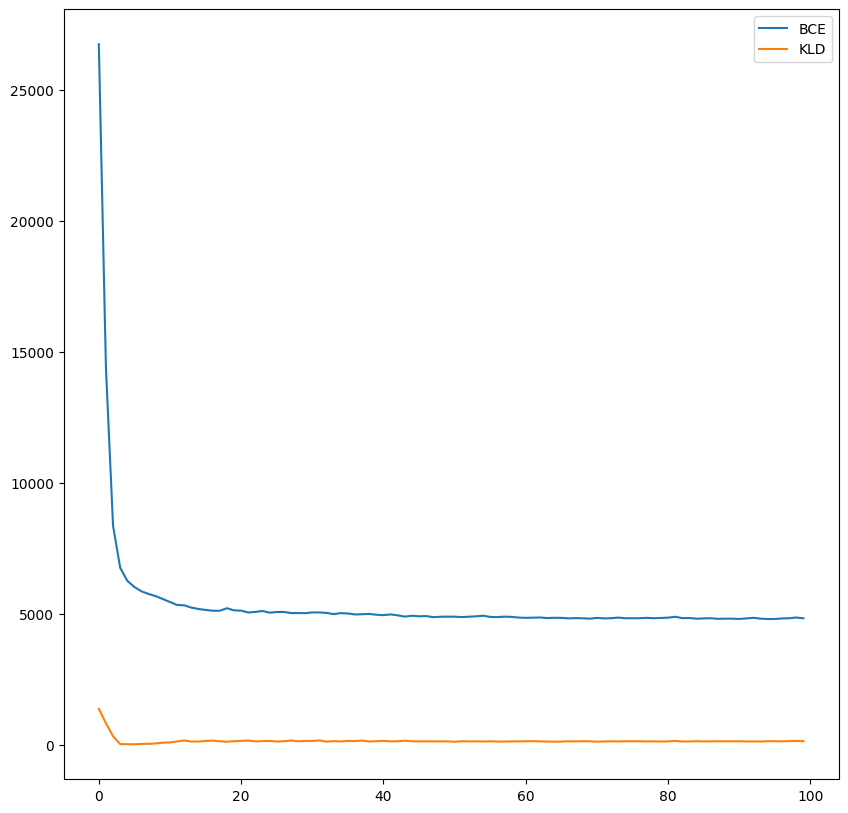

In [272]:
# Initialize the model and the optimizer


# dimensions
sequence_length = 50
feature_dim = 69  # as you have 68 features
hidden_dim = 1024  # adjust this
latent_dim = 50  # this will be the size of your lower-dimensional representation
num_layers = 2

model = LSTM_VAE(hidden_dim=hidden_dim, latent_dim=latent_dim, feature_dim=feature_dim, num_layers=num_layers)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
model.train()

epochs = 100
bce_epochs = []
kld_epochs = []
for epoch in range(epochs):
    train_loss = 0
    bce_array = []
    kld_array = []
    for batch_idx, (data, labels) in enumerate(train_dataloader_vae_5):
       #data = data.permute(1, 0, 2)  # rearrange dimensions to [sequence_length, batch_size, feature_dim]
        optimizer.zero_grad()
        recon_batch, mu, logvar = model(data)
        loss, bce, kld = loss_function(recon_batch, data, mu, logvar)
        loss.backward()
        train_loss += loss.item()
        # apply gradient clipping
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1)
        optimizer.step()
        bce_array.append(bce.detach().numpy())
        kld_array.append(kld.detach().numpy())
    bce_epochs.append(np.mean(bce_array))
    kld_epochs.append(np.mean(kld_array))
    print(f"Epoch {epoch}, Loss: {train_loss / len(train_dataloader_vae_5.dataset)}")

# plot the loss
plt.figure(figsize=(10, 10))
plt.plot(bce_epochs, label='BCE')
plt.plot(kld_epochs, label='KLD')
plt.legend()

torch.Size([64, 50, 69])
(64, 50, 69)


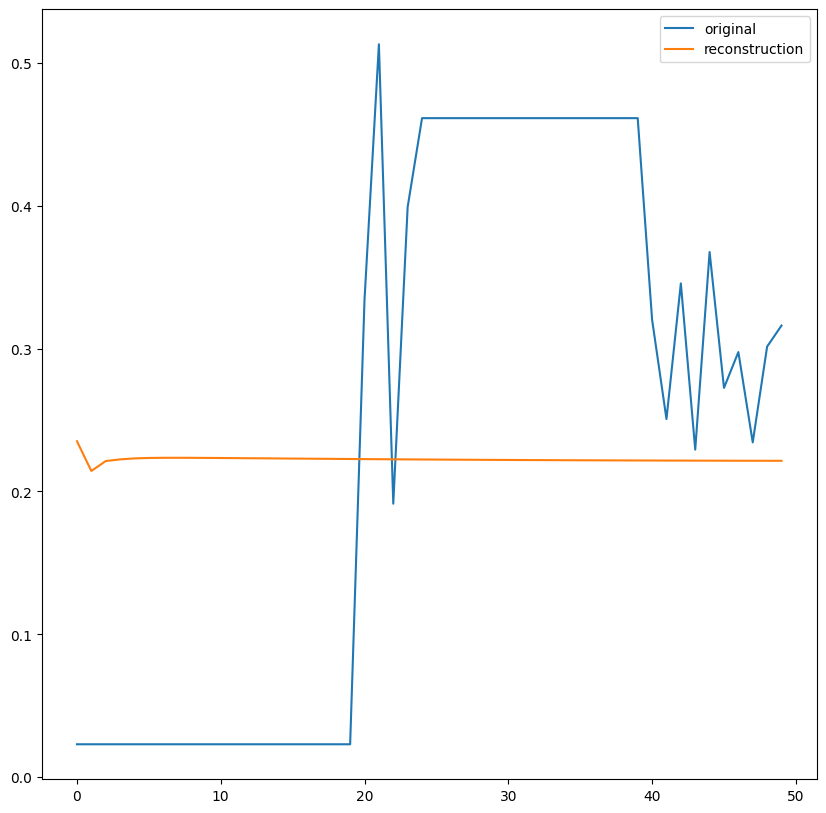

In [275]:
# Show the reconstruction of the test data
model.eval()
with torch.no_grad():
    
    for batch_idx, (data, labels) in enumerate(train_dataloader_vae_5):
        print(data.shape)
        recon_batch, mu, logvar = model(data)
        
        recon_batch = recon_batch.detach().numpy()
        print(recon_batch.shape)
        data = data.detach().numpy()
        break

# plot the reconstruction of the test data
plt.figure(figsize=(10, 10))
plt.plot(data[1, :, 31], label='original')
plt.plot(recon_batch[1, :, 31], label='reconstruction')
plt.legend()
plt.show()